<a href="https://colab.research.google.com/github/Gomez-Lab/WoundSizeEstimation/blob/main/Wound_Segmentation_Inference_and_Results_(external).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Segmentation Inference, post-processing and graphing

### Drive and setup specific code

In [ ]:
!nvidia-smi

Wed May 19 12:52:03 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/My\ Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse\ wounds/Wound\ Segmentation/Semantic-Shapes

/content/drive/.shortcut-targets-by-id/175Vkdh2mGaZ7CZsZetvNssl0puand1tS/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Semantic-Shapes


## Inference

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline 
import os
from shutil import copyfile
import pandas as pd
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
from models import preprocess_input, dice, iou_coef
import cv2
import numpy as np
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from PIL import Image
from tensorflow.keras.utils import to_categorical
from utils import add_masks#, crf
import random

import json

import skimage
from skimage import data, io, color, filters, measure, feature
from google.colab.patches import cv2_imshow
from matplotlib.patches import Circle

import importlib.util
spec = importlib.util.spec_from_file_location("skdemo", "./skdemo/_skdemo.py")
skdemo = importlib.util.module_from_spec(spec)
spec.loader.exec_module(skdemo)

Helper functions and classes

In [ ]:
def plot_charts(mouse, sides):

    for side in sides:
        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        th_low = 0.01
        th_high = 28.5

        upper = np.ma.masked_where(y < th_high, y)
        lower = np.ma.masked_where(y > th_low, y)

        fig, ax = plt.subplots()
        plt.title(mouse.id + ' ' + side)
        ax.plot(x, y)
        ax.plot(x, lower)
        if upper.any() > 0:
            ax.axhline(y=th_high, color='r', linestyle='dashed')
            plt.legend(('Expected', 'Healed / lost wound', 'Higher than expected'))
        else:
            plt.legend(('Expected', 'Healed / lost wound'))

        plt.xlabel('Day')
        plt.ylabel('Wound area in $mm^2$')
        plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + mouse.id + "-" + side + ".pdf")
        plt.show()

def plot_charts_together(mouse, sides):

    fig, ax = plt.subplots()
    plt.title(mouse.id + ' ' + 'L & R area')

    for side in sides:
        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        th_low = 0.01
        th_high = 28.5

        upper = np.ma.masked_where(y < th_high, y)
        lower = np.ma.masked_where(y > th_low, y)

        ax.plot(x, y)

    if upper.any() > 0:
        ax.axhline(y=th_high, color='r', linestyle='dashed')
        plt.legend(('Left', 'Right', 'Higher than expected'))
    else:
        plt.legend(('Left', 'Right'))
            
    plt.xlabel('Day')
    plt.ylabel('Wound area in $mm^2$')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + mouse.id + " " + "L & R area" + ".pdf")
    plt.show()


def plot_pair(images, gray=False):

    fig, axes = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(10,8))
    i=0

    for y in range(2):
        if gray:
            axes[y].imshow(images[i], cmap='gray')
        else:
            axes[y].imshow(images[i])
        axes[y].get_xaxis().set_visible(True)
        axes[y].get_yaxis().set_visible(True)

        i+=1

    plt.show()

def get_size(prediction):

    # Count the pixels "sufficiently" activated for red and green color ch
    # to account for noise we set a threshold of 20 to 40
    # green = ring, red = wound
    area_red_ch = (prediction[:,:,0] >= 20).sum()
    area_green_ch = (prediction[:,:,1] >= 40).sum()

    # If we found a ring this value will be higher than zero
    if area_green_ch > 20:

        # This is the ratio of wound to ring 
        # i.e. how big is the wound in relation to the ring
        ratio = area_red_ch / area_green_ch
        # We can then extract the wound area by assuming the ring has area ~ 78.54
        # i.e. the area of a circle with diameter 10 (A = pi * r^2)
        green_area = np.pi * (5**2)
        # For example,
        # If the wound is half the pixels of the ring then we'd get half the area
        wound_area = round((ratio * green_area), 3)
        # We can then make a rough estimate of the diameter given it's area and
        # assuming it's close to a perfect circle 
        # Formula: sqrt(A / pi) * 2
        wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

        # If for some reason the wound is bigger than the ring itself then
        # there must be a miss classification, return 0,0
        if wound_area > 150 or wound_diameter > 15:

            return 0, 0

        else:
            return wound_area, wound_diameter

    # If no ring has been found return zero for now
    # will revisit for some kind of estimation without ring
    else:
        return 0, 0

In [ ]:
class Wound:
    def __init__(self, day, ring_size, wound_size, area, diameter, image, prediction):
        self.day = day
        self.image = image
        self.prediction = prediction
        self.area = area
        self.diameter = diameter
        self.ring_size = ring_size
        self.wound_size = wound_size

class Mouse:
    def __init__(self, mouse_id):
        self.id = mouse_id
        self.left_wounds = []
        self.right_wounds = []
        self.left_percentages = []
        self.right_percentages = []

    def get_areas(self, side):
        areas = []
        if side == 'L':
            for wound in self.left_wounds:
                areas.append(wound.area)
            return areas
        elif side == 'R':
            for wound in self.right_wounds:
                areas.append(wound.area)
            return areas
        else:
            print("Specify side by 'L' or 'R'")

    def get_diameters(self, side):
        diameters = []
        if side == 'L':
            for wound in self.left_wounds:
                diameters.append(wound.diameter)
            return diameters
        elif side == 'R':
            for wound in self.right_wounds:
                diameters.append(wound.diameter)
            return diameters
        else:
            print("Specify side by 'L' or 'R'")

    def get_days(self, side):
        days = []
        if side == 'L':
            for wound in self.left_wounds:
                days.append(wound.day)
            return days
        elif side == 'R':
            for wound in self.right_wounds:
                days.append(wound.day)
            return days
        else:
            print("Specify side by 'L' or 'R'")

    def get_predictions(self, side):
        predictions = []
        if side == 'L':
            for wound in self.left_wounds:
                predictions.append(wound.prediction)
            return predictions
        elif side == 'R':
            for wound in self.right_wounds:
                predictions.append(wound.prediction)
            return predictions
        else:
            print("Specify side by 'L' or 'R'")

    def get_images(self, side):
        images = []
        if side == 'L':
            for wound in self.left_wounds:
                images.append(wound.image)
            return images
        elif side == 'R':
            for wound in self.right_wounds:
                images.append(wound.image)
            return images
        else:
            print("Specify side by 'L' or 'R'")

In [ ]:
def clean_size(prediction):

    g_size, g_mask, r_size, r_mask = clean_prediction(prediction)

    global g_total_size
    g_total_size += g_size
    global g_total
    g_total += 1
    global r_total_size
    r_total_size += r_size
    global r_total
    r_total += 1

    g_avg_size = g_total_size / g_total
    r_avg_size = r_total_size / r_total

    # Very low ring size means no ring detected but wound detected
    if g_size <= (dataset_g_avg / 2)  and r_size > 10:
        
        # when the green area is bad but the red area is good,
        # we can use the average green area
        ratio = r_size / dataset_g_avg
        green_area = np.pi * (5**2)
        wound_area = round((ratio * green_area), 3)
        wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

        #return g_size, r_size, wound_area, wound_diameter

        return dataset_g_avg, r_size, wound_area, wound_diameter # now returning avg


    # If we found a ring this value will be higher than zero
    elif g_size > 50:

        # This is the ratio of wound to ring 
        # i.e. how big is the wound in relation to the ring
        ratio = r_size / g_size
        # We can then extract the wound area by assuming the ring has area ~ 78.54
        # i.e. the area of a circle with diameter 10 (A = pi * r^2)
        green_area = np.pi * (5**2)
        # For example,
        # If the wound is half the pixels of the ring then we'd get half the area
        wound_area = round((ratio * green_area), 3)
        # We can then make a rough estimate of the diameter given it's area and
        # assuming it's close to a perfect circle 
        # Formula: sqrt(A / pi) * 2
        wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

        # If for some reason the wound is bigger than the ring itself then
        # there must be a miss classification, return 0,0
        if wound_area > 150 or wound_diameter > 15:

            return g_size, r_size, 0, 0

        else:
            return g_size, r_size, wound_area, wound_diameter

    # If no ring has been found return zero for now
    # will revisit for some kind of estimation without ring
    else:
        return g_size, r_size, 0, 0

In [ ]:
def negative(number):
    if number < 0:
        return number
def positive(number):
    if number > 0:
        return number

In [ ]:
def clean_prediction(prediction):

    red = prediction[...,0]
    green = prediction[...,1]

    green_threshold = 40
    red_threshold = 20

    thg, g_masks = cv2.threshold(green, green_threshold, 255, cv2.THRESH_BINARY)
    thr, r_masks = cv2.threshold(red, red_threshold, 255, cv2.THRESH_BINARY)

    g_size, g_mask = single_mask_size(g_masks)
    
    if g_size <= (dataset_g_avg / 2):
        r_size, r_mask = single_mask_size_wound(r_masks)
    else:
        r_size, r_mask = single_mask_size(r_masks)

    return g_size, g_mask, r_size, r_mask
    
def single_mask_size(masks):

    nb_components, output, stats, centroids = cv2.connectedComponentsWithStats(masks, connectivity=8)
    nb_components -= 1 # removes background component
    sizes = stats[1:, -1] # get sizes

    try:
        largest = max(sizes)
    except:
        largest = 0

    single_mask = np.zeros((output.shape))

    for i in range(0, nb_components):
        if sizes[i] == largest:
            single_mask[output == i + 1] = 255

    return largest, single_mask

In [ ]:
def plot_percentages(mouse, sides, style='Line', save=False, su=False):

    percentages_L_R = []

    for side in sides:
        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        init_size = y[0]
        percentages = []

        for area in y:
            percentage = (100 - ((area / init_size) * 100))
            percentages.append(percentage)

        negatives = list(filter(negative, percentages))
        positives = list(filter(positive, percentages))
        i = len(negatives) + 1

        fig, ax = plt.subplots()
        
        if su:
            if side == 'L':
                plt.title(mouse.id + ' Splinted' + ' Wound Closure')
            else:
                plt.title(mouse.id + ' Un-splinted' + ' Wound Closure')
        else:
            plt.title(mouse.id + ' ' + side + ' Wound Closure')
        if style == 'Bar':
            ax.bar(x[1:i], negatives, color='red')
            ax.bar(x[i:], positives)
        elif style == 'Line':
            ax.plot(x, percentages)
            #ax.plot(x[1:i], negatives, color='red')
            #ax.plot(x[i:], positives)
        else:
            print("please select Line or Bar as style")
            break
        ax.axhline(y=0, color='black', linestyle='dashed')
        plt.xlabel('Day')
        plt.ylabel('Wound closure (%)')
        if save == True:
            if su:
                if side == 'L':
                    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + mouse.id + "-" + "Splinted" + " percentage.pdf")
                else:
                    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + mouse.id + "-" + "Un-splinted" + " percentage.pdf")
            else:
                plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + mouse.id + "-" + side + " percentage.pdf")
        plt.show()
        percentages_L_R.append(percentages)
        
    return percentages_L_R

def plot_percentages_together(mouse, sides, style='Line'):

    fig, ax = plt.subplots()
    plt.title(mouse.id + ' Wound Closure L & R')

    for side in sides:
        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        init_size = y[0]
        percentages = []

        for area in y:
            percentage = (100 - ((area / init_size) * 100))
            percentages.append(percentage)

        negatives = list(filter(negative, percentages))
        positives = list(filter(positive, percentages))
        i = len(negatives) + 1

        if style == 'Bar':
            ax.bar(x[1:i], negatives, color='red')
            ax.bar(x[i:], positives)
        elif style == 'Line':
            ax.plot(x, percentages)
            #ax.plot(x[1:i], negatives, color='red')
            #ax.plot(x[i:], positives)
        else:
            print("please select Line or Bar as style")
            break
    ax.axhline(y=0, color='black', linestyle='dashed')
    plt.legend(('Left', 'Right'))
    plt.xlabel('Day')
    plt.ylabel('Wound closure (%)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + mouse.id + " " + 'L & R' + " percentage.pdf")
    plt.show()

In [ ]:
def single_mask_size_wound(masks):

    nb_components, output, stats, centroids = cv2.connectedComponentsWithStats(masks, connectivity=8)
    nb_components -= 1 # removes background component
    sizes = stats[1:, -1] # get sizes

    if len(sizes) > 0:

        distances = []
        for data in stats[1:]:
            # set min area as detection
            if data[4] >= 50:
                centroid_x = data[0] + (data[2]/2)
                centroid_y = data[1] + (data[3]/2)

                dist_x = abs(172 - centroid_x)
                dist_y = abs(172 - centroid_y)
                distances.append(dist_x + dist_y)
            else:
                distances.append(352)

        try:
            closest_idx = distances.index(min(distances))
            size_closest = sizes[closest_idx]
        except:
            size_closest = 0

    else:
        try:
            size_closest = max(sizes)
        except:
            size_closest = 0

    center_mask = np.zeros((output.shape))
    #for every component in the image, you keep it only if it's eq to size_closest
    for i in range(0, nb_components):
        if sizes[i] == size_closest:
            center_mask[output == i + 1] = 255

    #plt.imshow(center_mask)
    #plt.show()

    return size_closest, center_mask

Loading our best performing model.

`v4` is our best dataset 1 model, `v7` is our retrained dataset 1 + 2 model, `v8` is our new Hsinya annotation model

In [ ]:
model = load_model(os.path.join('models', 'UWound_v4.model'),
                   custom_objects={'dice': dice, 'iou_coef': iou_coef})

Performing inference and polotting for verification on test set (unseen at train time)

Day 3_A8-3-L.png


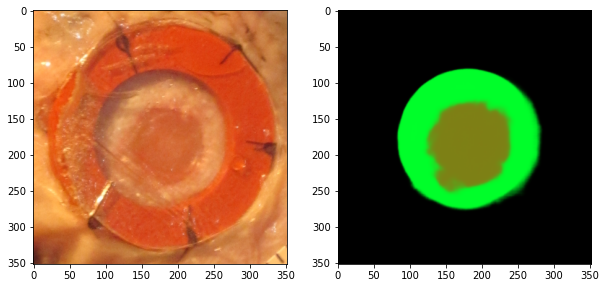

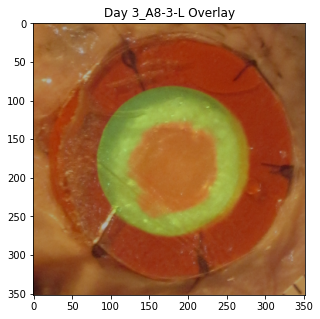

Day 1_Y8-1-L.png


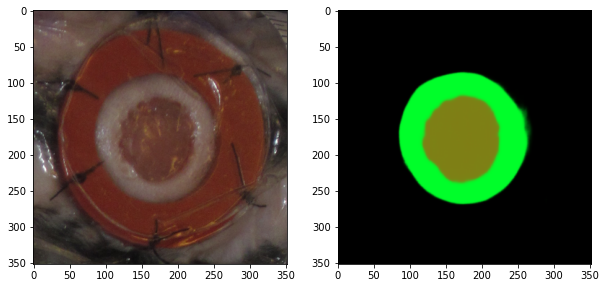

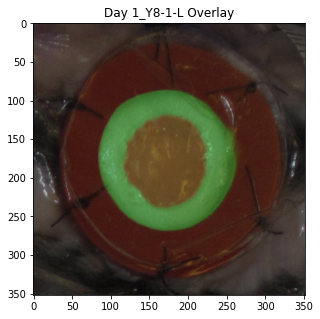

Day 10_Y8-3-R.png


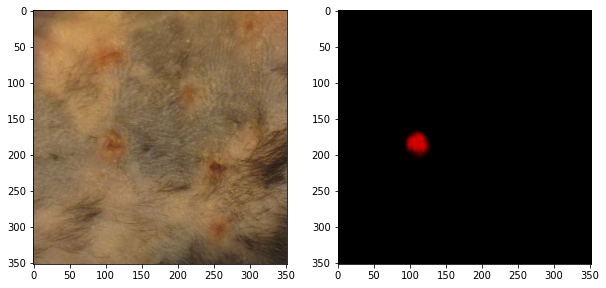

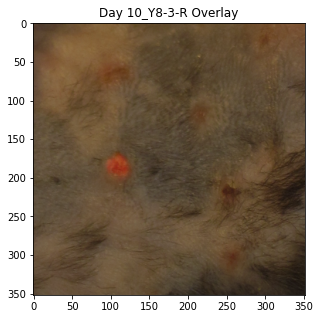

Day 5_Y8-2-R.png


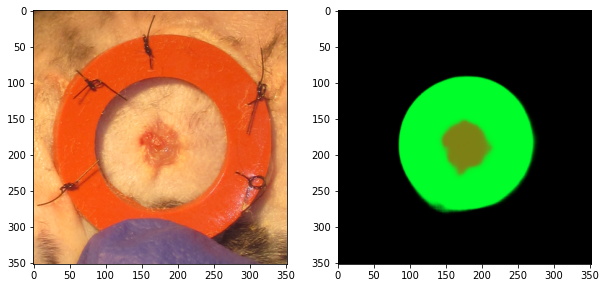

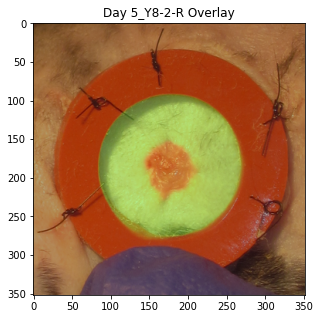

Day 4_A8-5-L.png


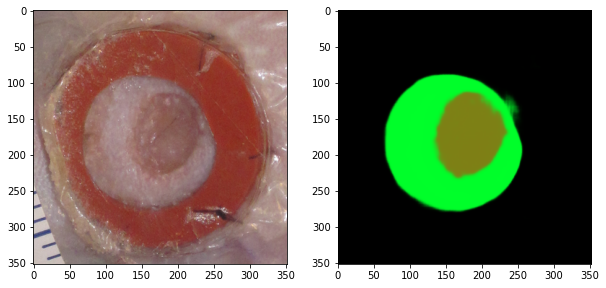

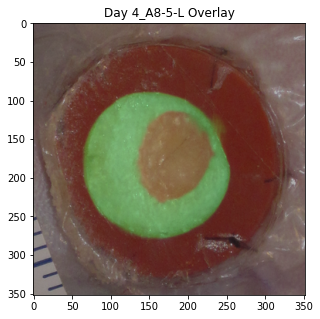

Day 8_Y8-4-R.png


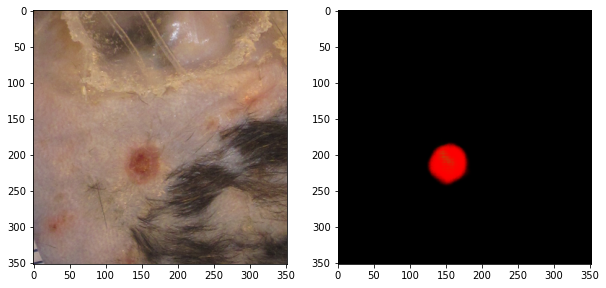

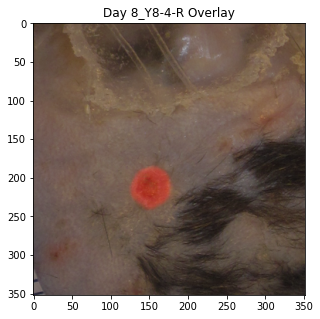

Day 3_A8-5-R.png


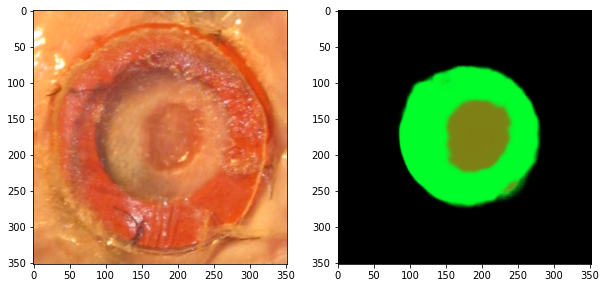

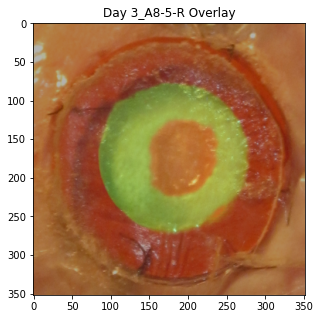

Day 11_A8-3-L.png


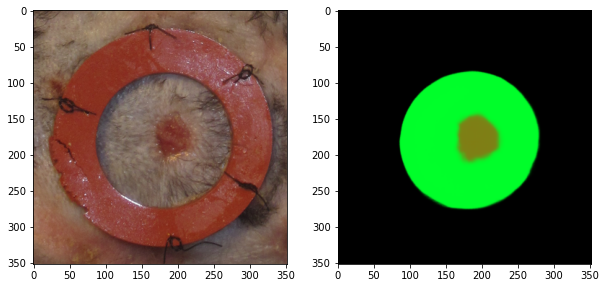

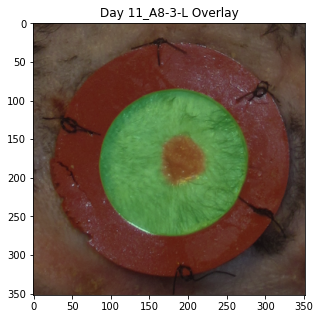

Day 8_Y8-1-L.png


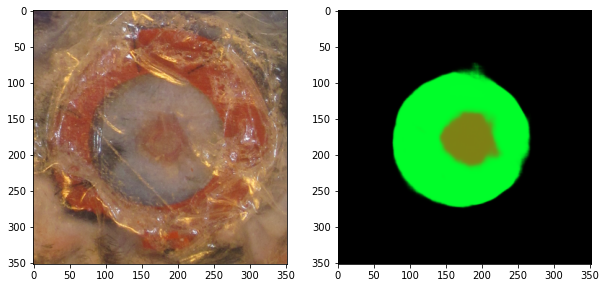

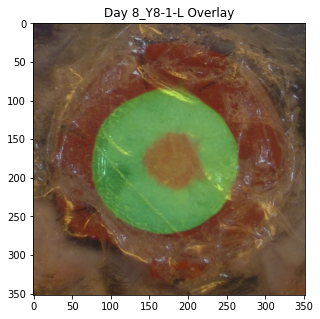

Day 0_A8-1-L.png


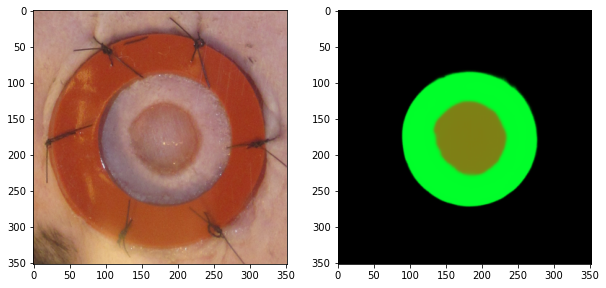

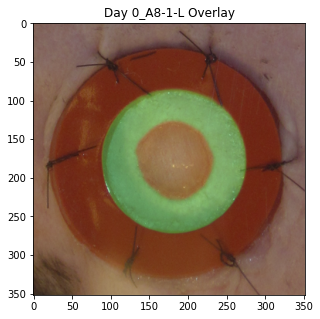

Day 13_Y8-2-R.png


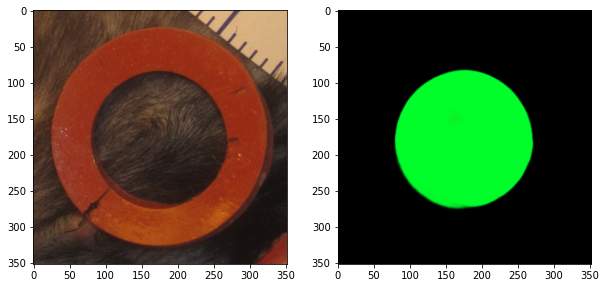

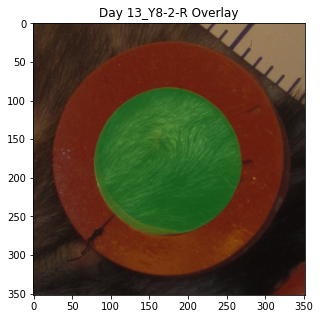

Day 14_A8-4-L.png


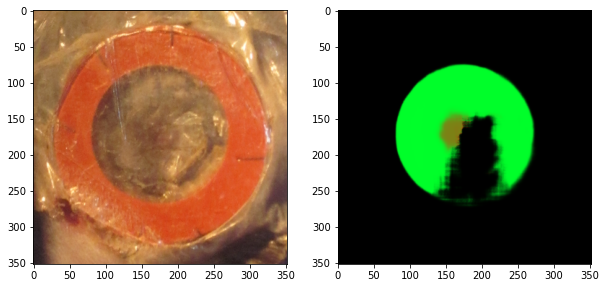

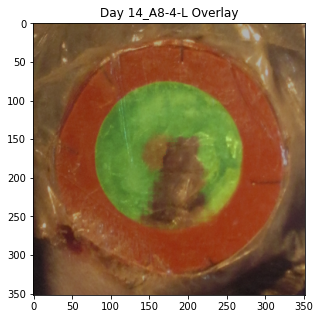

Day 5_Y8-3-L.png


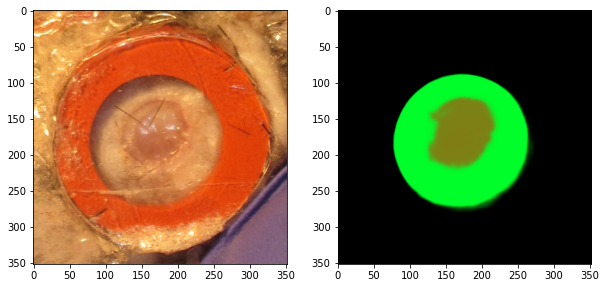

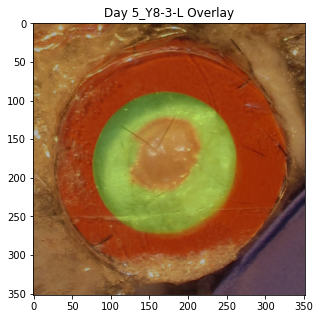

Day 15_Y8-4-L.png


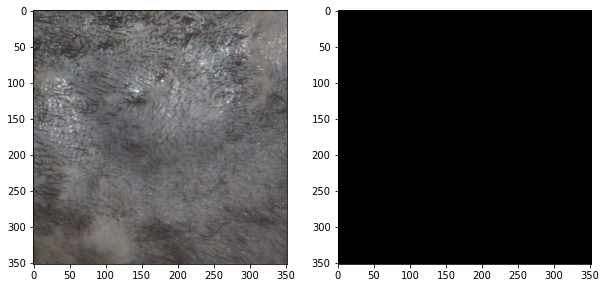

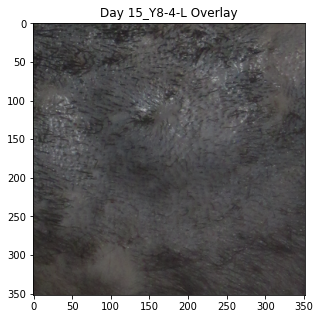

Day 0_Y8-4-R.png


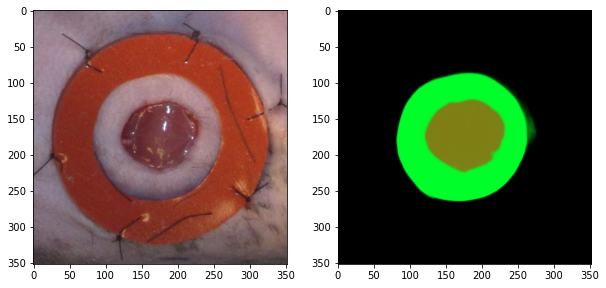

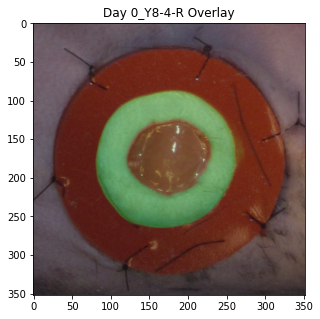

Day 7_Y8-4-L.png


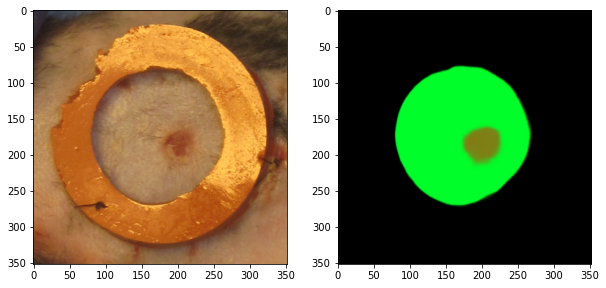

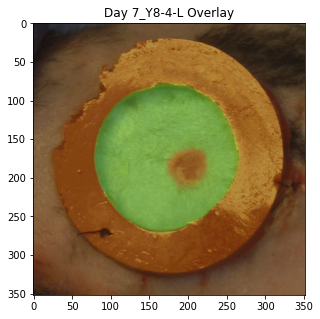

Day 13_Y8-3-L.png


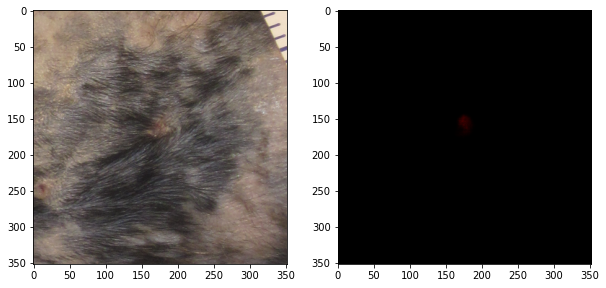

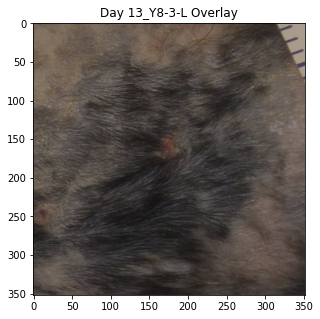

Day 2_Y8-2-L.png


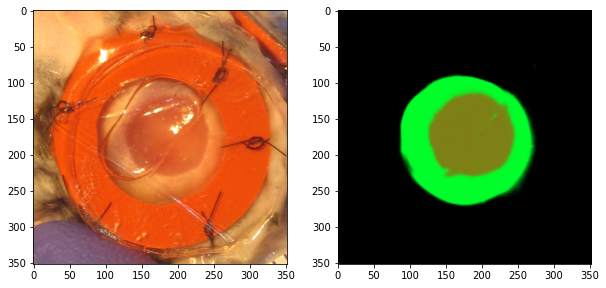

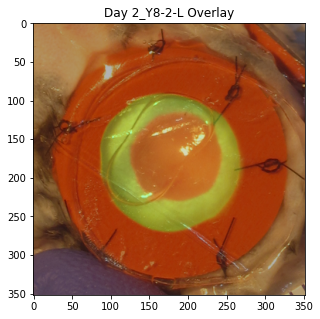

Day 1_A8-4-R.png


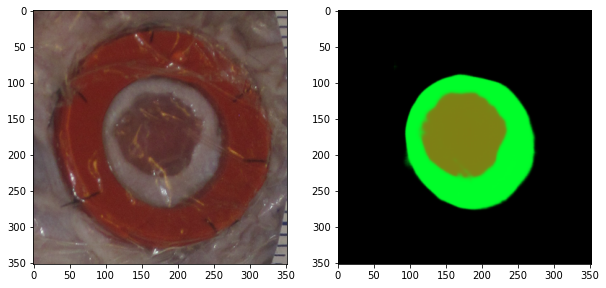

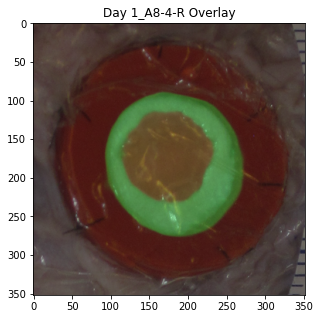

Day 15_A8-1-R.png


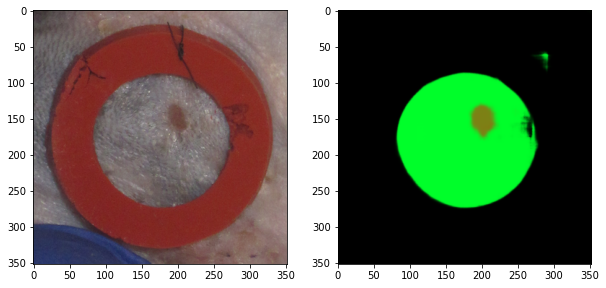

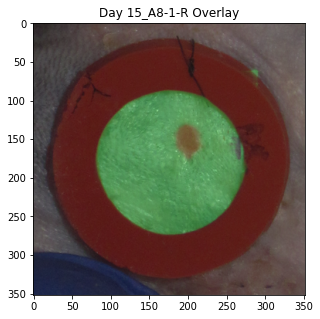

Day 10_Y8-2-L.png


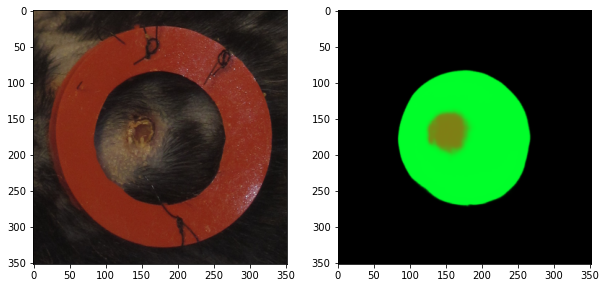

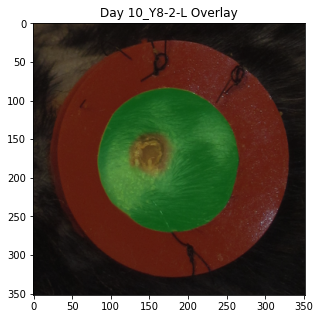

Day 6_Y8-1-R.png


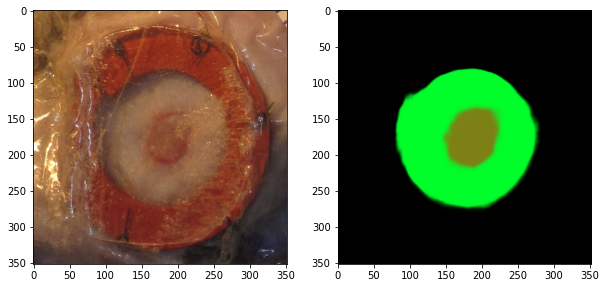

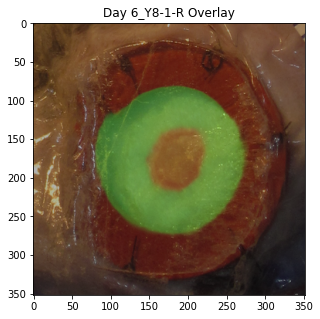

Day 2_Y8-3-R.png


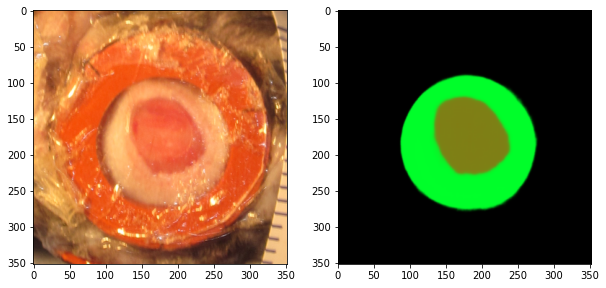

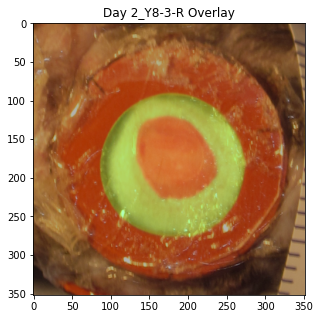

Day 4_A8-3-R.png


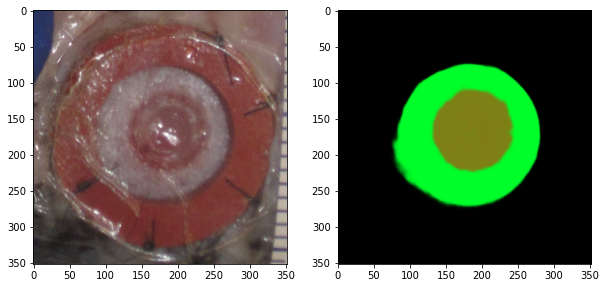

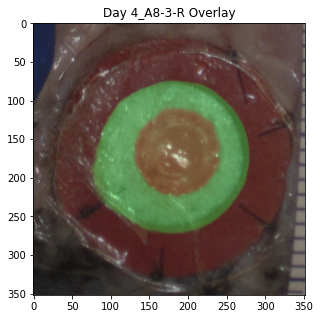

Day 12_A8-5-L.png


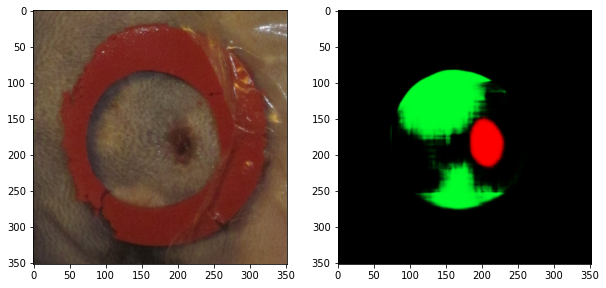

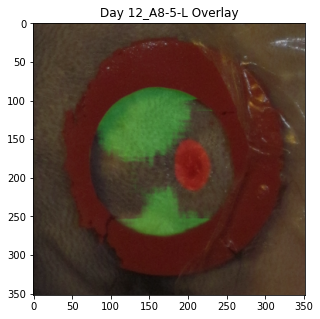

Day 7_A8-1-R.png


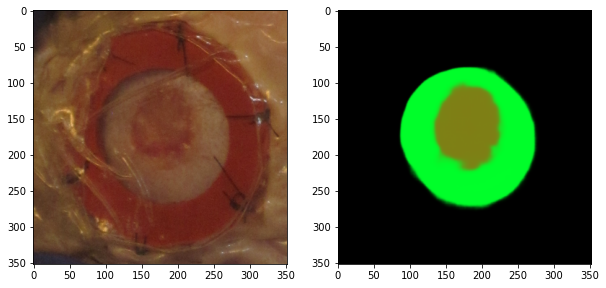

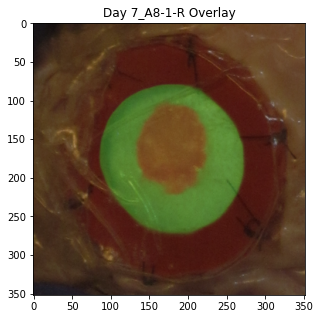

Day 12_A8-3-R.png


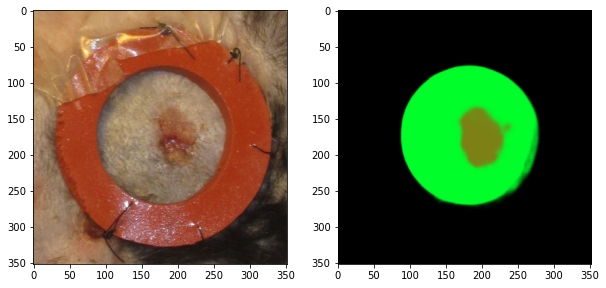

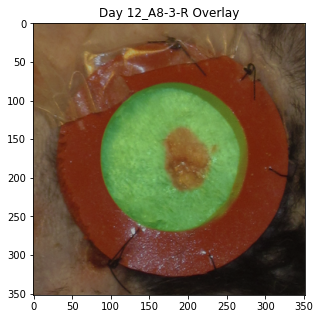

Day 8_A8-1-L.png


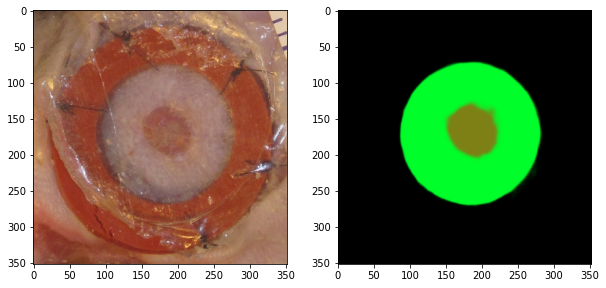

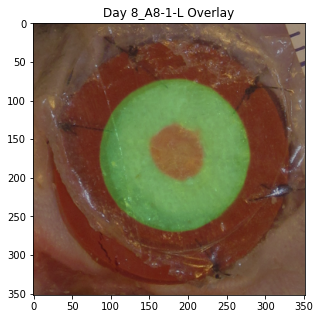

Day 6_A8-4-L.png


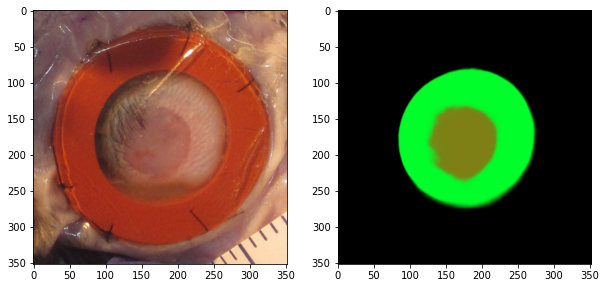

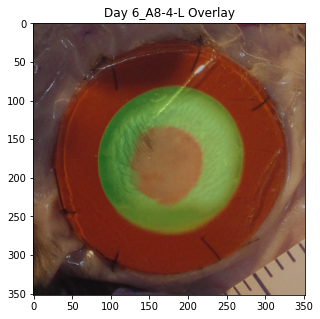

Day 14_Y8-1-R.png


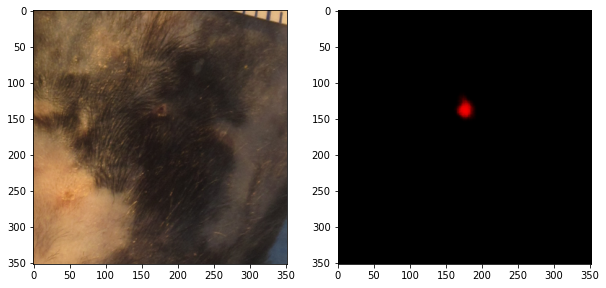

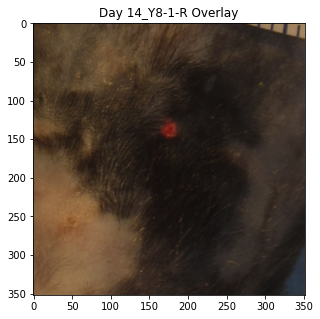

Day 11_A8-5-R.png


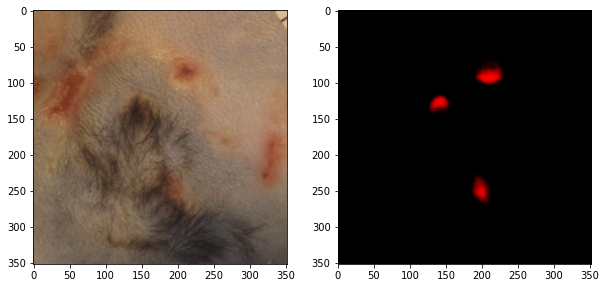

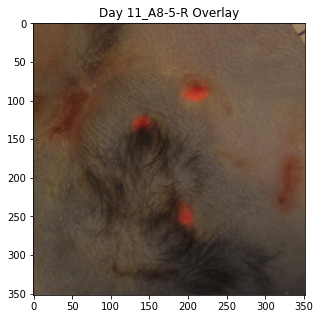

Day 9_A8-4-R.png


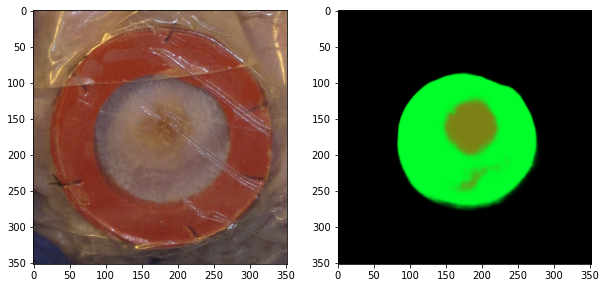

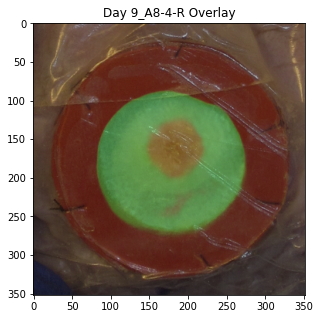

In [ ]:
test_preds = {}

for image in os.listdir('test_images'):

    img = load_img('../consistent_crops_full/' + image)
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)

    roi_pred = model.predict(img_array, batch_size=1)
    roi_mask = add_masks(roi_pred.squeeze()*255.0)

    im = plt.imread(('../consistent_crops_full/' + image), 1)
    print(image)
    plot_pair((im, roi_mask))
    
    plt.figure(figsize=(5,5))
    plt.imshow(im)
    plt.imshow(roi_mask, alpha=0.3)
    plt.title(image.split('.')[0] + ' Overlay')
    #plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Segmentation Overlay v8/" + image)
    plt.show()

    test_preds[image] = (im, roi_mask)

Let's try angled images (new + unseen at train time)

Day 1_Y8-1-R, Angle -12, Loc 26.png


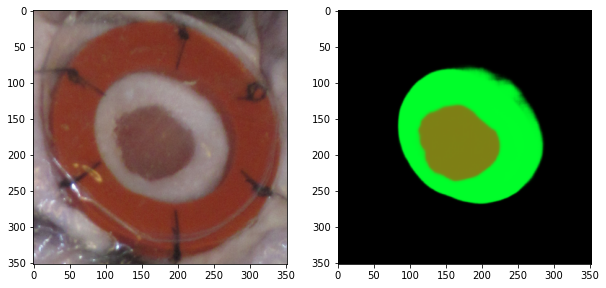

Day 1_Y8-1-L, Angle -12, Loc 27.png


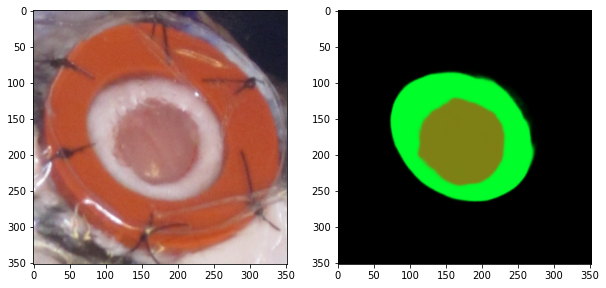

Day 2_Y8-1-L, Angle -12, Loc 28.png


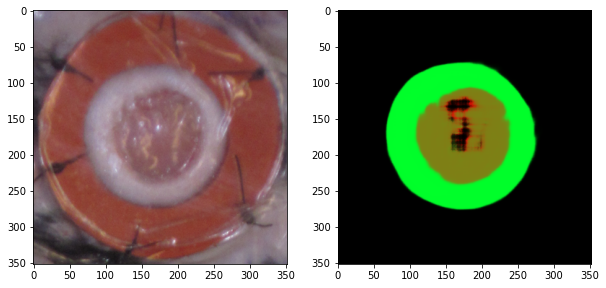

Day 2_A8-5-L, Angle -11, Loc 29.png


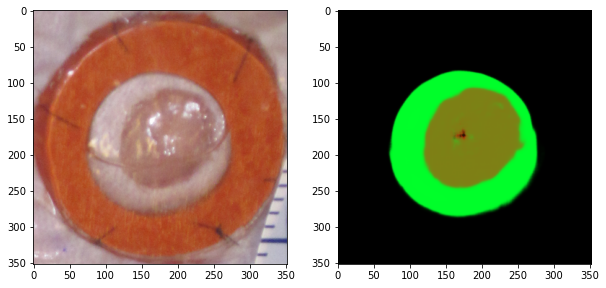

Day 1_Y8-3-R, Angle -13, Loc 30.png


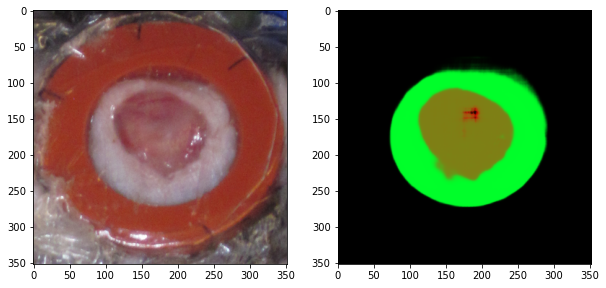

Day 2_Y8-4-L, Angle -13, Loc 31.png


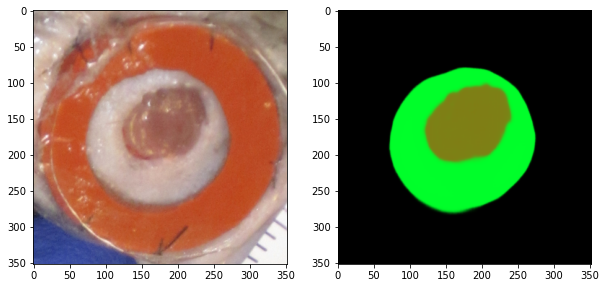

Day 0_Y8-1-L, Angle 0, Loc 32.png


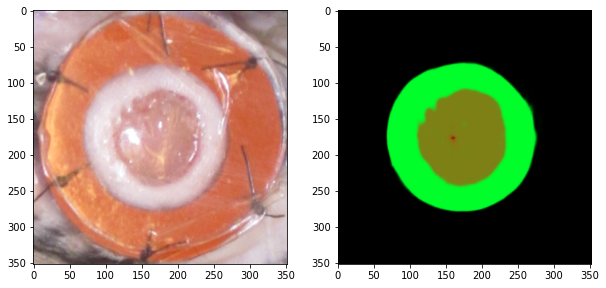

Day 2_A8-4-R, Angle -13, Loc 33.png


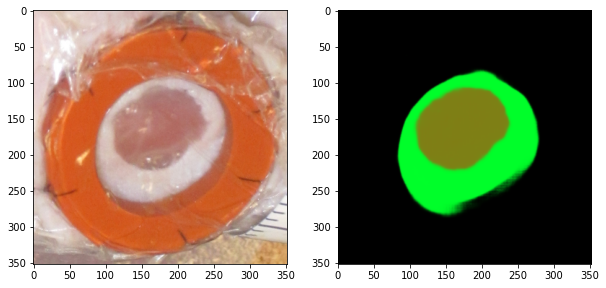

Day 0_A8-5-L, Angle 0, Loc 34.png


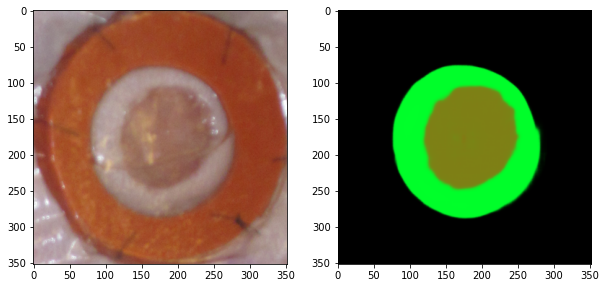

Day 2_A8-3-L, Angle -12, Loc 35.png


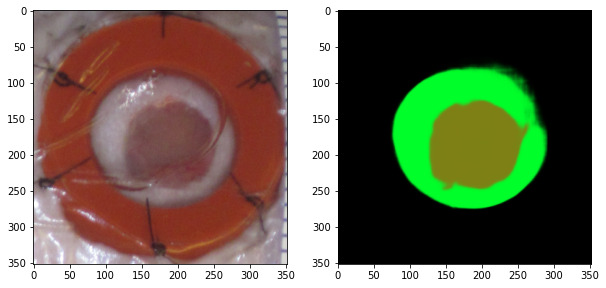

Day 0_Y8-4-R, Angle 0, Loc 36.png


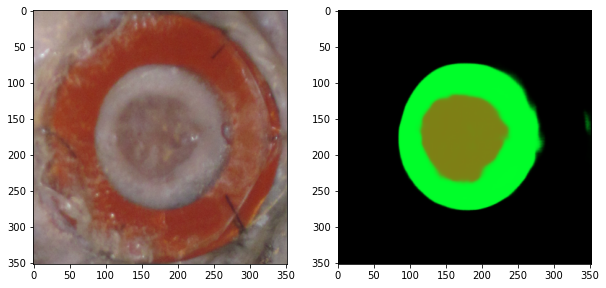

Day 1_Y8-2-R, Angle -14, Loc 37.png


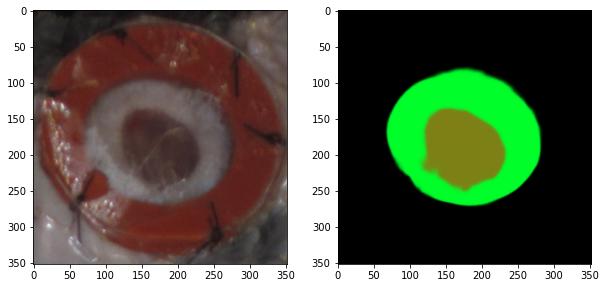

Day 0_Y8-2-L, Angle 0, Loc 38.png


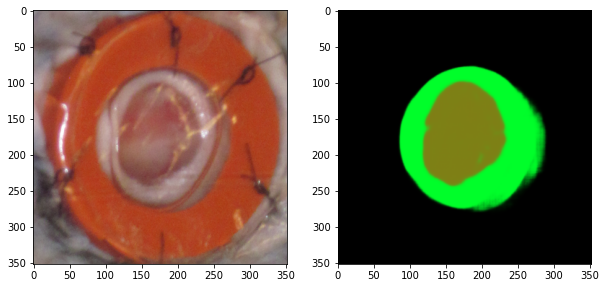

Day 2_Y8-2-R, Angle -12, Loc 39.png


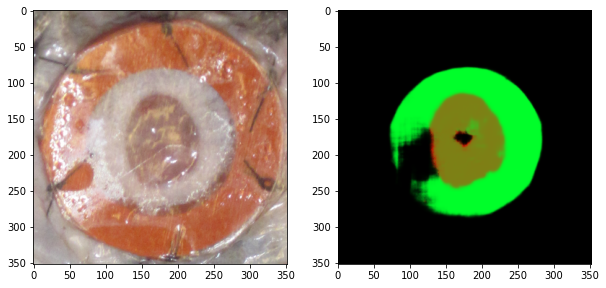

Day 2_A8-4-L, Angle -13, Loc 40.png


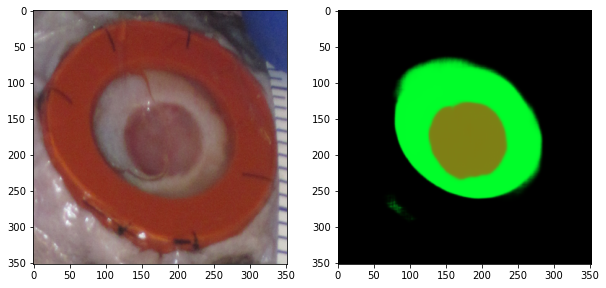

Day 1_A8-3-R, Angle -13, Loc 41.png


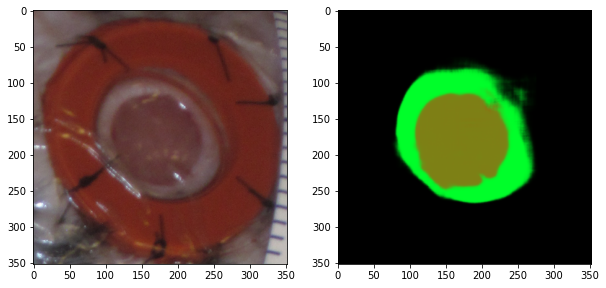

Day 2_Y8-3-L, Angle -12, Loc 42.png


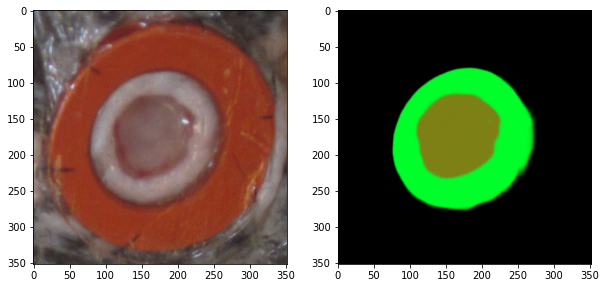

Day 2_A8-1-R, Angle -13, Loc 43.png


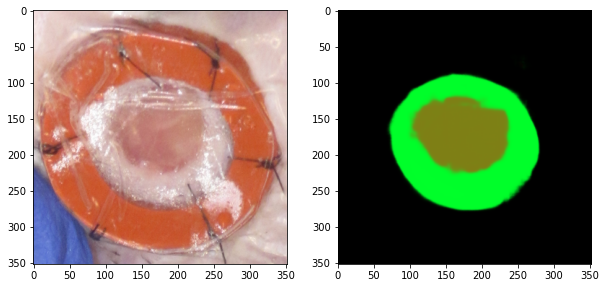

Day 1_A8-4-L, Angle -13, Loc 44.png


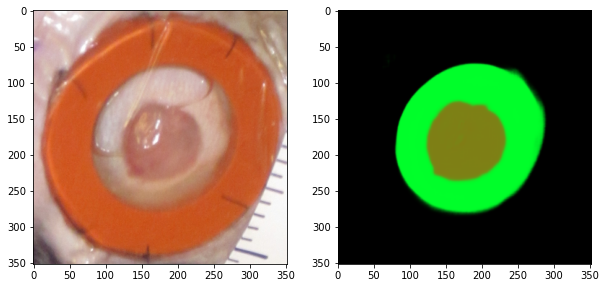

Day 2_Y8-3-R, Angle -13, Loc 45.png


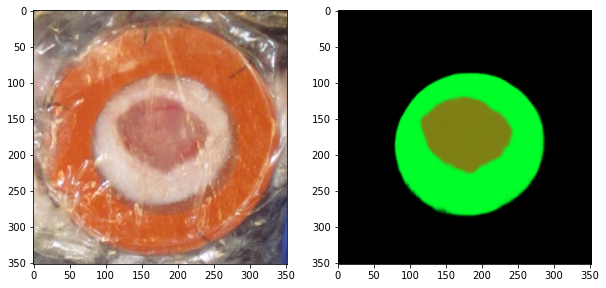

Day 1_A8-1-L, Angle -11, Loc 46.png


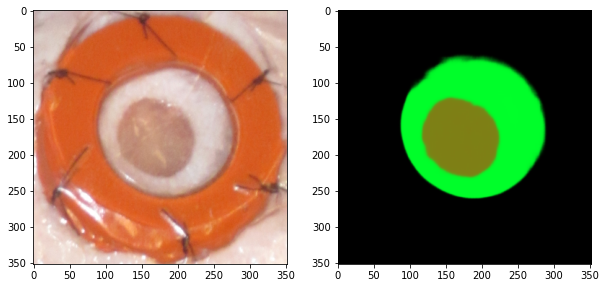

Day 2_A8-1-L, Angle -10, Loc 47.png


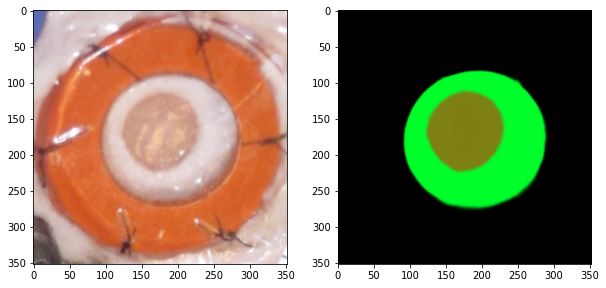

Day 1_A8-5-L, Angle -13, Loc 48.png


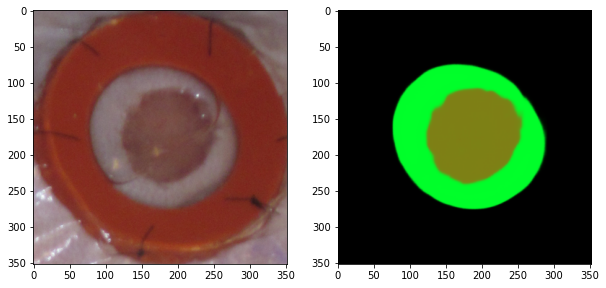

Day 0_A8-3-L, Angle 0, Loc 1.png


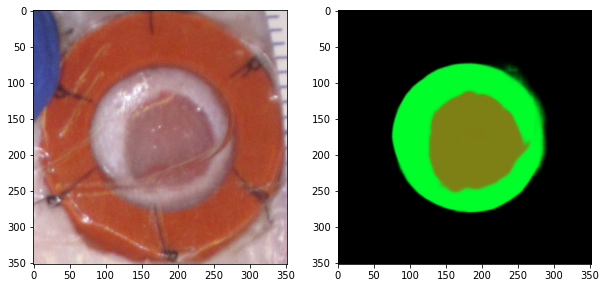

Day 2_Y8-1-R, Angle -13, Loc 2.png


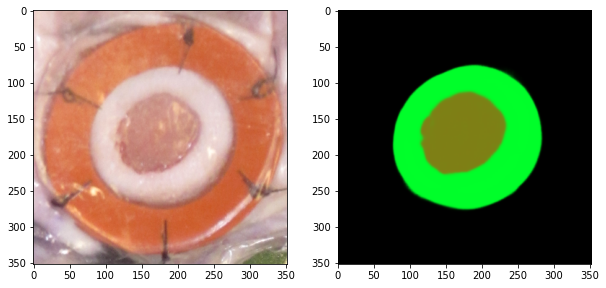

Day 1_Y8-4-L, Angle -12, Loc 3.png


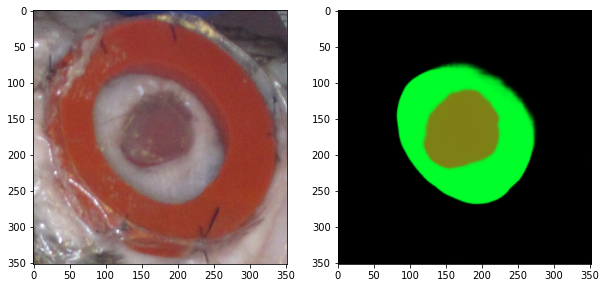

Day 1_Y8-3-L, Angle -13, Loc 4.png


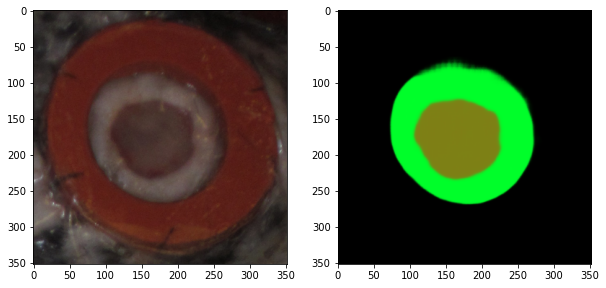

Day 0_Y8-1-R, Angle 0, Loc 5.png


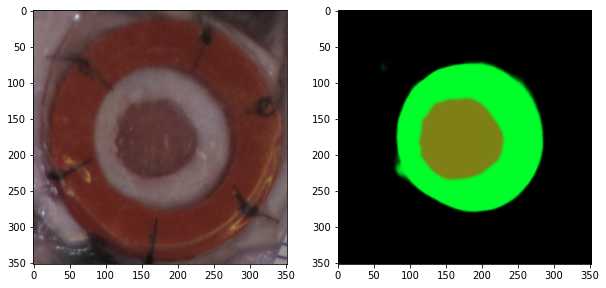

Day 0_Y8-3-L, Angle 0, Loc 6.png


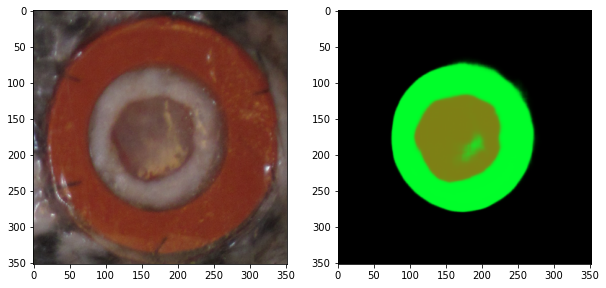

Day 0_A8-5-R, Angle 0, Loc 7.png


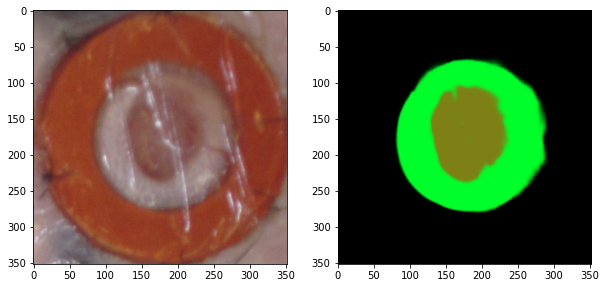

Day 1_A8-4-R, Angle -13, Loc 8.png


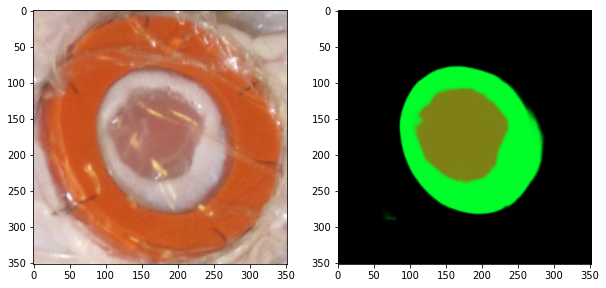

Day 1_A8-3-L, Angle -12, Loc 9.png


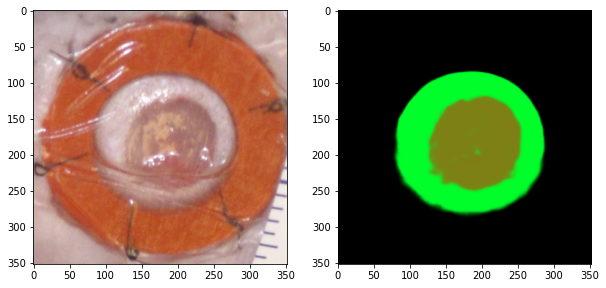

Day 2_A8-3-R, Angle -12, Loc 10.png


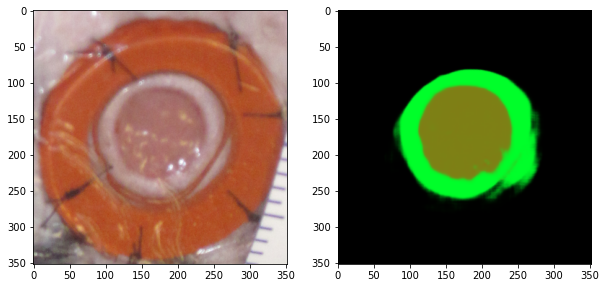

Day 0_Y8-2-R, Angle 0, Loc 11.png


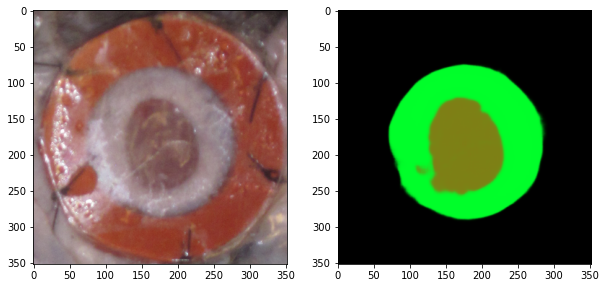

Day 1_Y8-2-L, Angle -12, Loc 12.png


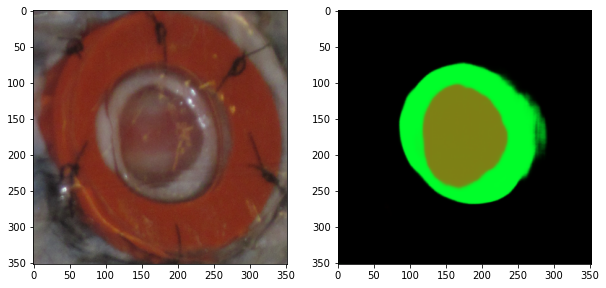

Day 2_Y8-2-L, Angle -14, Loc 13.png


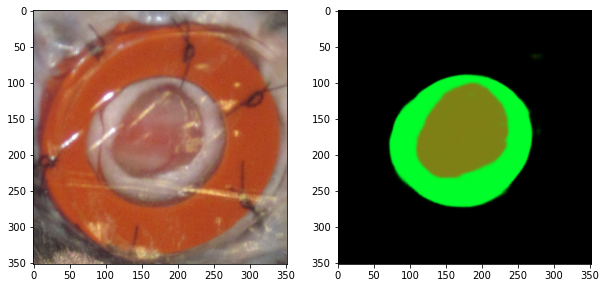

Day 0_A8-1-R, Angle 0, Loc 14.png


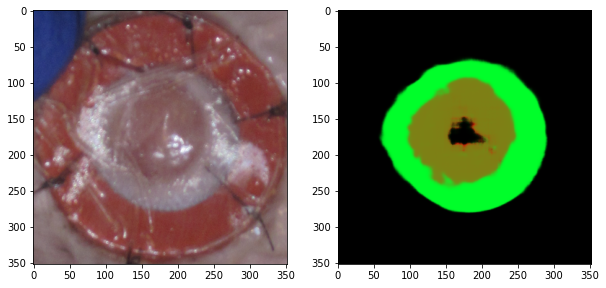

Day 0_A8-4-L, Angle 0, Loc 15.png


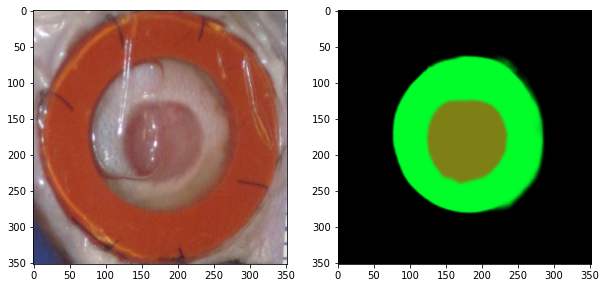

Day 1_A8-1-R, Angle -13, Loc 16.png


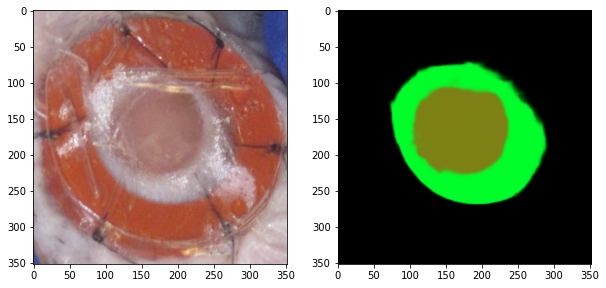

Day 0_A8-3-R, Angle 0, Loc 17.png


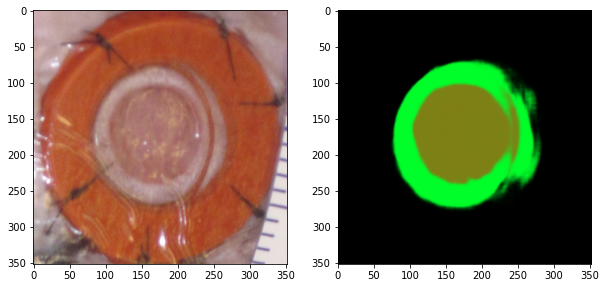

Day 2_A8-5-R, Angle -15, Loc 18.png


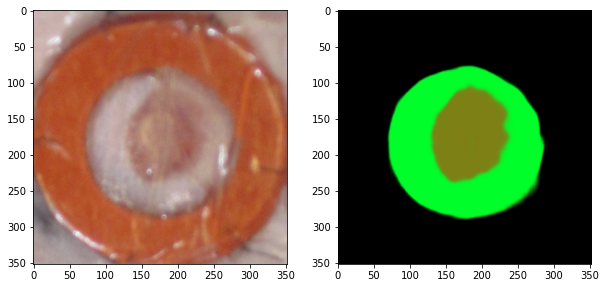

Day 0_A8-4-R, Angle 0, Loc 19.png


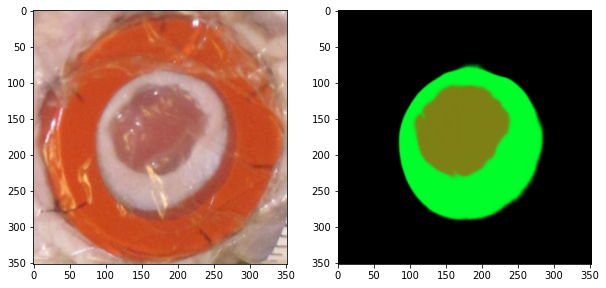

Day 0_Y8-4-L, Angle 0, Loc 20.png


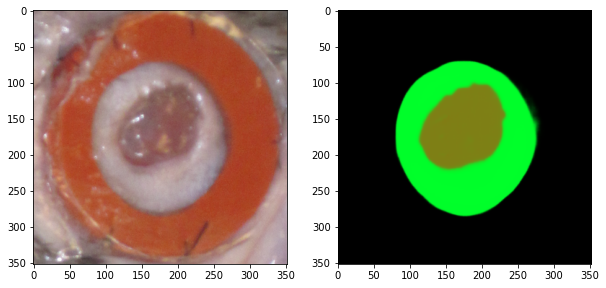

Day 2_Y8-4-R, Angle -13, Loc 21.png


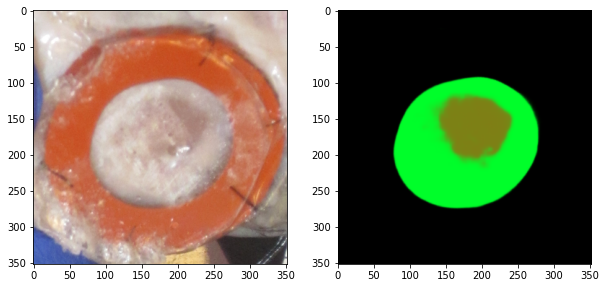

Day 1_A8-5-R, Angle -15, Loc 22.png


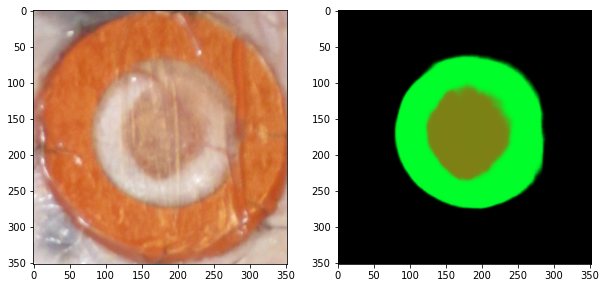

Day 0_A8-1-L, Angle 0, Loc 23.png


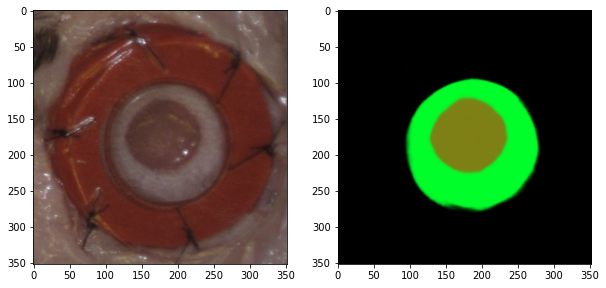

Day 0_Y8-3-R, Angle 0, Loc 24.png


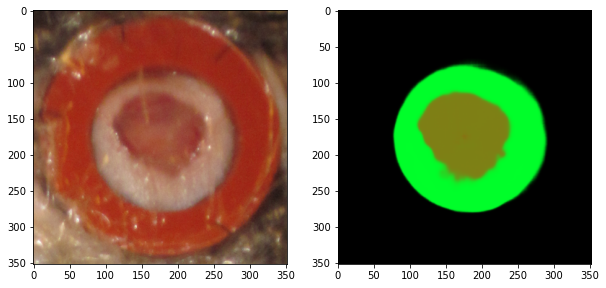

Day 1_Y8-4-R, Angle -13, Loc 25.png


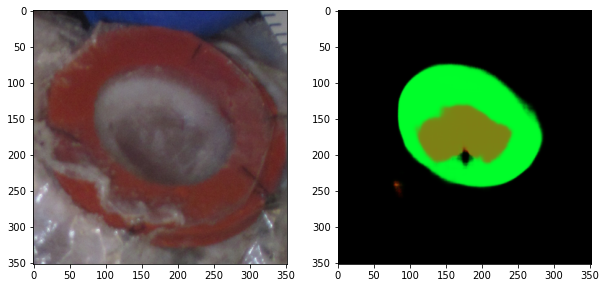

In [ ]:
new_preds = {}
path = '/content/drive/My Drive/Hector_MJ_Google_Drive/Pipeline/crops_angled/'

for image in os.listdir(path):

    print(image)
    img = load_img(path + image)
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)

    roi_pred = model.predict(img_array, batch_size=1)
    roi_mask = add_masks(roi_pred.squeeze()*255.0)

    im = plt.imread((path + image), 1)
    plot_pair((im, roi_mask))
    
    '''
    plt.figure(figsize=(5,5))
    plt.imshow(im)
    plt.imshow(roi_mask, alpha=0.3)
    plt.title(image.split('.')[0] + ' Overlay')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Pipeline/angled_overlays/" + image)
    plt.show()
    '''

    new_preds[image] = (im, roi_mask)

Prediction on the whole set (no display to accelerate inference)

In [ ]:
old_preds = {}

for image in os.listdir('../consistent_crops_old'):

    img = load_img('../consistent_crops_old/' + image)
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)

    roi_pred = model.predict(img_array, batch_size=1)
    roi_mask = add_masks(roi_pred.squeeze()*255.0)

    im = plt.imread(('../consistent_crops_old/' + image), 1)

    # You may turn this on to look at the predictions
    print(image)
    #plot_pair((im, roi_mask))
    
    '''
    plt.figure(figsize=(8,8))
    plt.imshow(im)
    plt.imshow(roi_mask, alpha=0.3)
    plt.title(image.split('.')[0] + ' Overlay')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Segmentation Overlay/" + image)
    plt.show()
    '''

    old_preds[image] = (im, roi_mask)

Day 0_A8-4-R.png
Day 0_A8-3-L.png
Day 0_A8-4-L.png
Day 0_A8-1-L.png
Day 0_A8-3-R.png
Day 0_A8-5-L.png
Day 0_A8-1-R.png
Day 0_A8-5-R.png
Day 0_Y8-3-L.png
Day 0_Y8-2-L.png
Day 0_Y8-4-L.png
Day 0_Y8-2-R.png
Day 0_Y8-3-R.png
Day 0_Y8-1-L.png
Day 0_Y8-1-R.png
Day 0_Y8-4-R.png
Day 10_A8-5-L.png
Day 10_A8-4-R.png
Day 10_A8-3-L.png
Day 10_A8-1-L.png
Day 10_A8-1-R.png
Day 10_A8-3-R.png
Day 10_A8-4-L.png
Day 10_Y8-4-R.png
Day 10_Y8-2-R.png
Day 10_Y8-4-L.png
Day 10_Y8-3-L.png
Day 10_Y8-1-R.png
Day 10_Y8-3-R.png
Day 10_Y8-1-L.png
Day 10_Y8-2-L.png
Day 11_A8-3-R.png
Day 11_A8-1-L.png
Day 11_A8-4-L.png
Day 11_A8-1-R.png
Day 11_A8-4-R.png
Day 11_A8-5-R.png
Day 11_A8-5-L.png
Day 11_A8-3-L.png
Day 11_Y8-1-L.png
Day 11_Y8-2-L.png
Day 11_Y8-2-R.png
Day 11_Y8-1-R.png
Day 11_Y8-4-L.png
Day 11_Y8-3-R.png
Day 11_Y8-3-L.png
Day 11_Y8-4-R.png
Day 12_A8-4-R.png
Day 12_A8-3-R.png
Day 12_A8-4-L.png
Day 12_A8-3-L.png
Day 12_A8-1-L.png
Day 12_A8-1-R.png
Day 12_Y8-2-R.png
Day 12_Y8-3-R.png
Day 12_Y8-3-L.png
Day 12_A

Hard coded expectations from our data format, this helps us generate mouse objects that make sense. This should be edited depending on the input data and filename format.

Old mice metadata

In [ ]:
all_preds = old_preds.copy()

In [ ]:
mice = ['A8-1', 'A8-3', 'A8-4', 'A8-5', 'Y8-1', 'Y8-2', 'Y8-3', 'Y8-4']
sides = ['L', 'R']
days = 16

pred_mice = []
r_total_size = 0
r_total = 0
g_total_size = 0
g_total = 0

# this should be re-computed for new data
dataset_g_avg = 22442.37401574803
dataset_r_avg = 5536.783464566929

for mouse in mice:
    new_mouse = Mouse(mouse)
    for day in range(days):
        for side in sides:

            # Build filenames in order
            day_str = 'Day ' + str(day) + '_'
            side_ext = '-' + side + '.png'
            img_key = day_str + mouse + side_ext

            try:
                #print(img_key)
                image, prediction = all_preds[img_key]
                ring_size, wound_size, area, diameter = clean_size(prediction)
                if ring_size == dataset_g_avg:
                    print("Averaged in for:", mouse, day, side)
                new_wound = Wound(day, ring_size, wound_size, area, diameter, image, prediction)
                
                if side == 'L':
                    new_mouse.left_wounds.append(new_wound)

                elif side == 'R':
                    new_mouse.right_wounds.append(new_wound)

            except:
                print('Exception, image', img_key, 'has no prediction')

    pred_mice.append(new_mouse)

recalculated_dataset_g_avg = g_total_size / g_total
recalculated_dataset_r_avg = r_total_size / r_total

Averaged in for: A8-1 12 L
Averaged in for: A8-1 13 L
Exception, image Day 10_A8-5-R.png has no prediction
Averaged in for: A8-5 11 L
Averaged in for: A8-5 11 R
Averaged in for: A8-5 12 L
Averaged in for: A8-5 13 R
Averaged in for: A8-5 14 L
Averaged in for: A8-5 15 L
Averaged in for: Y8-1 7 R
Averaged in for: Y8-1 8 R
Averaged in for: Y8-1 9 R
Averaged in for: Y8-1 10 R
Averaged in for: Y8-1 11 L
Averaged in for: Y8-1 12 L
Averaged in for: Y8-1 14 R
Exception, image Day 9_Y8-2-R.png has no prediction
Averaged in for: Y8-3 10 R
Averaged in for: Y8-3 11 R
Averaged in for: Y8-3 12 L
Averaged in for: Y8-3 12 R
Averaged in for: Y8-3 13 L
Averaged in for: Y8-4 7 R
Averaged in for: Y8-4 8 R
Averaged in for: Y8-4 9 R
Averaged in for: Y8-4 10 R
Averaged in for: Y8-4 11 R
Averaged in for: Y8-4 12 L
Averaged in for: Y8-4 14 L


New mice metadata

In [ ]:
mice = ['A6-1', 'A6-2', 'A6-3', 'A6-4', 'A6-5', 'Y6-1', 'Y6-2', 'Y6-3', 'Y6-4', 'Y6-5']
sides = ['S', 'U']
days = 8

In [ ]:
all_preds = new_preds.copy()

In [ ]:
pred_mice = []
r_total_size = 0
r_total = 0
g_total_size = 0
g_total = 0

# Dataset 1
#dataset_g_avg = 22442.37401574803
#dataset_r_avg = 5536.783464566929

# Dataset 2
dataset_g_avg = 14049.7125
dataset_r_avg = 18182.2625

for mouse in mice:
    new_mouse = Mouse(mouse)
    for day in range(days):
        for side in sides:

            # Build filenames in order
            day_str = 'Day ' + str(day) + '_'
            side_ext = '-' + side + '.png'
            img_key = day_str + mouse + side_ext

            try:
                #print(img_key)
                image, prediction = all_preds[img_key]
                ring_size, wound_size, area, diameter = clean_size(prediction)
                new_wound = Wound(day, ring_size, wound_size, area, diameter, image, prediction)
                
                if side == 'S':
                    new_mouse.left_wounds.append(new_wound)

                elif side == 'U':
                    new_mouse.right_wounds.append(new_wound)

            except:
                print('Exception, image', img_key, 'has no prediction')

    pred_mice.append(new_mouse)

dataset_g_avg = g_total_size / g_total
dataset_r_avg = r_total_size / r_total

In [ ]:
print(dataset_g_avg, dataset_r_avg)

22442.37401574803 5536.783464566929


## Angled

In [ ]:
def get_key(keys, img_key):
    for key in keys:
        if key.startswith(img_key):
            return key
    return IndexError("Key not in keys")

In [ ]:
keys = list(new_preds.keys())

In [ ]:
mice = ['A8-1', 'A8-3', 'A8-4', 'A8-5', 'Y8-1', 'Y8-2', 'Y8-3', 'Y8-4']
sides = ['L', 'R']
days = 3

all_preds = new_preds.copy()

pred_mice = []
r_total_size = 0
r_total = 0
g_total_size = 0
g_total = 0

# this should be re-computed for new data
dataset_g_avg = 22442.37401574803
dataset_r_avg = 5536.783464566929

for mouse in mice:
    new_mouse = Mouse(mouse)
    for day in range(days):
        for side in sides:

            # Build filenames in order
            day_str = 'Day ' + str(day) + '_'
            side_ext = '-' + side # + '.png'
            img_key = day_str + mouse + side_ext

            img_key = get_key(keys, img_key)

            try:
                #print(img_key)
                image, prediction = all_preds[img_key]
                ring_size, wound_size, area, diameter = clean_size(prediction)
                if ring_size == dataset_g_avg:
                    print("Averaged in for:", mouse, day, side)
                new_wound = Wound(day, ring_size, wound_size, area, diameter, image, prediction)
                
                if side == 'L':
                    new_mouse.left_wounds.append(new_wound)

                elif side == 'R':
                    new_mouse.right_wounds.append(new_wound)

            except:
                print('Exception, image', img_key, 'has no prediction')

    pred_mice.append(new_mouse)

recalculated_dataset_g_avg = g_total_size / g_total
recalculated_dataset_r_avg = r_total_size / r_total

In [ ]:
for mouse in pred_mice:
    print("ID: ", mouse.id)
    print("Side: L")
    print("Areas: ", mouse.get_areas("L"))
    print("Diameters: ", mouse.get_diameters("L"))
    print("Side: R")
    print("Areas: ", mouse.get_areas("R"))
    print("Diameters: ", mouse.get_diameters("R"))
    print()

ID:  A8-1
Side: L
Areas:  [25.718, 23.942, 24.776]
Diameters:  [5.722, 5.521, 5.617]
Side: R
Areas:  [34.869, 33.418, 29.763]
Diameters:  [6.663, 6.523, 6.156]

ID:  A8-3
Side: L
Areas:  [32.547, 32.769, 31.329]
Diameters:  [6.437, 6.459, 6.316]
Side: R
Areas:  [39.21, 39.103, 37.938]
Diameters:  [7.066, 7.056, 6.95]

ID:  A8-4
Side: L
Areas:  [22.796, 23.194, 23.829]
Diameters:  [5.387, 5.434, 5.508]
Side: R
Areas:  [30.651, 32.421, 31.567]
Diameters:  [6.247, 6.425, 6.34]

ID:  A8-5
Side: L
Areas:  [34.376, 32.818, 35.872]
Diameters:  [6.616, 6.464, 6.758]
Side: R
Areas:  [25.241, 26.361, 24.669]
Diameters:  [5.669, 5.793, 5.604]

ID:  Y8-1
Side: L
Areas:  [30.73, 32.351, 33.116]
Diameters:  [6.255, 6.418, 6.493]
Side: R
Areas:  [24.883, 24.312, 25.556]
Diameters:  [5.629, 5.564, 5.704]

ID:  Y8-2
Side: L
Areas:  [32.384, 34.867, 35.873]
Diameters:  [6.421, 6.663, 6.758]
Side: R
Areas:  [25.671, 25.809, 27.511]
Diameters:  [5.717, 5.732, 5.918]

ID:  Y8-3
Side: L
Areas:  [28.396, 27.

## New Search-based ring masks

Generate dictionary of good wound to ring sizes

In [ ]:
abs_diff = lambda list_value : abs(list_value - given_value)

In [ ]:
wound_to_ring = {}
for mice in pred_mice:
    left = mice.left_wounds
    right = mice.right_wounds
    days_left = mice.get_days("L")
    days_right = mice.get_days("R")
    
    for left_wound, right_wound, day_l, day_r in zip(left, right, days_left, days_right):
        
        if left_wound.ring_size != dataset_g_avg:
            wound_to_ring[left_wound.wound_size] = (left_wound.ring_size, day_l)
        else:
            print("Got one")
            print(left_wound.ring_size)
            
        if right_wound.ring_size != dataset_g_avg:
            wound_to_ring[right_wound.wound_size] = (right_wound.ring_size, day_r)
        else:
            print("Got one")
            print(right_wound.ring_size)


Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803
Got one
22442.37401574803


In [ ]:
len(wound_to_ring)

196

In [ ]:
len(all_preds)

254

In [ ]:
old_mice = ['A8-1', 'A8-3', 'A8-4', 'A8-5', 'Y8-1', 'Y8-2', 'Y8-3', 'Y8-4']
old_sides = ['L', 'R']
old_days = 16

In [ ]:
old_pred_mice = []
r_total_size = 0
r_total = 0
g_total_size = 0
g_total = 0

# this should be re-computed for new data
dataset_g_avg = 22442.37401574803
dataset_r_avg = 5536.783464566929

for mouse in old_mice:
    new_mouse = Mouse(mouse)
    for day in range(old_days):
        for side in old_sides:

            # Build filenames in order
            day_str = 'Day ' + str(day) + '_'
            side_ext = '-' + side + '.png'
            img_key = day_str + mouse + side_ext

            try:
                #print(img_key)
                image, prediction = old_preds[img_key]
                ring_size, wound_size, area, diameter = clean_size(prediction)
                new_wound = Wound(day, ring_size, wound_size, area, diameter, image, prediction)
                
                if side == 'L':
                    new_mouse.left_wounds.append(new_wound)

                elif side == 'R':
                    new_mouse.right_wounds.append(new_wound)

            except:
                print('Exception, image', img_key, 'has no prediction')

    old_pred_mice.append(new_mouse)

Exception, image Day 10_A8-5-R.png has no prediction
Exception, image Day 9_Y8-2-R.png has no prediction


In [ ]:
for mice in old_pred_mice:
    left = mice.left_wounds
    right = mice.right_wounds
    days_left = mice.get_days("L")
    days_right = mice.get_days("R")

    for left_wound, right_wound, day_l, day_r in zip(left, right, days_left, days_right):
        
        if left_wound.ring_size != dataset_g_avg:
            wound_to_ring[left_wound.wound_size] = (left_wound.ring_size, day_l)
        else:
            print("Got one")

        if right_wound.ring_size != dataset_g_avg:
            wound_to_ring[right_wound.wound_size] = (right_wound.ring_size, day_r)
        else:
            print("Got one")

Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one
Got one


In [ ]:
wound_to_ring.pop(0)
wound_to_ring.pop(1)
wound_to_ring.pop(8)

(0, 15)

In [ ]:
len(wound_to_ring)

193

In [ ]:
import csv
with open('wound_to_ring_day.csv', 'w') as f:
    f.write("Wound Size, Ring Size\n")
    for key in wound_to_ring.keys():
        f.write("%s,%s\n"%(key,wound_to_ring[key]))

In [ ]:
%pwd

'/content/drive/.shortcut-targets-by-id/175Vkdh2mGaZ7CZsZetvNssl0puand1tS/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Semantic-Shapes'

In [ ]:
dataset_g_avg = 22442.37401574803
dataset_r_avg = 5536.783464566929

Find all the averaged in masks and recalculate

In [ ]:
import copy
new_tech_mice = copy.deepcopy(pred_mice)

#### Clean wound to ring dictionary, edit it

## Before doing all this, limit the number of rings and continue

In [ ]:
def apply_search_method(in_mice, size_database, deletions):

    changes = {}
    mice = copy.deepcopy(in_mice)
    for mouse in mice:
        left = mouse.left_wounds
        right = mouse.right_wounds

        for left_wound, right_wound in zip(left, right):
            
            if left_wound.ring_size == dataset_g_avg or left_wound.wound_size in deletions:

                pre = left_wound.area

                given_value = left_wound.wound_size
                # added this to compensate for day touple
                closest_ring = size_database[min(size_database.keys(), key=abs_diff)][0]

                ratio = left_wound.wound_size / closest_ring
                green_area = np.pi * (5**2) # known
                wound_area = round((ratio * green_area), 3)
                wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

                left_wound.area = wound_area
                left_wound.diameter = wound_diameter

                post = left_wound.area

                changes[mouse.id + " Left"] = (pre,post)


            if right_wound.ring_size == dataset_g_avg or right_wound.wound_size in deletions:
                pre = right_wound.area

                given_value = right_wound.wound_size
                # added this to compensate for day touple
                closest_ring = size_database[min(size_database.keys(), key=abs_diff)][0]

                ratio = right_wound.wound_size / closest_ring
                green_area = np.pi * (5**2) # known
                wound_area = round((ratio * green_area), 3)
                wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

                right_wound.area = wound_area
                right_wound.diameter = wound_diameter
                post = right_wound.area

                changes[mouse.id + " Right"] = (pre,post)

    return mice, changes

Applying ring search to the mice

In [ ]:
change = {}

count = 0
for mice in new_tech_mice:
    left = mice.left_wounds
    right = mice.right_wounds
    print(mice.id)

    for left_wound, right_wound in zip(left, right):

        if left_wound.wound_size in wound_to_ring:
            count += 1
        if right_wound.wound_size in wound_to_ring:
            count += 1
        
        if left_wound.ring_size == dataset_g_avg:

            print("pre left:", left_wound.area, left_wound.diameter)
            given_value = left_wound.wound_size
            closest_ring = wound_to_ring[min(wound_to_ring.keys(), key=abs_diff)]

            ratio = left_wound.wound_size / closest_ring[0]
            green_area = np.pi * (5**2) # known
            wound_area = round((ratio * green_area), 3)
            wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

            left_wound.area = wound_area
            left_wound.diameter = wound_diameter
            print("post left:", left_wound.area, left_wound.diameter)

        if right_wound.ring_size == dataset_g_avg:

            print("pre right:", right_wound.area, right_wound.diameter)
            pre = right_wound.area
            given_value = right_wound.wound_size
            closest_ring = wound_to_ring[min(wound_to_ring.keys(), key=abs_diff)]

            ratio = right_wound.wound_size / closest_ring[0]
            green_area = np.pi * (5**2) # known
            wound_area = round((ratio * green_area), 3)
            wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

            right_wound.area = wound_area
            right_wound.diameter = wound_diameter
            print("post right:", right_wound.area, right_wound.diameter)
            post = right_wound.area

            change[mice.id] = (pre,post)

A8-1
pre left: 10.999 3.742
post left: 8.199 3.231
pre left: 6.982 2.982
post left: 5.572 2.664
A8-3
A8-4
A8-5
pre right: 1.9 1.555
post right: 1.439 1.354
pre left: 8.991 3.383
post left: 6.858 2.955
pre left: 10.11 3.588
post left: 6.85 2.953
pre right: 4.088 2.281
post right: 3.303 2.051
pre left: 6.033 2.772
post left: 4.652 2.434
Y8-1
pre right: 9.256 3.433
post right: 7.176 3.023
pre right: 7.832 3.158
post right: 6.043 2.774
pre right: 4.794 2.471
post right: 3.775 2.192
pre right: 4.207 2.314
post right: 3.399 2.08
pre left: 3.951 2.243
post left: 3.081 1.981
pre left: 8.361 3.263
post left: 6.654 2.911
pre right: 2.296 1.71
post right: 1.739 1.488
Y8-2
Y8-3
pre right: 3.549 2.126
post right: 2.636 1.832
pre right: 5.599 2.67
post right: 4.346 2.352
pre left: 5.312 2.601
post left: 4.388 2.364
pre right: 0.248 0.562
post right: 0.202 0.507
pre left: 0.899 1.07
post left: 0.731 0.965
Y8-4
pre right: 10.555 3.666
post right: 7.868 3.165
pre right: 9.131 3.41
post right: 6.965 2.9

In [ ]:
len(wound_to_ring)

193

## Post-processing scratch


In [ ]:
for mice in pred_mice:
    print(mice)

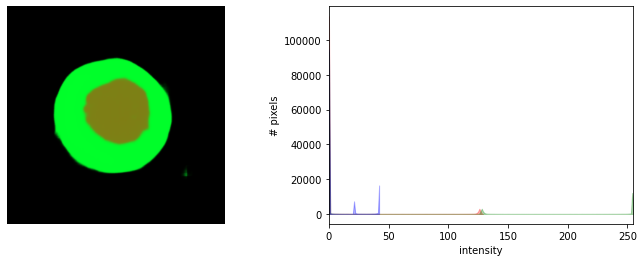

In [ ]:
predictions_l = pred_mice[4].get_predictions('L')

rgb = predictions_l[4]
skdemo.imshow_with_histogram(rgb, xlim=[0,255]);
red = predictions_l[4][...,0]
green = predictions_l[4][...,1]

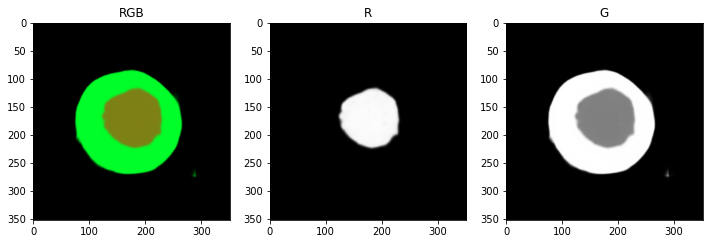

In [ ]:
skdemo.imshow_all(rgb, red, green, titles=['RGB', 'R', 'G'], limits='auto', size=4, )

In [ ]:
thg, gmask = cv2.threshold(green, 40, 255, cv2.THRESH_BINARY)
thr, rmask = cv2.threshold(red, 20, 255, cv2.THRESH_BINARY)

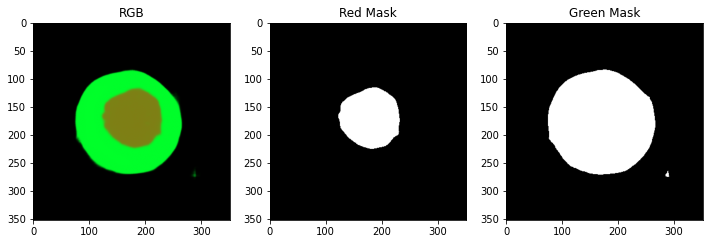

In [ ]:
skdemo.imshow_all(rgb, rmask, gmask, titles=['RGB', 'Red Mask', 'Green Mask'], limits='auto', size=4, )

In [ ]:
nb_components_g, output_g, stats_g, centroids_g = cv2.connectedComponentsWithStats(gmask, connectivity=8)
nb_components_g -= 1 # removes background component
sizes_g = stats_g[1:, -1] # get sizes

Do this for r and g

In [ ]:
print(max(sizes_g))

28231


In [ ]:
# minimum size of particles we want to keep (number of pixels)
#here, it's a fixed value, but you can set it as you want, eg the mean of the sizes or whatever
largest = max(sizes_g)

#your answer image
clean_gmask = np.zeros((output_g.shape))
#for every component in the image, you keep it only if it's above min_size
for i in range(0, nb_components_g):
    if sizes_g[i] == largest:
        clean_gmask[output_g == i + 1] = 255

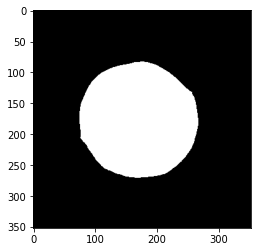

In [ ]:
plt.imshow(clean_gmask)

In [ ]:
clean_gmask.sum() / 255

28231.0

RED

In [ ]:
nb_components_r, output_r, stats_r, centroids_r = cv2.connectedComponentsWithStats(rmask, connectivity=8)
nb_components_r -= 1 # removes background component
sizes_r = stats_r[1:, -1] # get sizes

[x, y, width, height, area]

In [ ]:
print(stats_r) # pick closest to 172 x and y

[[     0      0    352    352 114683]
 [   122    115    110    110   9221]]


In [ ]:
distances = []
for data in stats_r[1:]:
    if data[4] >= 50:
        centroid_x = data[0] + (data[2]/2)
        centroid_y = data[1] + (data[3]/2)

        dist_x = abs(172 - centroid_x)
        dist_y = abs(172 - centroid_y)
        print(dist_x + dist_y)
        distances.append(dist_x + dist_y)
    else:
        distances.append(352)

7.0


In [ ]:
distances

[7.0]

In [ ]:
sizes_r

array([9221], dtype=int32)

In [ ]:
distances.index(min(distances))

0

In [ ]:
# minimum size of particles we want to keep (number of pixels)
#here, it's a fixed value, but you can set it as you want, eg the mean of the sizes or whatever
closest_idx = distances.index(min(distances))
size_closest = sizes_r[closest_idx]


#your answer image
clean_rmask = np.zeros((output_r.shape))
#for every component in the image, you keep it only if it's above min_size
for i in range(0, nb_components_r):
    if sizes_r[i] == size_closest:
        clean_rmask[output_r == i + 1] = 255

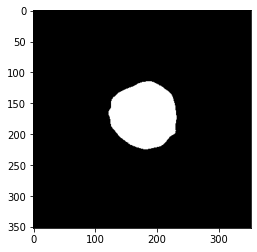

In [ ]:
plt.imshow(clean_rmask)

### Circle stuff (ignore this for now)

In [ ]:
img2 = clean_gmask.astype(np.uint8)
plt.imshow(img2)

In [ ]:
contours, hierarchy = cv2.findContours(img2, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnt = contours[0]

In [ ]:
(x,y), radius = cv2.minEnclosingCircle(cnt)
center = (int(x),int(y))
radius = int(radius)
print(center, radius)

fig,ax = plt.subplots(1)
ax.imshow(img2)
circle = Circle(center, radius, color='b', fill=False)
ax.add_patch(circle)

plt.show()

# Graphs

In [ ]:
def compare_search(baseline, new, percentage, original=False):
    for baseline_mice, new_mice in zip(baseline, new):

        right_base = baseline_mice.right_wounds
        right_new = new_mice.right_wounds
        if (baseline_mice.id != new_mice.id):
            break

        old = []
        new = []
        for r_base, r_new in zip(right_base, right_new):
            old.append(r_base.area)
            new.append(r_new.area)

        fig, ax = plt.subplots()
        plt.title("Post Processing Technique Comparison: " + baseline_mice.id + " (Right)")
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
        try:
            ax.plot(x, old)
        except:
            x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
            ax.plot(x, old)
        ax.plot(x, new)
        if original:
            plt.legend(('Average Ring Substitution', 'Ring Search at ' + percentage))
        else:
            plt.legend(('Ring Search Baseline 75%', 'Ring Search at ' + percentage))
        plt.xlabel('Day')
        plt.ylabel('Area (mm^2)')
        plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + baseline_mice.id + " (Right) " + percentage + " search comparison.pdf")
        plt.show()

        ##### LEFT #####

        left_base = baseline_mice.left_wounds
        left_new = new_mice.left_wounds

        base = []
        new = []
        for l_base, l_new in zip(left_base, left_new):
            base.append(l_base.area)
            new.append(l_new.area)

        fig, ax = plt.subplots()
        plt.title("Post Processing Technique Comparison: " + baseline_mice.id + " (Left)")
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
        try:
            ax.plot(x, base)
        except:
            x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
            ax.plot(x, base)
        ax.plot(x, new)
        if original:
            plt.legend(('Average Ring Substitution', 'Ring Search at ' + percentage))
        else:
            plt.legend(('Ring Search Baseline 75%', 'Ring Search at ' + percentage))
        plt.xlabel('Day')
        plt.ylabel('Area (mm^2)')
        plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + baseline_mice.id + " (Left) " + percentage + " search comparison.pdf")
        plt.show()

#### Cleaning unexpected datapoints

In [ ]:
def has_nonzero_after(values):

    try:
        index = values.index(0)
        try:
            next = values[index + 1]
            if next != 0:
                return index
            else:
                return False
        except:
            return False
    except:
        return False


In [ ]:
for mouse in pred_mice:
    left = mouse.get_areas('L')
    right = mouse.get_areas('R')

    if has_nonzero_after(left):
        i = has_nonzero_after(left)
        print("Averaged: ", mouse.id, 'L', i)

        new_areas = left
        prev = new_areas[i - 1]
        next = new_areas[i + 1]
        avg = (prev + next) / 2

        new_areas[i] = avg

        for i, wound in enumerate(mouse.left_wounds):
            wound.area = new_areas[i]

    if has_nonzero_after(right):
        print('Averaged: ', mouse.id, 'R', has_nonzero_after(right))
        i = has_nonzero_after(right)

        new_areas = right
        prev = new_areas[i - 1]
        next = new_areas[i + 1]
        avg = (prev + next) / 2

        new_areas[i] = avg

        for i, wound in enumerate(mouse.right_wounds):
            wound.area = new_areas[i]


In [ ]:
for mouse in new_tech_mice:
    left = mouse.get_areas('L')
    right = mouse.get_areas('R')

    if has_nonzero_after(left):
        i = has_nonzero_after(left)
        print("Averaged: ", mouse.id, 'L', i)

        new_areas = left
        prev = new_areas[i - 1]
        next = new_areas[i + 1]
        avg = (prev + next) / 2

        new_areas[i] = avg

        for i, wound in enumerate(mouse.left_wounds):
            wound.area = new_areas[i]

    if has_nonzero_after(right):
        print('Averaged: ', mouse.id, 'R', has_nonzero_after(right))
        i = has_nonzero_after(right)

        new_areas = right
        prev = new_areas[i - 1]
        next = new_areas[i + 1]
        avg = (prev + next) / 2

        new_areas[i] = avg

        for i, wound in enumerate(mouse.right_wounds):
            wound.area = new_areas[i]


Recording percentages

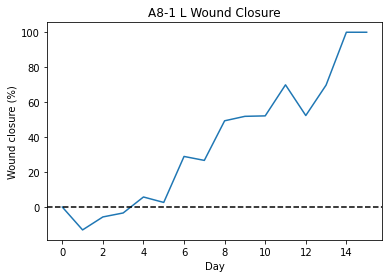

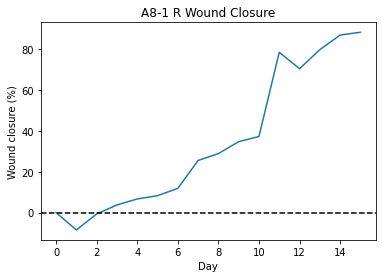

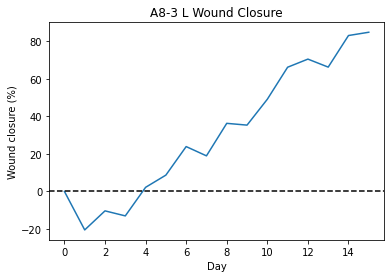

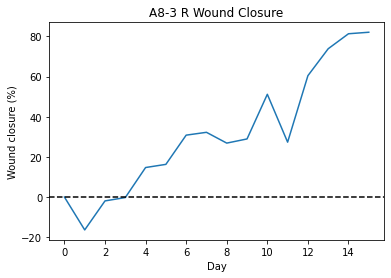

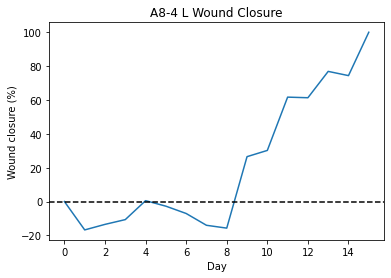

...

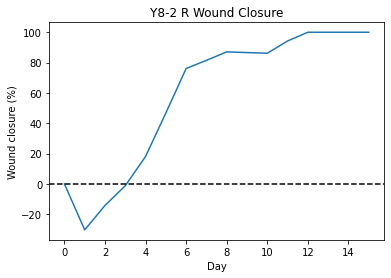

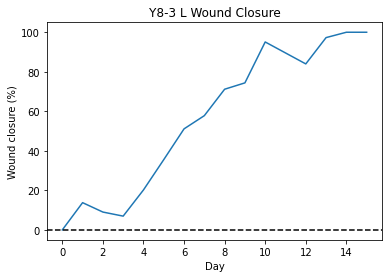

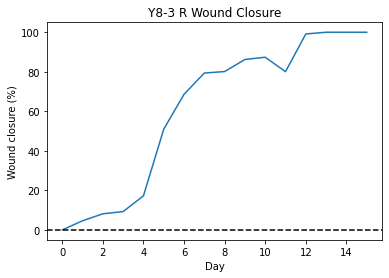

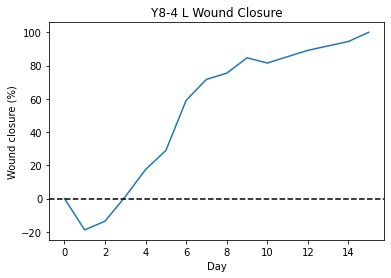

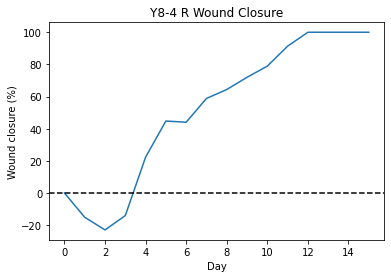

In [ ]:
for mouse in pred_mice:
    mouse_percentage = plot_percentages(mouse, ['L', 'R'], style='Line', save=False, su=False)
    mouse.left_percentages = mouse_percentage[0]
    mouse.right_percentages = mouse_percentage[1]

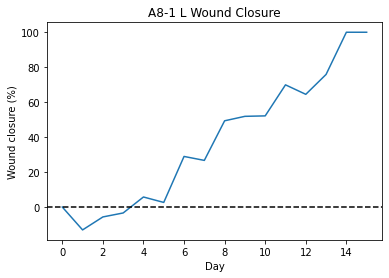

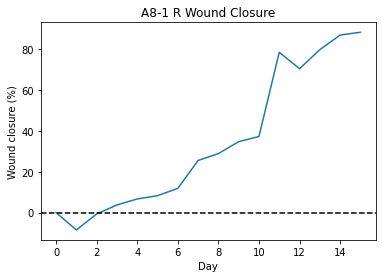

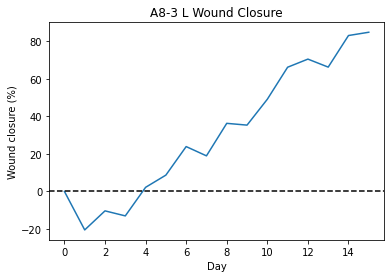

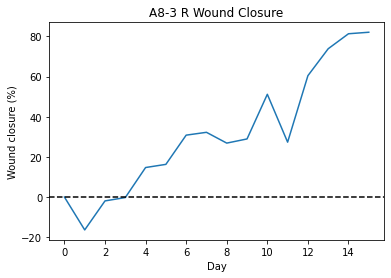

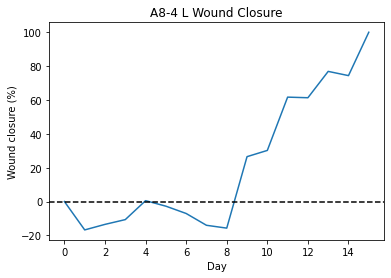

...

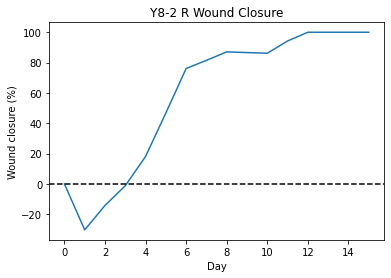

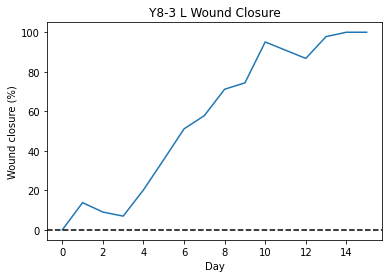

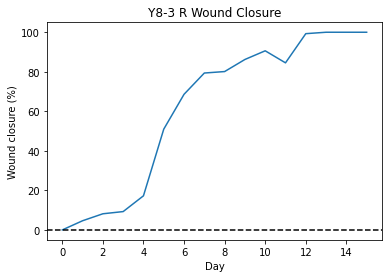

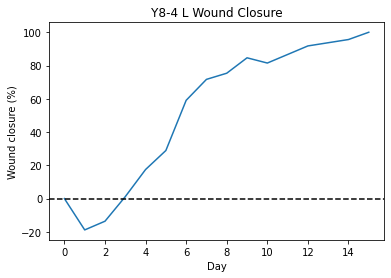

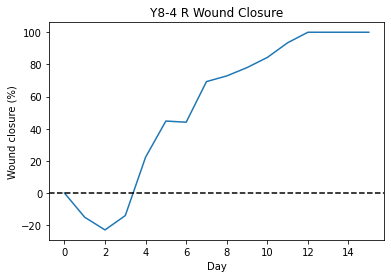

In [ ]:
for mouse in new_tech_mice:
    mouse_percentage = plot_percentages(mouse, ['L', 'R'], style='Line', save=False, su=False)
    mouse.left_percentages = mouse_percentage[0]
    mouse.right_percentages = mouse_percentage[1]

In [ ]:
adult_avg_closure = []
young_avg_closure = []
for mouse in pred_mice:

    if mouse.id[0] == 'A':
        right = mouse.right_percentages
        left = mouse.left_percentages

        temp = []

        for day in range(days):   
            try: 
                sum = (right[day] + left[day]) / 2
                temp.append(sum)
            except:
                print("no reading for day", day, mouse.id)

        adult_avg_closure.append(temp)

    elif mouse.id[0] == 'Y':

        right = mouse.right_percentages
        left = mouse.left_percentages

        temp = []

        for day in range(days):   
            try: 
                sum = (right[day] + left[day]) / 2
                temp.append(sum)
            except:
                print("no reading for day", day, mouse.id)

        young_avg_closure.append(temp)

no reading for day 15 A8-5
no reading for day 15 Y8-2


In [ ]:
a_avg = []
for i in range(days):
    temp = 0
    count = 0
    for j in range(4): # number of adults
        try:
            temp += adult_avg_closure[j][i]
            count += 1
        except:
            print("no reading")
    a_avg.append(temp / count)

no reading


In [ ]:
y_avg = []
for i in range(days):
    temp = 0
    count = 0
    for j in range(4): # number of young 
        try:
            temp += young_avg_closure[j][i]
            count += 1
        except:
            print("no reading")
    y_avg.append(temp / count)

no reading


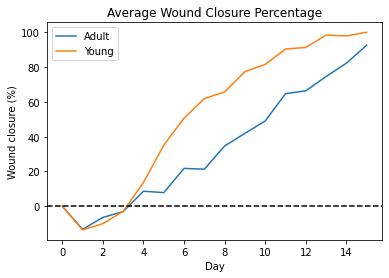

In [ ]:
fig, ax = plt.subplots()
plt.title("Average Wound Closure Percentage")
x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
ax.plot(x, a_avg)
ax.plot(x, y_avg)
ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(('Adult', 'Young'))
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
#plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + mouse.id + " " + 'L & R' + " percentage.pdf")
plt.show()

In [ ]:
output = open("Average Closure.csv","w+")

# Column names:
output.write(("Day" + "," + "Adult Closure %" + "," + "Young Closure %") + "\n")

i = 0
for a, y in zip(a_avg, y_avg):
    output.write((str(i) + "," + str(round(a, 3)) + "," + str(round(y, 3))) + "\n")
    i += 1

output.close()

In [ ]:
avg = pd.read_csv("Average Closure.csv")

In [ ]:
avg

,Day,Adult Closure %,Young Closure %
0,0,0.000,0.000
1,1,-13.245,-13.584
2,2,-6.397,-9.976
3,3,-3.054,-2.916
4,4,8.633,13.651
5,5,7.855,35.054
6,6,21.766,50.625
7,7,21.302,61.891
8,8,34.649,65.705
9,9,41.893,77.362


In [ ]:
output = open("wound_data_new.csv","w+")

# Column names:
output.write(("Mouse ID" + "," + "Day" + "," + "Side" +
              "," + "Predicted area" + "," + 
              "Predicted diameter" + "," + "Closure percentage") + "\n")

for pred_mouse in pred_mice:

    pred_area_l = pred_mouse.get_areas('L')
    pred_area_r = pred_mouse.get_areas('R')
    pred_diameter_l = pred_mouse.get_diameters('L')
    pred_diameter_r = pred_mouse.get_diameters('R')

    closure_l = pred_mouse.left_percentages
    closure_r = pred_mouse.right_percentages

    for day in range(days):
        try:
            output.write((pred_mouse.id + "," + str(day) + "," + "S" + "," 
                          + str(pred_area_l[day]) + "," + str(pred_diameter_l[day])
                          + "," + str(round(closure_l[day], 3)) + "\n"))
        except:
            output.write((pred_mouse.id + "," + str(day) + "," + "S" + "," +
                      "NULL" + "," + "NULL" + "," +
                      "NULL" + "\n"))
            
        try:
            output.write((pred_mouse.id + "," + str(day) + "," + "U" + "," 
                          + str(pred_area_r[day]) + "," + str(pred_diameter_r[day])
                          + "," + str(round(closure_r[day], 3)) + "\n"))
        except:
            output.write((pred_mouse.id + "," + str(day) + "," + "U" + "," +
                      "NULL" + "," + "NULL" + "," +
                      "NULL" + "\n"))

output.close()

In [ ]:
data = pd.read_csv("wound_data_new.csv")

In [ ]:
data

,Mouse ID,Day,Side,Predicted area,Predicted diameter,Closure percentage
0,A8-1,0,S,23.081,5.421,0.000
1,A8-1,0,U,33.307,6.512,0.000
2,A8-1,1,S,26.105,5.765,-13.102
3,A8-1,1,U,36.136,6.783,-8.494
4,A8-1,2,S,24.391,5.573,-5.676
...,...,...,...,...,...,...
251,Y8-4,13,U,0.000,0.000,100.000
252,Y8-4,14,S,1.316,1.294,94.443
253,Y8-4,14,U,0.000,0.000,100.000
254,Y8-4,15,S,0.000,0.000,100.000


### Old vs new technique

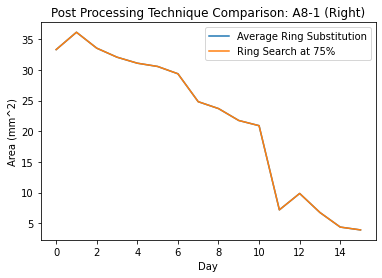

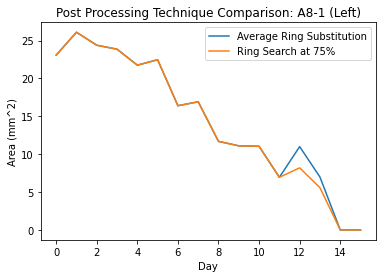

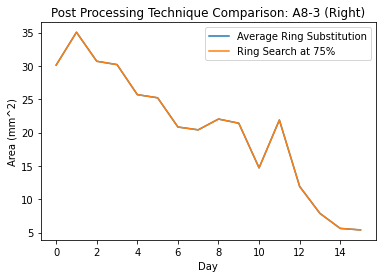

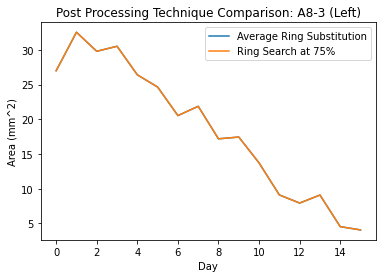

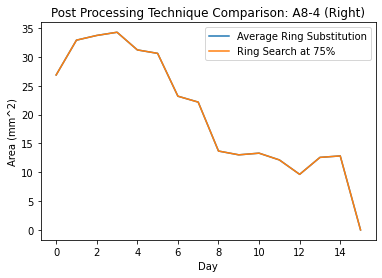

...

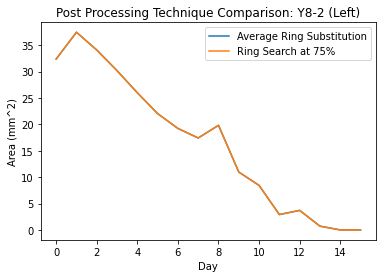

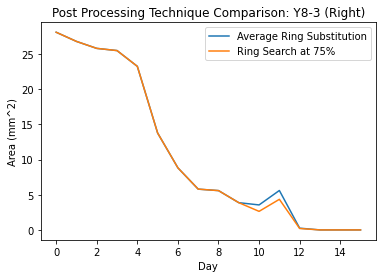

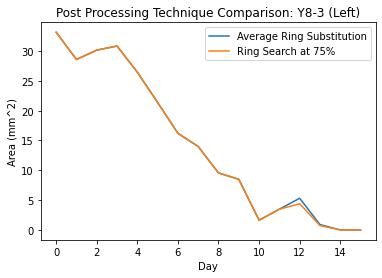

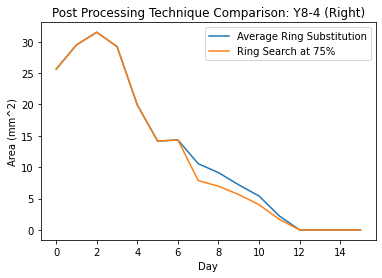

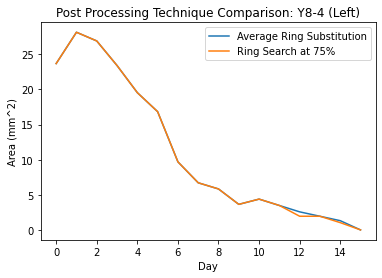

In [ ]:
compare_search(pred_mice, new_tech_mice, "75%", original=True)

#### Now I want to do the same thing, but comparing ring search at 75% with ring search at 70% and so on...

`new_tech_mice` is the baseline results for ring search

`wound_to_ring` is the baseline collection of wound to ring sizes

Down to 50%, plot from 75% to 50% on the same graph for each mouse.

Im gonna need all rings_n and mince_n.

**Delete n days worth of splints in a rolling window, back to front.**

In [ ]:
# helper func Gets dict keys for a particular day
# big func calls this for each day in range
def get_keys(day, wound_to_ring):
    keys = []
    for key, item in wound_to_ring.items():
        if item[1] == day:
            keys.append(key)
    return keys

In [ ]:
# Gets all keys in range in slices by rolling window:
# {range (string): keys ([ints])}
def get_key_range(wound_to_ring, day_range=8, day_num=15):
    key_range = {}
    start = 0
    end = start + day_range - 1

    while (end <= day_num):
        entry = str(start) + "-" + str(end)
        keys = []
        counter = 0
        for day in range(start, end + 1):
            #print(day)
            counter += len(get_keys(day, wound_to_ring))
            keys.extend(get_keys(day, wound_to_ring))
        #print("counter:", counter)
        #print()
        key_range[entry] = keys
        start += 1
        end += 1

    return key_range

In [ ]:
get_key_range(wound_to_ring).keys()

dict_keys(['0-7', '1-8', '2-9', '3-10', '4-11', '5-12', '6-13', '7-14', '8-15'])

In [ ]:
len(get_key_range(wound_to_ring)['0-7']) / 254

0.4921259842519685

In [ ]:
len(get_key_range(wound_to_ring)['8-15']) / 254

0.2677165354330709

In [ ]:
key_range = get_key_range(wound_to_ring)

Putting it all together

In [ ]:
def get_artificial_detections(key_range, wound_to_ring, pred_mice):
    artificial_mice = {}
    for key in key_range.keys():
        deletions = []
        rings = copy.deepcopy(wound_to_ring)
        to_delete = key_range[key]

        for ring in to_delete:
            deletions.append(ring)
            rings.pop(ring)
        
        mice, _ = apply_search_method(pred_mice, rings, deletions)

        artificial_mice[key] = mice

    return artificial_mice

In [ ]:
artificial_detections = get_artificial_detections(key_range, wound_to_ring, pred_mice)

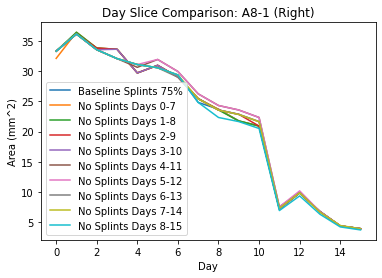

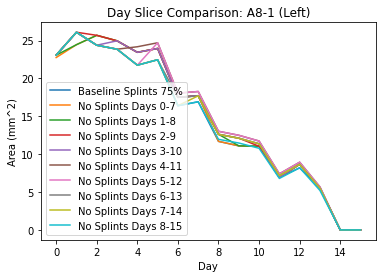

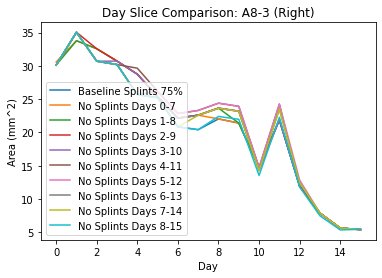

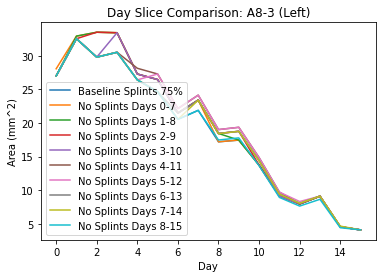

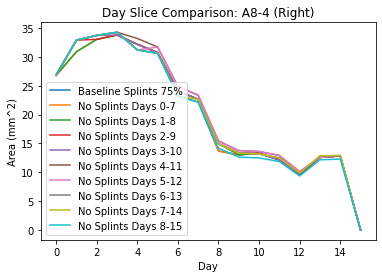

...

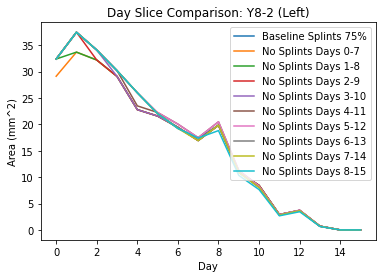

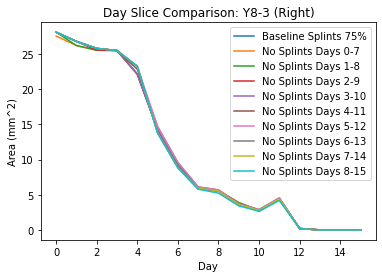

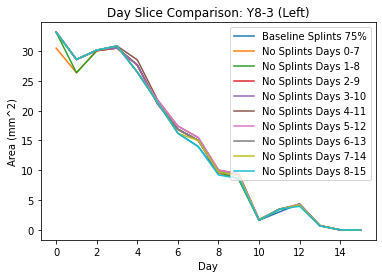

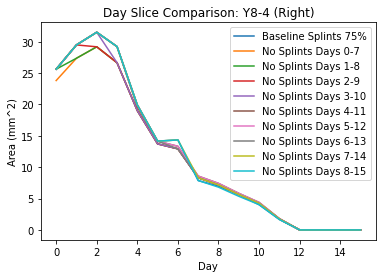

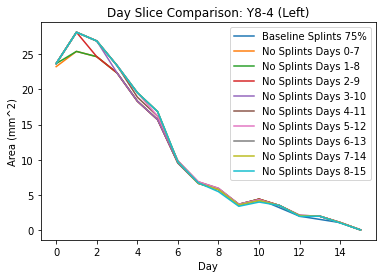

In [ ]:
output = open("Splint Day Range Elimination Experiment.csv","w+")

# Column names:
output.write(("Mouse ID" + "," + "Day" + "," + "Side" + "," + "Area Baseline" +
              "," + "Area No Splints Days 0-7" + "," + "Area No Splints Days 1-8" + "," + 
              "Area No Splints Days 2-9" + "," + "Area No Splints Days 3-10" + "," +
              "Area No Splints Days 4-11" + "," + "Area No Splints Days 5-12" + "," +
              "Area No Splints Days 6-13" + "," +
              "Area No Splints Days 7-14" + "," + "Area No Splints Days 8-15") + "\n")

for i, base_mouse in enumerate(new_tech_mice):

    right_b = base_mouse.right_wounds
    right_07 = artificial_detections['0-7'][i].right_wounds
    right_18 = artificial_detections['1-8'][i].right_wounds
    right_29 = artificial_detections['2-9'][i].right_wounds
    right_310 = artificial_detections['3-10'][i].right_wounds
    right_411 = artificial_detections['4-11'][i].right_wounds
    right_512 = artificial_detections['5-12'][i].right_wounds
    right_613 = artificial_detections['6-13'][i].right_wounds
    right_714 = artificial_detections['7-14'][i].right_wounds
    right_815 = artificial_detections['8-15'][i].right_wounds

    if (base_mouse.id != artificial_detections['0-7'][i].id or artificial_detections['8-15'][i].id != base_mouse.id):
        print("ID ERROR!")
        break

    area_b = []
    area_07 = []
    area_18 = []
    area_29 = []
    area_310 = []
    area_411 = []
    area_512 = []
    area_613 = []
    area_714 = []
    area_815 = []

    for r_b, r_07, r_18, r_29, r_310, r_411, r_512, r_613, r_714, r_815 in zip(right_b, right_07, right_18, right_29, right_310, right_411, right_512, right_613, right_714, right_815):
        area_b.append(r_b.area)
        area_07.append(r_07.area)
        area_18.append(r_18.area)
        area_29.append(r_29.area)
        area_310.append(r_310.area)
        area_411.append(r_411.area)
        area_512.append(r_512.area)
        area_613.append(r_613.area)
        area_714.append(r_714.area)
        area_815.append(r_815.area)

        output.write((base_mouse.id + "," + str(r_b.day) + "," + "Right" + "," + 
              str(round(r_b.area, 3)) + "," + str(round(r_07.area, 3)) + "," + 
              str(round(r_18.area, 3)) + "," + str(round(r_29.area, 3)) + "," +
              str(round(r_310.area, 3)) + "," + str(round(r_411.area, 3)) + "," +
              str(round(r_512.area, 3)) + "," + str(round(r_613.area, 3)) + "," +
              str(round(r_714.area, 3)) + "," + str(round(r_815.area, 3))) + "\n")


    fig, ax = plt.subplots()
    plt.title("Day Slice Comparison: " + base_mouse.id + " (Right)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, area_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, area_b)
    ax.plot(x, area_07)
    ax.plot(x, area_18)
    ax.plot(x, area_29)
    ax.plot(x, area_310)
    ax.plot(x, area_411)
    ax.plot(x, area_512)
    ax.plot(x, area_613)
    ax.plot(x, area_714)
    ax.plot(x, area_815)

    plt.legend(('Baseline Splints 75%', 'No Splints Days 0-7', 'No Splints Days 1-8', 'No Splints Days 2-9', 'No Splints Days 3-10', 'No Splints Days 4-11', 'No Splints Days 5-12', 'No Splints Days 6-13', 'No Splints Days 7-14', 'No Splints Days 8-15'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Right)" + " day slice comparison.pdf")
    plt.show()

    ##### LEFT #####

    left_b = base_mouse.left_wounds
    left_07 = artificial_detections['0-7'][i].left_wounds
    left_18 = artificial_detections['1-8'][i].left_wounds
    left_29 = artificial_detections['2-9'][i].left_wounds
    left_310 = artificial_detections['3-10'][i].left_wounds
    left_411 = artificial_detections['4-11'][i].left_wounds
    left_512 = artificial_detections['5-12'][i].left_wounds
    left_613 = artificial_detections['6-13'][i].left_wounds
    left_714 = artificial_detections['7-14'][i].left_wounds
    left_815 = artificial_detections['8-15'][i].left_wounds

    area_b = []
    area_07 = []
    area_18 = []
    area_29 = []
    area_310 = []
    area_411 = []
    area_512 = []
    area_613 = []
    area_714 = []
    area_815 = []

    for l_b, l_07, l_18, l_29, l_310, l_411, l_512, l_613, l_714, l_815 in zip(left_b, left_07, left_18, left_29, left_310, left_411, left_512, left_613, left_714, left_815):
        area_b.append(l_b.area)
        area_07.append(l_07.area)
        area_18.append(l_18.area)
        area_29.append(l_29.area)
        area_310.append(l_310.area)
        area_411.append(l_411.area)
        area_512.append(l_512.area)
        area_613.append(l_613.area)
        area_714.append(l_714.area)
        area_815.append(l_815.area)

        output.write((base_mouse.id + "," + str(l_b.day) + "," + "Left" + "," + 
              str(round(l_b.area, 3)) + "," + str(round(l_07.area, 3)) + "," + 
              str(round(l_18.area, 3)) + "," + str(round(l_29.area, 3)) + "," +
              str(round(l_310.area, 3)) + "," + str(round(l_411.area, 3)) + "," +
              str(round(l_512.area, 3)) + "," + str(round(l_613.area, 3)) + "," +
              str(round(l_714.area, 3)) + "," + str(round(l_815.area, 3))) + "\n")

    fig, ax = plt.subplots()
    plt.title("Day Slice Comparison: " + base_mouse.id + " (Left)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, area_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, area_b)
    ax.plot(x, area_07)
    ax.plot(x, area_18)
    ax.plot(x, area_29)
    ax.plot(x, area_310)
    ax.plot(x, area_411)
    ax.plot(x, area_512)
    ax.plot(x, area_613)
    ax.plot(x, area_714)
    ax.plot(x, area_815)

    plt.legend(('Baseline Splints 75%', 'No Splints Days 0-7', 'No Splints Days 1-8', 'No Splints Days 2-9', 'No Splints Days 3-10', 'No Splints Days 4-11', 'No Splints Days 5-12', 'No Splints Days 6-13', 'No Splints Days 7-14', 'No Splints Days 8-15'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Left)" + " day slice comparison.pdf")
    plt.show()

output.close()

In [ ]:
pwd

'/content/drive/.shortcut-targets-by-id/175Vkdh2mGaZ7CZsZetvNssl0puand1tS/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Semantic-Shapes'

### Original random sample

In [ ]:
deletions_70 = []
ring_70 = copy.deepcopy(wound_to_ring)
to_delete = random.sample(list(ring_70.keys()), k = 1 * 13)

for key in to_delete:
    deletions_70.append(key)
    ring_70.pop(key) # Always get current one

In [ ]:
mice_70, changes_70 = apply_search_method(pred_mice, ring_70, deletions_70)

In [ ]:
deletions_65 = []
ring_65 = copy.deepcopy(wound_to_ring)
to_delete = random.sample(list(ring_65.keys()), k = 2 * 13)

for key in to_delete:
    deletions_65.append(key)
    ring_65.pop(key) # Always get current one

In [ ]:
mice_65, changes_65 = apply_search_method(pred_mice, ring_65, deletions_65)

In [ ]:
deletions_60 = []
ring_60 = copy.deepcopy(wound_to_ring)
to_delete = random.sample(list(ring_60.keys()), k = 3 * 13)

for key in to_delete:
    deletions_60.append(key)
    ring_60.pop(key) # Always get current one

In [ ]:
mice_60, changes_60 = apply_search_method(pred_mice, ring_60, deletions_60)

In [ ]:
deletions_55 = []
ring_55 = copy.deepcopy(wound_to_ring)
to_delete = random.sample(list(ring_55.keys()), k = 4 * 13)

for key in to_delete:
    deletions_55.append(key)
    ring_55.pop(key) # Always get current one

In [ ]:
mice_55, changes_55 = apply_search_method(pred_mice, ring_55, deletions_55)

In [ ]:
deletions_50 = []
ring_50 = copy.deepcopy(wound_to_ring)
to_delete = random.sample(list(ring_50.keys()), k = 5 * 13)

for key in to_delete:
    deletions_50.append(key)
    ring_50.pop(key) # Always get current one

In [ ]:
mice_50, changes_50 = apply_search_method(pred_mice, ring_50, deletions_50)

Plots and write

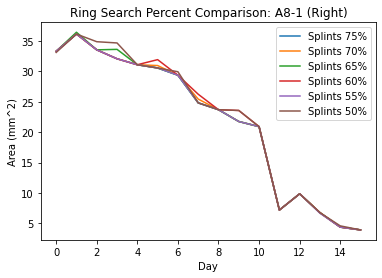

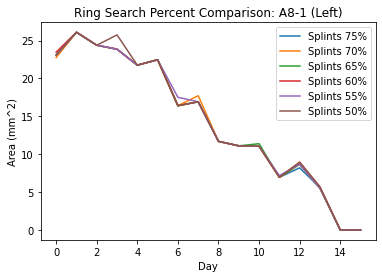

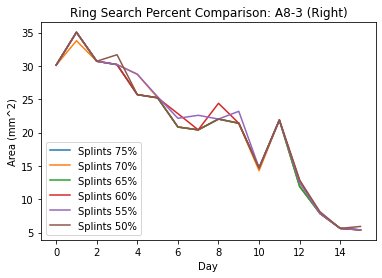

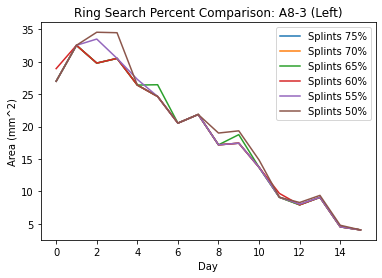

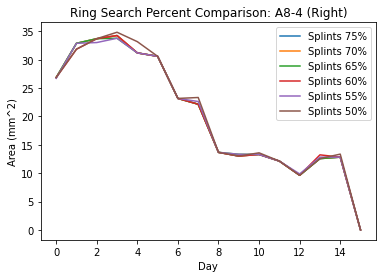

...

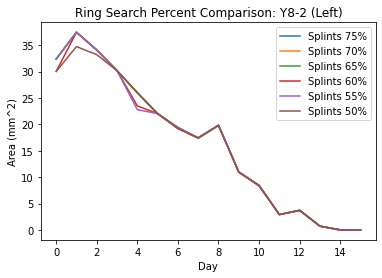

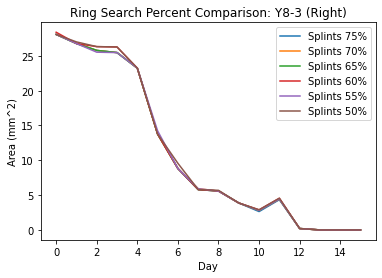

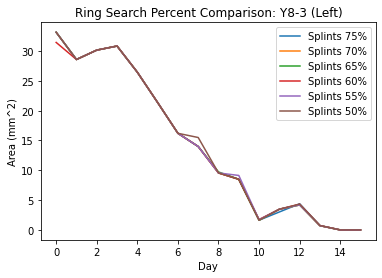

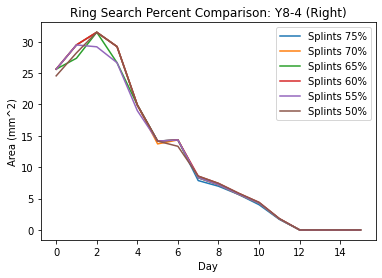

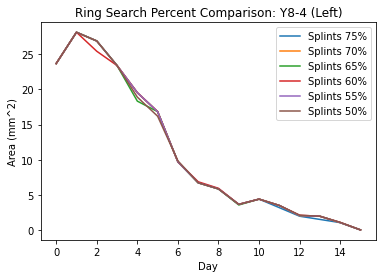

In [ ]:
output = open("Ring Change Experiment.csv","w+")

# Column names:
output.write(("Mouse ID" + "," + "Day" + "," + "Side" +
              "," + "Area 75%" + "," + "Area 70%" + "," + 
              "Area 65%" + "," + "Area 60%" + "," +
              "Area 55%" + "," + "Area 50%") + "\n")

for base_mouse, mouse_70, mouse_65, mouse_60, mouse_55, mouse_50 in zip(new_tech_mice, mice_70, mice_65, mice_60, mice_55, mice_50):

    right_b = base_mouse.right_wounds
    right_70 = mouse_70.right_wounds
    right_65 = mouse_65.right_wounds
    right_60 = mouse_60.right_wounds
    right_55 = mouse_55.right_wounds
    right_50 = mouse_50.right_wounds

    if (base_mouse.id != mouse_70.id):
        break

    area_b = []
    area_70 = []
    area_65 = []
    area_60 = []
    area_55 = []
    area_50 = []

    for r_b, r_70, r_65, r_60, r_55, r_50 in zip(right_b, right_70, right_65, right_60, right_55, right_50):
        area_b.append(r_b.area)
        area_70.append(r_70.area)
        area_65.append(r_65.area)
        area_60.append(r_60.area)
        area_55.append(r_55.area)
        area_50.append(r_50.area)

        output.write((base_mouse.id + "," + str(r_b.day) + "," + "Right" + "," + 
              str(round(r_b.area, 3)) + "," + str(round(r_70.area, 3)) + "," + 
              str(round(r_65.area, 3)) + "," + str(round(r_60.area, 3)) + "," +
              str(round(r_55.area, 3)) + "," + str(round(r_50.area, 3))) + "\n")


    fig, ax = plt.subplots()
    plt.title("Ring Search Percent Comparison: " + base_mouse.id + " (Right)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, area_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, area_b)
    ax.plot(x, area_70)
    ax.plot(x, area_65)
    ax.plot(x, area_60)
    ax.plot(x, area_55)
    ax.plot(x, area_50)

    plt.legend(('Splints 75%', 'Splints 70%', 'Splints 65%', 'Splints 60%', 'Splints 55%', 'Splints 50%'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Right)" + " search comparison.pdf")
    plt.show()

    ##### LEFT #####

    left_b = base_mouse.left_wounds
    left_70 = mouse_70.left_wounds
    left_65 = mouse_65.left_wounds
    left_60 = mouse_60.left_wounds
    left_55 = mouse_55.left_wounds
    left_50 = mouse_50.left_wounds

    area_b = []
    area_70 = []
    area_65 = []
    area_60 = []
    area_55 = []
    area_50 = []

    for l_b, l_70, l_65, l_60, l_55, l_50 in zip(left_b, left_70, left_65, left_60, left_55, left_50):
        area_b.append(l_b.area)
        area_70.append(l_70.area)
        area_65.append(l_65.area)
        area_60.append(l_60.area)
        area_55.append(l_55.area)
        area_50.append(l_50.area)

        output.write((base_mouse.id + "," + str(l_b.day) + "," + "Left" + "," + 
              str(round(l_b.area, 3)) + "," + str(round(l_70.area, 3)) + "," + 
              str(round(l_65.area, 3)) + "," + str(round(l_60.area, 3)) + "," +
              str(round(l_55.area, 3)) + "," + str(round(l_50.area, 3))) + "\n")

    fig, ax = plt.subplots()
    plt.title("Ring Search Percent Comparison: " + base_mouse.id + " (Left)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, area_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, area_b)
    ax.plot(x, area_70)
    ax.plot(x, area_65)
    ax.plot(x, area_60)
    ax.plot(x, area_55)
    ax.plot(x, area_50)

    plt.legend(('Splints 75%', 'Splints 70%', 'Splints 65%', 'Splints 60%', 'Splints 55%', 'Splints 50%'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Left)" + " search comparison.pdf")
    plt.show()

output.close()

In [ ]:
%pwd

'/content/drive/.shortcut-targets-by-id/175Vkdh2mGaZ7CZsZetvNssl0puand1tS/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Semantic-Shapes'

## Now with the original post processing

In [ ]:
def apply_average_method(in_mice, deletions, average=22442.37401574803):

    changes = {}
    mice = copy.deepcopy(in_mice)
    for mouse in mice:
        left = mouse.left_wounds
        right = mouse.right_wounds

        for left_wound, right_wound in zip(left, right):
            
            if left_wound.wound_size in deletions:

                left_wound.ring_size = average
                ratio = left_wound.wound_size / average
                green_area = np.pi * (5**2) # known
                wound_area = round((ratio * green_area), 3)
                wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

                left_wound.area = wound_area
                left_wound.diameter = wound_diameter

            if right_wound.wound_size in deletions:

                right_wound.ring_size == average

                ratio = right_wound.wound_size / average
                green_area = np.pi * (5**2) # known
                wound_area = round((ratio * green_area), 3)
                wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

                right_wound.area = wound_area
                right_wound.diameter = wound_diameter

    return mice

In [ ]:
avg_70 = apply_average_method(pred_mice, deletions_70, dataset_g_avg)

In [ ]:
avg_65 = apply_average_method(pred_mice, deletions_65, dataset_g_avg)

In [ ]:
avg_60 = apply_average_method(pred_mice, deletions_60, dataset_g_avg)

In [ ]:
avg_55 = apply_average_method(pred_mice, deletions_55, dataset_g_avg)

In [ ]:
avg_50 = apply_average_method(pred_mice, deletions_50, dataset_g_avg)

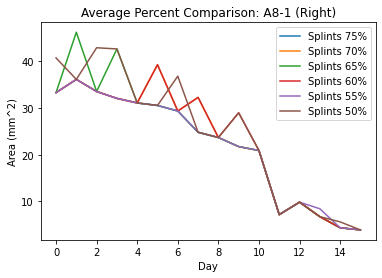

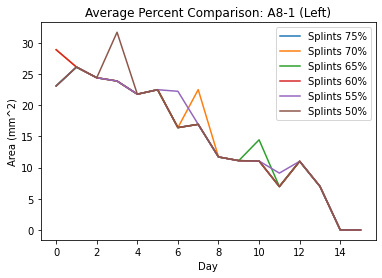

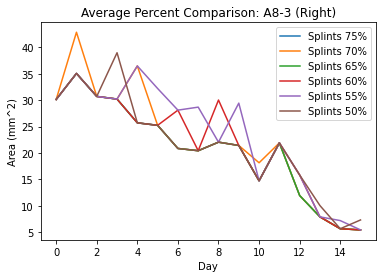

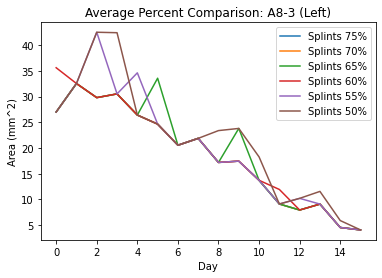

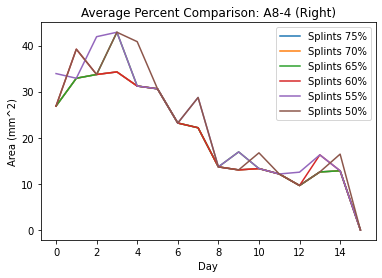

...

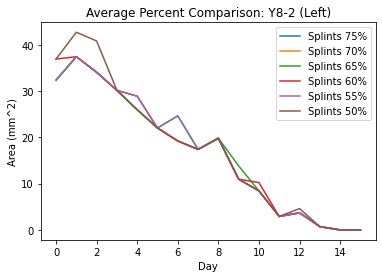

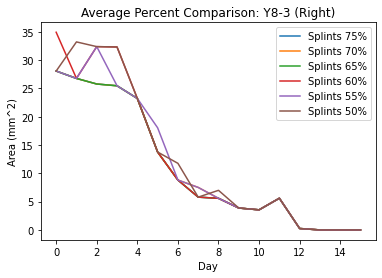

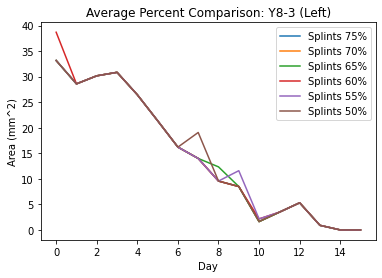

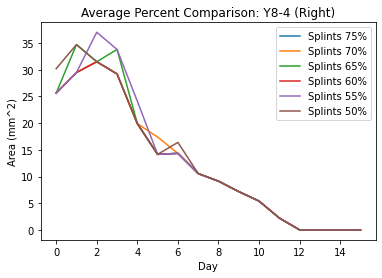

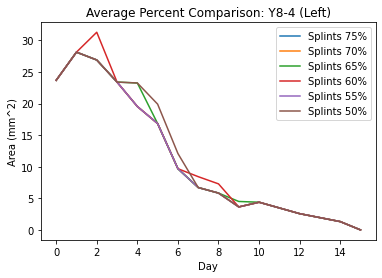

In [ ]:
output = open("Average Change Experiment.csv","w+")

# Column names:
output.write(("Mouse ID" + "," + "Day" + "," + "Side" +
              "," + "Average 25%" + "," + "Average 30%" + "," + 
              "Average 35%" + "," + "Average 40%" + "," +
              "Average 45%" + "," + "Average 50%") + "\n")

for base_mouse, mouse_70, mouse_65, mouse_60, mouse_55, mouse_50 in zip(pred_mice, avg_70, avg_65, avg_60, avg_55, avg_50):

    right_b = base_mouse.right_wounds
    right_70 = mouse_70.right_wounds
    right_65 = mouse_65.right_wounds
    right_60 = mouse_60.right_wounds
    right_55 = mouse_55.right_wounds
    right_50 = mouse_50.right_wounds

    if (base_mouse.id != mouse_70.id):
        break

    area_b = []
    area_70 = []
    area_65 = []
    area_60 = []
    area_55 = []
    area_50 = []

    for r_b, r_70, r_65, r_60, r_55, r_50 in zip(right_b, right_70, right_65, right_60, right_55, right_50):
        area_b.append(r_b.area)
        area_70.append(r_70.area)
        area_65.append(r_65.area)
        area_60.append(r_60.area)
        area_55.append(r_55.area)
        area_50.append(r_50.area)

        output.write((base_mouse.id + "," + str(r_b.day) + "," + "Right" + "," + 
              str(round(r_b.area, 3)) + "," + str(round(r_70.area, 3)) + "," + 
              str(round(r_65.area, 3)) + "," + str(round(r_60.area, 3)) + "," +
              str(round(r_55.area, 3)) + "," + str(round(r_50.area, 3))) + "\n")


    fig, ax = plt.subplots()
    plt.title("Average Percent Comparison: " + base_mouse.id + " (Right)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, area_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, area_b)
    ax.plot(x, area_70)
    ax.plot(x, area_65)
    ax.plot(x, area_60)
    ax.plot(x, area_55)
    ax.plot(x, area_50)

    plt.legend(('Splints 75%', 'Splints 70%', 'Splints 65%', 'Splints 60%', 'Splints 55%', 'Splints 50%'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Right)" + " average comparison.pdf")
    plt.show()

    ##### LEFT #####

    left_b = base_mouse.left_wounds
    left_70 = mouse_70.left_wounds
    left_65 = mouse_65.left_wounds
    left_60 = mouse_60.left_wounds
    left_55 = mouse_55.left_wounds
    left_50 = mouse_50.left_wounds

    area_b = []
    area_70 = []
    area_65 = []
    area_60 = []
    area_55 = []
    area_50 = []

    i = 0
    for l_b, l_70, l_65, l_60, l_55, l_50 in zip(left_b, left_70, left_65, left_60, left_55, left_50):
        area_b.append(l_b.area)
        area_70.append(l_70.area)
        area_65.append(l_65.area)
        area_60.append(l_60.area)
        area_55.append(l_55.area)
        area_50.append(l_50.area)

        output.write((base_mouse.id + "," + str(l_b.day) + "," + "Left" + "," + 
              str(round(l_b.area, 3)) + "," + str(round(l_70.area, 3)) + "," + 
              str(round(l_65.area, 3)) + "," + str(round(l_60.area, 3)) + "," +
              str(round(l_55.area, 3)) + "," + str(round(l_50.area, 3))) + "\n")

    fig, ax = plt.subplots()
    plt.title("Average Percent Comparison: " + base_mouse.id + " (Left)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, area_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, area_b)
    ax.plot(x, area_70)
    ax.plot(x, area_65)
    ax.plot(x, area_60)
    ax.plot(x, area_55)
    ax.plot(x, area_50)

    plt.legend(('Splints 75%', 'Splints 70%', 'Splints 65%', 'Splints 60%', 'Splints 55%', 'Splints 50%'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Left)" + " average comparison.pdf")
    plt.show()

output.close()

### PERCENTAGE CLOSED **TODO**

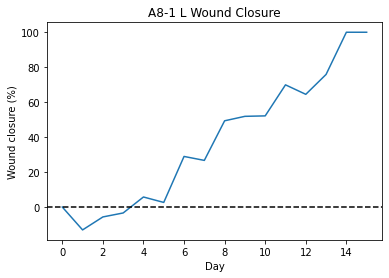

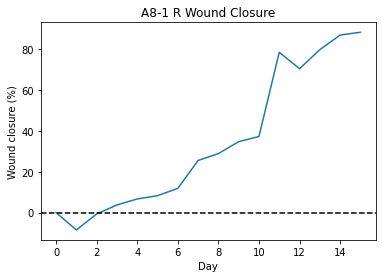

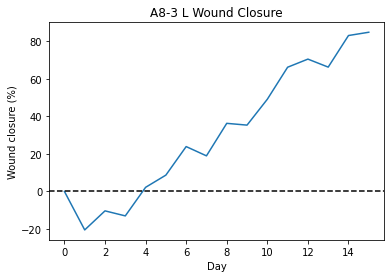

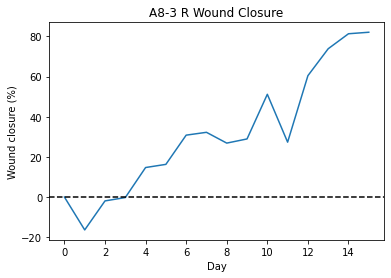

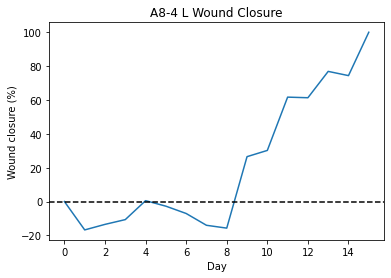

...

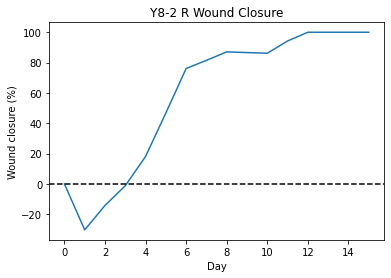

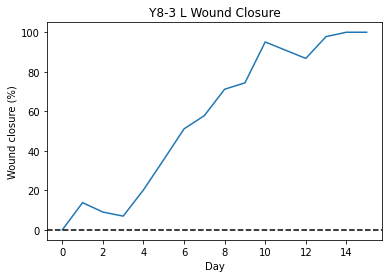

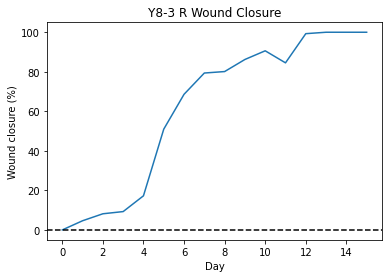

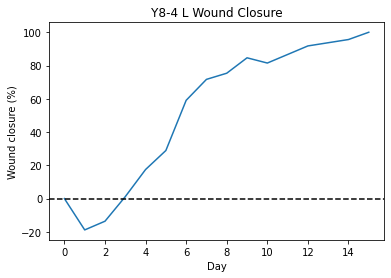

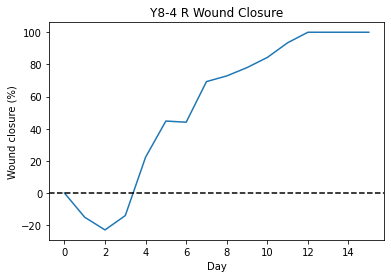

In [ ]:
for mouse in new_tech_mice:
    mouse_percentage = plot_percentages(mouse, ['L', 'R'], style='Line', save=False, su=False)
    mouse.left_percentages = mouse_percentage[0]
    mouse.right_percentages = mouse_percentage[1]

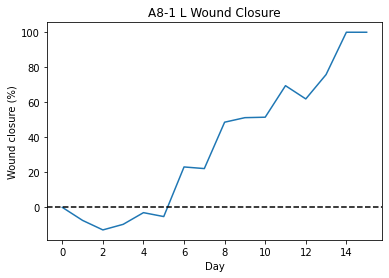

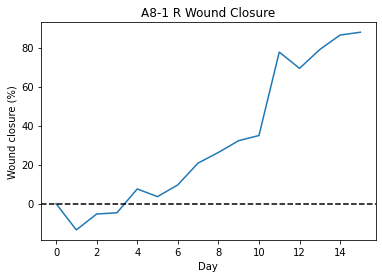

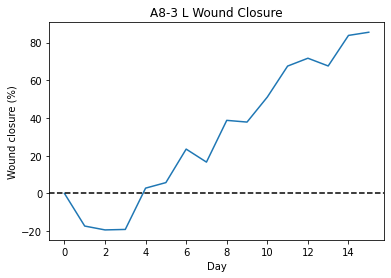

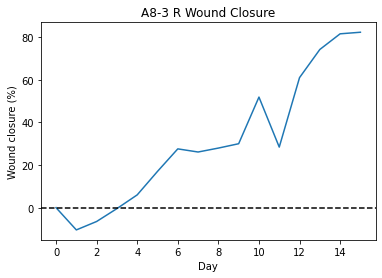

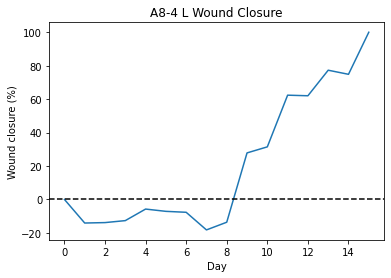

...

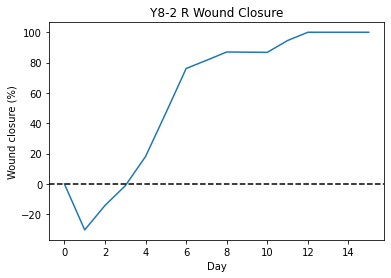

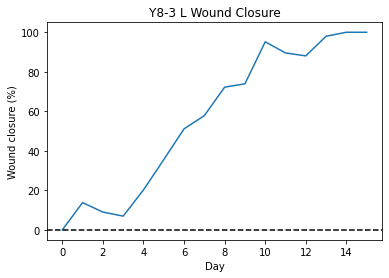

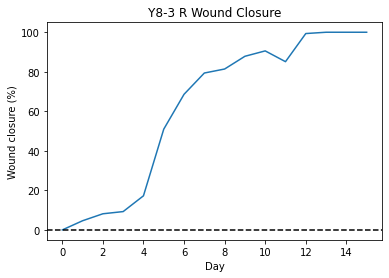

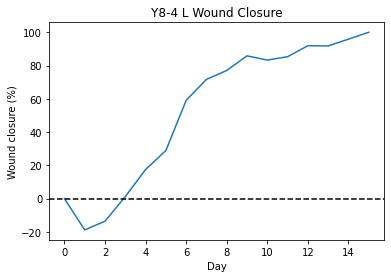

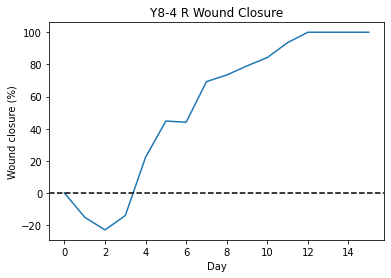

In [ ]:
for day, detections in artificial_detections.items():
    for mouse in detections:
        mouse_percentage = plot_percentages(mouse, ['L', 'R'], style='Line', save=False, su=False)
        mouse.left_percentages = mouse_percentage[0]
        mouse.right_percentages = mouse_percentage[1]

In [ ]:
len(wound_to_ring) / 254

0.7598425196850394

In [ ]:
(len(wound_to_ring) - len(get_key_range(wound_to_ring)['0-7'])) / 254

0.2677165354330709

In [ ]:
(len(wound_to_ring) - len(get_key_range(wound_to_ring)['1-8'])) / 254

0.2755905511811024

In [ ]:
(len(wound_to_ring) - len(get_key_range(wound_to_ring)['2-9'])) / 254

0.2874015748031496

In [ ]:
(len(wound_to_ring) - len(get_key_range(wound_to_ring)['3-10'])) / 254

0.3031496062992126

In [ ]:
(len(wound_to_ring) - len(get_key_range(wound_to_ring)['4-11'])) / 254

0.3346456692913386

In [ ]:
(len(wound_to_ring) - len(get_key_range(wound_to_ring)['5-12'])) / 254

0.3700787401574803

In [ ]:
(len(wound_to_ring) - len(get_key_range(wound_to_ring)['6-13'])) / 254

0.40551181102362205

In [ ]:
(len(wound_to_ring) - len(get_key_range(wound_to_ring)['7-14'])) / 254

0.44881889763779526

In [ ]:
(len(wound_to_ring) - len(get_key_range(wound_to_ring)['8-15'])) / 254

0.4921259842519685

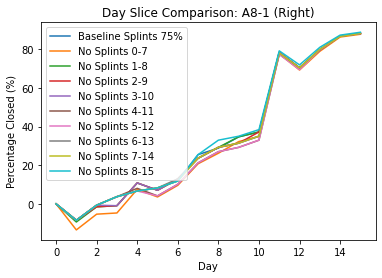

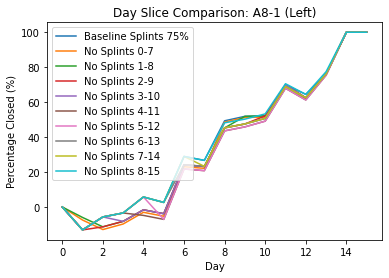

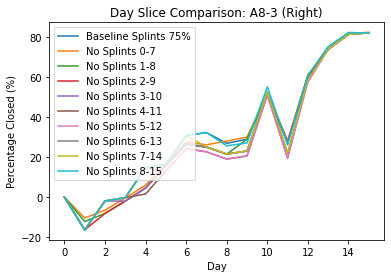

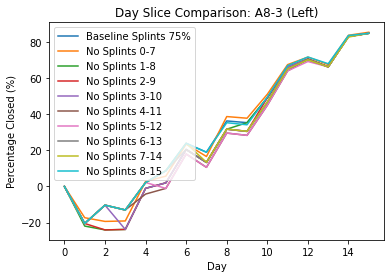

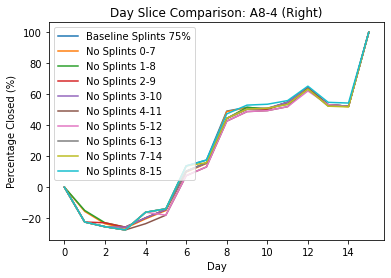

...

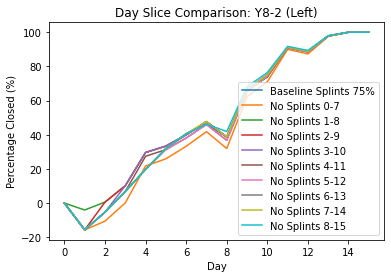

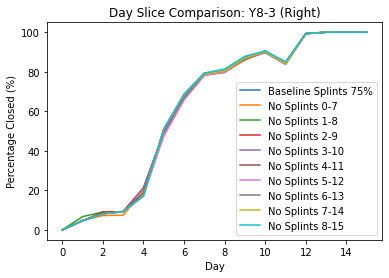

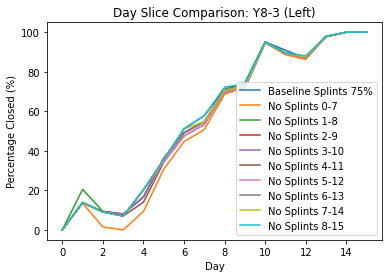

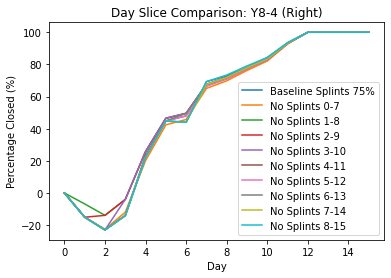

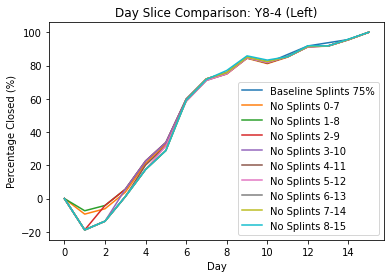

In [ ]:
output = open("Splint Day Range Elimination Experiment (Percentage Closed).csv","w+")

# Column names:
output.write(("Mouse ID" + "," + "Day" + "," + "Side" + "," + "Baseline (76% Splinted)" +
              "," + "No Splints 0-7 (27% Splinted)" + "," + "No Splints 1-8 (28% Splinted)" + "," + 
              "No Splints 2-9 (29% Splinted)" + "," + "No Splints 3-10 (30% Splinted)" + "," +
              "No Splints 4-11 (33% Splinted)" + "," + "No Splints 5-12 (37% Splinted)" + "," +
              "No Splints 6-13 (41% Splinted)" + "," +
              "No Splints 7-14 (45% Splinted)" + "," + "No Splints 8-15 (49% Splinted)") + "\n")

for i, base_mouse in enumerate(new_tech_mice):

    right_b = base_mouse.right_percentages
    right_07 = artificial_detections['0-7'][i].right_percentages
    right_18 = artificial_detections['1-8'][i].right_percentages
    right_29 = artificial_detections['2-9'][i].right_percentages
    right_310 = artificial_detections['3-10'][i].right_percentages
    right_411 = artificial_detections['4-11'][i].right_percentages
    right_512 = artificial_detections['5-12'][i].right_percentages
    right_613 = artificial_detections['6-13'][i].right_percentages
    right_714 = artificial_detections['7-14'][i].right_percentages
    right_815 = artificial_detections['8-15'][i].right_percentages

    if (base_mouse.id != artificial_detections['0-7'][i].id or artificial_detections['8-15'][i].id != base_mouse.id):
        print("ID ERROR!")
        break

    j = 0
    for r_b, r_07, r_18, r_29, r_310, r_411, r_512, r_613, r_714, r_815 in zip(right_b, right_07, right_18, right_29, right_310, right_411, right_512, right_613, right_714, right_815):

        output.write((base_mouse.id + "," + str(j) + "," + "Right" + "," + 
              str(round(r_b, 3)) + "," + str(round(r_07, 3)) + "," + 
              str(round(r_18, 3)) + "," + str(round(r_29, 3)) + "," +
              str(round(r_310, 3)) + "," + str(round(r_411, 3)) + "," +
              str(round(r_512, 3)) + "," + str(round(r_613, 3)) + "," +
              str(round(r_714, 3)) + "," + str(round(r_815, 3))) + "\n")
        j += 1


    fig, ax = plt.subplots()
    plt.title("Day Slice Comparison: " + base_mouse.id + " (Right)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, right_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, right_b)
    ax.plot(x, right_07)
    ax.plot(x, right_18)
    ax.plot(x, right_29)
    ax.plot(x, right_310)
    ax.plot(x, right_411)
    ax.plot(x, right_512)
    ax.plot(x, right_613)
    ax.plot(x, right_714)
    ax.plot(x, right_815)

    plt.legend(('Baseline Splints 75%', 'No Splints 0-7', 'No Splints 1-8', 'No Splints 2-9', 'No Splints 3-10', 'No Splints 4-11', 'No Splints 5-12', 'No Splints 6-13', 'No Splints 7-14', 'No Splints 8-15'))
    plt.xlabel('Day')
    plt.ylabel('Percentage Closed (%)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Right)" + " day slice comparison (percentage closed).pdf")
    plt.show()

    ##### LEFT #####

    left_b = base_mouse.left_percentages
    left_07 = artificial_detections['0-7'][i].left_percentages
    left_18 = artificial_detections['1-8'][i].left_percentages
    left_29 = artificial_detections['2-9'][i].left_percentages
    left_310 = artificial_detections['3-10'][i].left_percentages
    left_411 = artificial_detections['4-11'][i].left_percentages
    left_512 = artificial_detections['5-12'][i].left_percentages
    left_613 = artificial_detections['6-13'][i].left_percentages
    left_714 = artificial_detections['7-14'][i].left_percentages
    left_815 = artificial_detections['8-15'][i].left_percentages

    j = 0
    for l_b, l_07, l_18, l_29, l_310, l_411, l_512, l_613, l_714, l_815 in zip(left_b, left_07, left_18, left_29, left_310, left_411, left_512, left_613, left_714, left_815):

        output.write((base_mouse.id + "," + str(j) + "," + "Left" + "," + 
              str(round(l_b, 3)) + "," + str(round(l_07, 3)) + "," + 
              str(round(l_18, 3)) + "," + str(round(l_29, 3)) + "," +
              str(round(l_310, 3)) + "," + str(round(l_411, 3)) + "," +
              str(round(l_512, 3)) + "," + str(round(l_613, 3)) + "," +
              str(round(l_714, 3)) + "," + str(round(l_815, 3))) + "\n")
        j += 1

    fig, ax = plt.subplots()
    plt.title("Day Slice Comparison: " + base_mouse.id + " (Left)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, left_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, right_b)
    ax.plot(x, left_07)
    ax.plot(x, left_18)
    ax.plot(x, left_29)
    ax.plot(x, left_310)
    ax.plot(x, left_411)
    ax.plot(x, left_512)
    ax.plot(x, left_613)
    ax.plot(x, left_714)
    ax.plot(x, left_815)

    plt.legend(('Baseline Splints 75%', 'No Splints 0-7', 'No Splints 1-8', 'No Splints 2-9', 'No Splints 3-10', 'No Splints 4-11', 'No Splints 5-12', 'No Splints 6-13', 'No Splints 7-14', 'No Splints 8-15'))
    plt.xlabel('Day')
    plt.ylabel('Percentage Closed (%)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Left)" + " day slice comparison (percentage closed).pdf")
    plt.show()

output.close()

Adding percentage closed

In [ ]:
ring_search_mice = [new_tech_mice, mice_70, mice_65, mice_60, mice_55, mice_50]

In [ ]:
ring_search_mice[0][0].left_percentages[0]

0.0

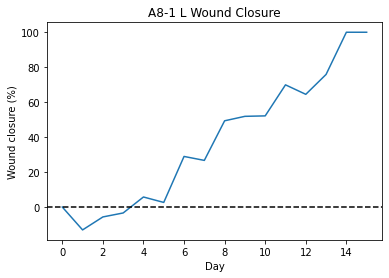

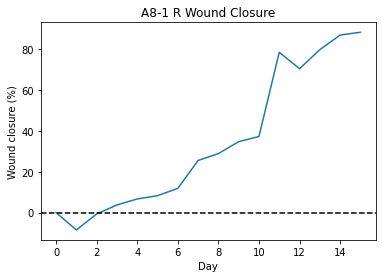

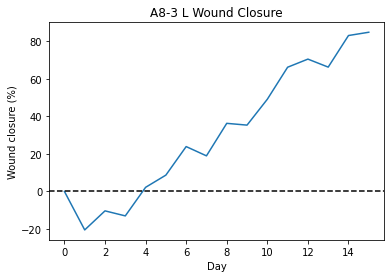

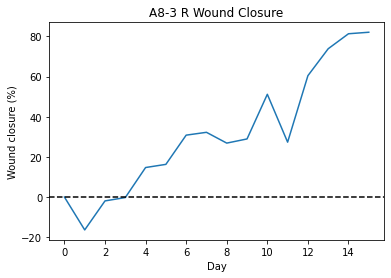

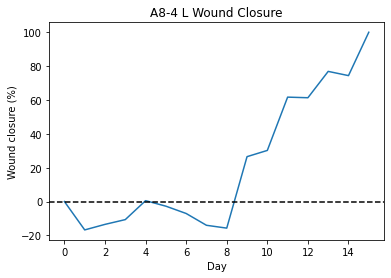

...

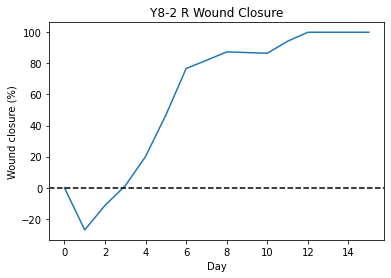

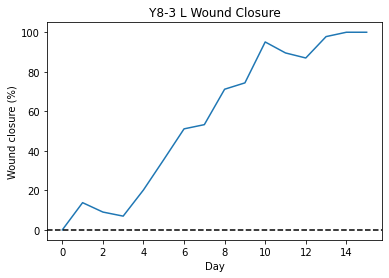

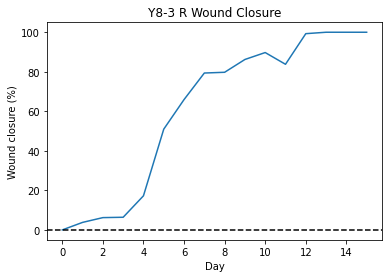

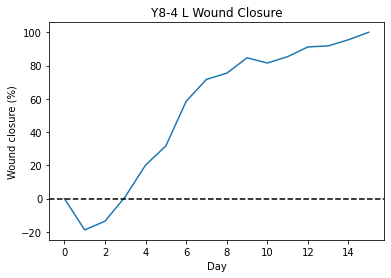

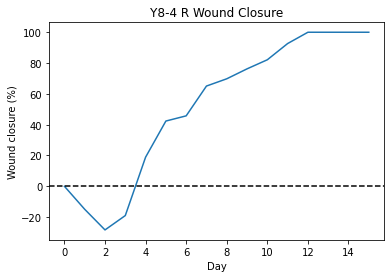

In [ ]:
for mice in ring_search_mice:
    for mouse in mice:
        mouse_percentage = plot_percentages(mouse, ['L', 'R'], style='Line', save=False, su=False)
        mouse.left_percentages = mouse_percentage[0]
        mouse.right_percentages = mouse_percentage[1]

In [ ]:
avg_mice = [pred_mice, avg_70, avg_65, avg_60, avg_55, avg_50]

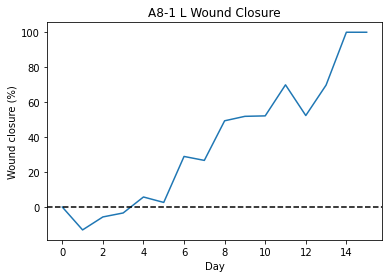

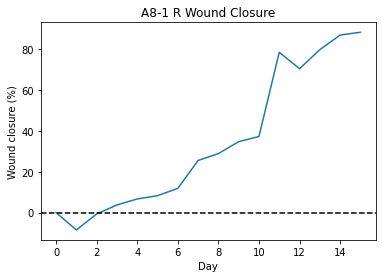

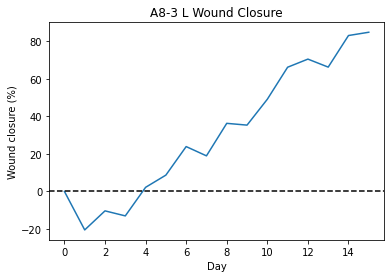

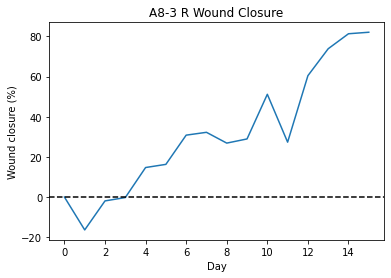

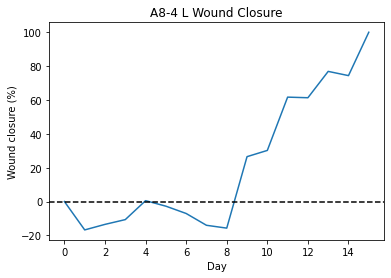

...

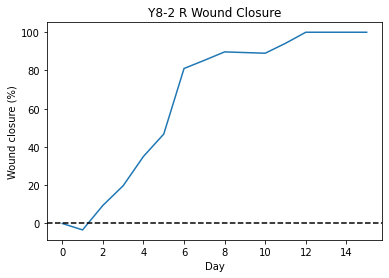

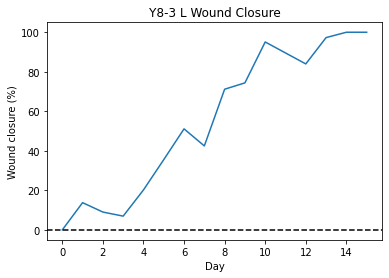

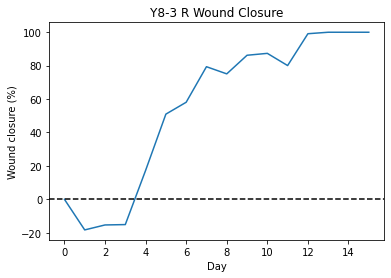

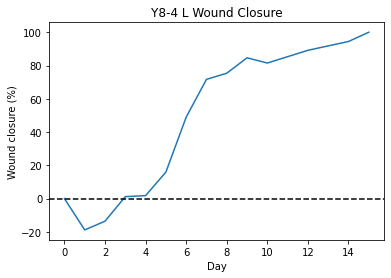

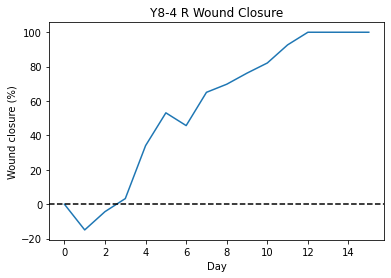

In [ ]:
for mice in avg_mice:
    for mouse in mice:
        mouse_percentage = plot_percentages(mouse, ['L', 'R'], style='Line', save=False, su=False)
        mouse.left_percentages = mouse_percentage[0]
        mouse.right_percentages = mouse_percentage[1]

In [ ]:
r_b

88.26973308914042

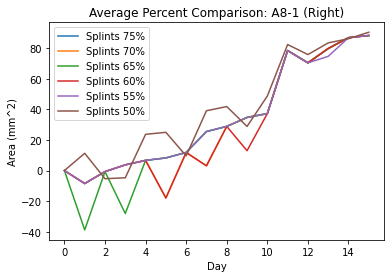

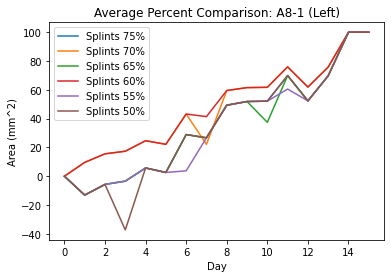

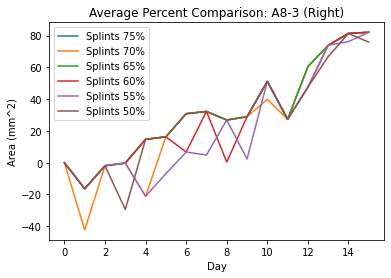

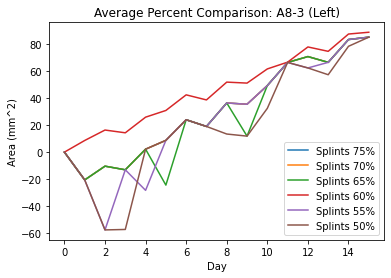

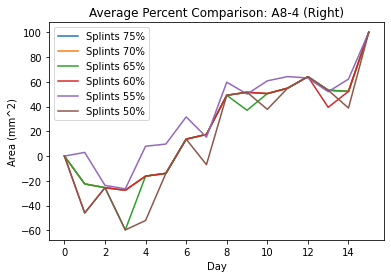

...

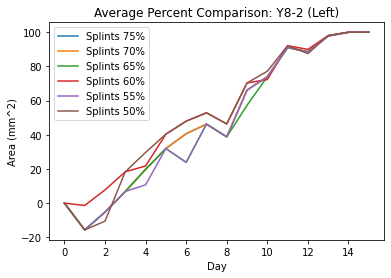

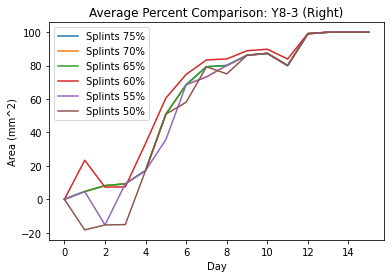

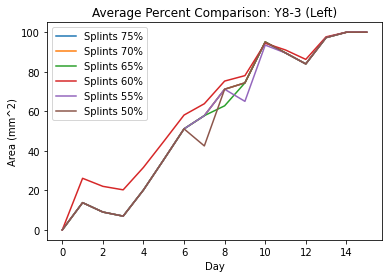

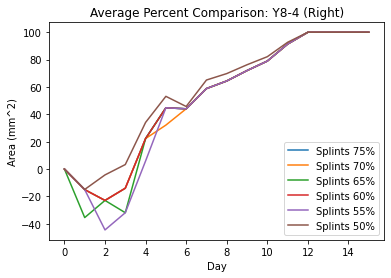

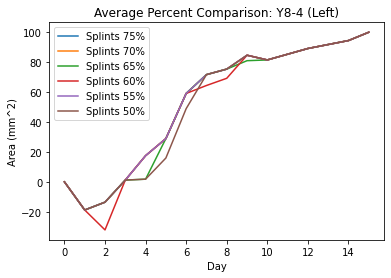

In [ ]:
output = open("Average Change Experiment (percentage closed).csv","w+")

# Column names:
output.write(("Mouse ID" + "," + "Day" + "," + "Side" +
              "," + "Splints 75%" + "," + "Splints 70%" + "," + 
              "Splints 65%" + "," + "Splints 60%" + "," +
              "Splints 55%" + "," + "Splints 50%") + "\n")

for base_mouse, mouse_70, mouse_65, mouse_60, mouse_55, mouse_50 in zip(pred_mice, avg_70, avg_65, avg_60, avg_55, avg_50):

    right_b = base_mouse.right_percentages
    right_70 = mouse_70.right_percentages
    right_65 = mouse_65.right_percentages
    right_60 = mouse_60.right_percentages
    right_55 = mouse_55.right_percentages
    right_50 = mouse_50.right_percentages

    if (base_mouse.id != mouse_70.id):
        break

    i = 0
    for r_b, r_70, r_65, r_60, r_55, r_50 in zip(right_b, right_70, right_65, right_60, right_55, right_50):

        output.write((base_mouse.id + "," + str(i) + "," + "Right" + "," + 
              str(round(r_b, 3)) + "," + str(round(r_70, 3)) + "," + 
              str(round(r_65, 3)) + "," + str(round(r_60, 3)) + "," +
              str(round(r_55, 3)) + "," + str(round(r_50, 3))) + "\n")
        i += 1


    fig, ax = plt.subplots()
    plt.title("Average Percent Comparison: " + base_mouse.id + " (Right)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, right_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, right_b)
    ax.plot(x, right_70)
    ax.plot(x, right_65)
    ax.plot(x, right_60)
    ax.plot(x, right_55)
    ax.plot(x, right_50)

    plt.legend(('Splints 75%', 'Splints 70%', 'Splints 65%', 'Splints 60%', 'Splints 55%', 'Splints 50%'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Right)" + " ring search comparison (closure %).pdf")
    plt.show()

    ##### LEFT #####

    left_b = base_mouse.left_percentages
    left_70 = mouse_70.left_percentages
    left_65 = mouse_65.left_percentages
    left_60 = mouse_60.left_percentages
    left_55 = mouse_55.left_percentages
    left_50 = mouse_50.left_percentages

    i = 0
    for lp_b, lp_70, lp_65, lp_60, lp_55, lp_50 in zip(left_b, left_70, left_65, left_60, left_55, left_50):

        output.write((base_mouse.id + "," + str(i) + "," + "Left" + "," + 
              str(round(lp_b, 3)) + "," + str(round(lp_70, 3)) + "," + 
              str(round(lp_65, 3)) + "," + str(round(lp_60, 3)) + "," +
              str(round(lp_55, 3)) + "," + str(round(lp_50, 3))) + "\n")
        i += 1
        
    fig, ax = plt.subplots()
    plt.title("Average Percent Comparison: " + base_mouse.id + " (Left)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, left_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, left_b)
    ax.plot(x, left_70)
    ax.plot(x, left_65)
    ax.plot(x, left_60)
    ax.plot(x, left_55)
    ax.plot(x, left_50)

    plt.legend(('Splints 75%', 'Splints 70%', 'Splints 65%', 'Splints 60%', 'Splints 55%', 'Splints 50%'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Left)" + " ring search comparison (closure %).pdf")
    plt.show()

output.close()

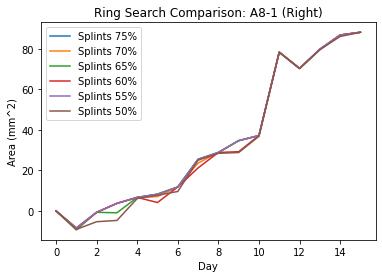

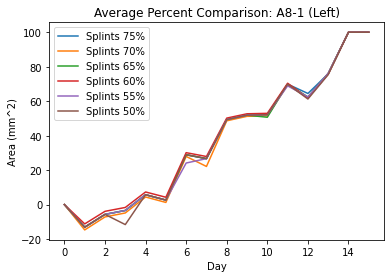

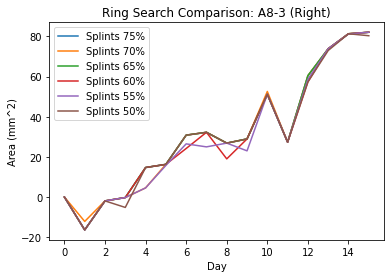

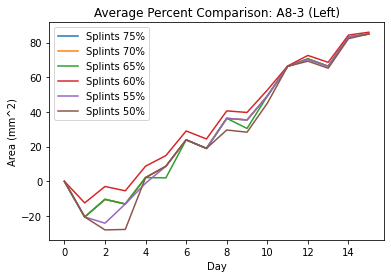

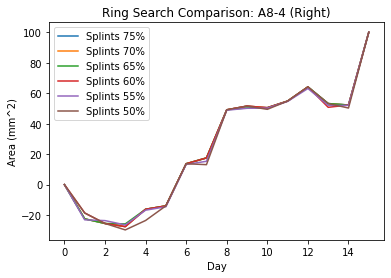

...

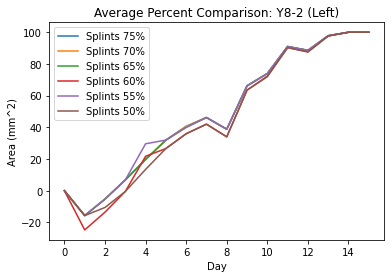

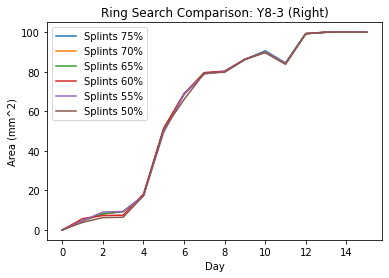

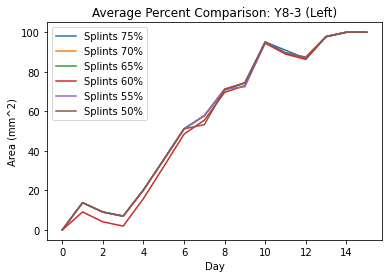

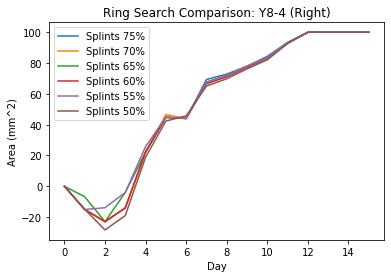

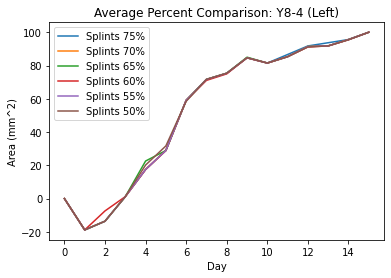

In [ ]:
output = open("Ring Search Experiment (percentage closed).csv","w+")

# Column names:
output.write(("Mouse ID" + "," + "Day" + "," + "Side" +
              "," + "Splints 75%" + "," + "Splints 70%" + "," + 
              "Splints 65%" + "," + "Splints 60%" + "," +
              "Splints 55%" + "," + "Splints 50%") + "\n")

for base_mouse, mouse_70, mouse_65, mouse_60, mouse_55, mouse_50 in zip(new_tech_mice, mice_70, mice_65, mice_60, mice_55, mice_50):

    right_b = base_mouse.right_percentages
    right_70 = mouse_70.right_percentages
    right_65 = mouse_65.right_percentages
    right_60 = mouse_60.right_percentages
    right_55 = mouse_55.right_percentages
    right_50 = mouse_50.right_percentages

    if (base_mouse.id != mouse_70.id):
        break

    i = 0
    for r_b, r_70, r_65, r_60, r_55, r_50 in zip(right_b, right_70, right_65, right_60, right_55, right_50):

        output.write((base_mouse.id + "," + str(i) + "," + "Right" + "," + 
              str(round(r_b, 3)) + "," + str(round(r_70, 3)) + "," + 
              str(round(r_65, 3)) + "," + str(round(r_60, 3)) + "," +
              str(round(r_55, 3)) + "," + str(round(r_50, 3))) + "\n")
        i += 1


    fig, ax = plt.subplots()
    plt.title("Ring Search Comparison: " + base_mouse.id + " (Right)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, right_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, right_b)
    ax.plot(x, right_70)
    ax.plot(x, right_65)
    ax.plot(x, right_60)
    ax.plot(x, right_55)
    ax.plot(x, right_50)

    plt.legend(('Splints 75%', 'Splints 70%', 'Splints 65%', 'Splints 60%', 'Splints 55%', 'Splints 50%'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Right)" + " average comparison (closure %).pdf")
    plt.show()

    ##### LEFT #####

    left_b = base_mouse.left_percentages
    left_70 = mouse_70.left_percentages
    left_65 = mouse_65.left_percentages
    left_60 = mouse_60.left_percentages
    left_55 = mouse_55.left_percentages
    left_50 = mouse_50.left_percentages

    i = 0
    for lp_b, lp_70, lp_65, lp_60, lp_55, lp_50 in zip(left_b, left_70, left_65, left_60, left_55, left_50):

        output.write((base_mouse.id + "," + str(i) + "," + "Left" + "," + 
              str(round(lp_b, 3)) + "," + str(round(lp_70, 3)) + "," + 
              str(round(lp_65, 3)) + "," + str(round(lp_60, 3)) + "," +
              str(round(lp_55, 3)) + "," + str(round(lp_50, 3))) + "\n")
        i += 1
        
    fig, ax = plt.subplots()
    plt.title("Average Percent Comparison: " + base_mouse.id + " (Left)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, left_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, left_b)
    ax.plot(x, left_70)
    ax.plot(x, left_65)
    ax.plot(x, left_60)
    ax.plot(x, left_55)
    ax.plot(x, left_50)

    plt.legend(('Splints 75%', 'Splints 70%', 'Splints 65%', 'Splints 60%', 'Splints 55%', 'Splints 50%'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Left)" + " average comparison (closure %).pdf")
    plt.show()

output.close()

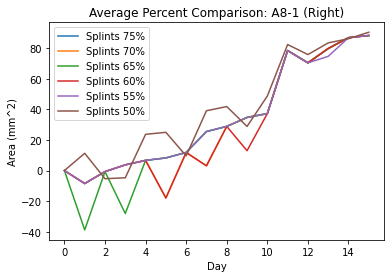

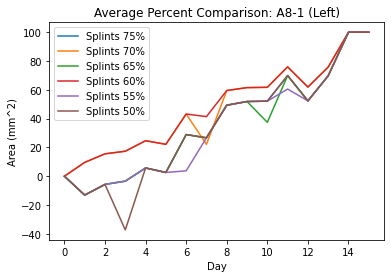

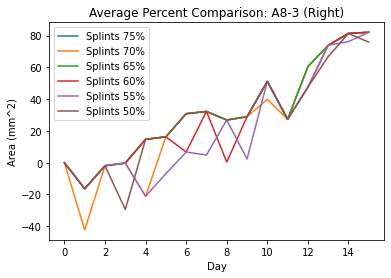

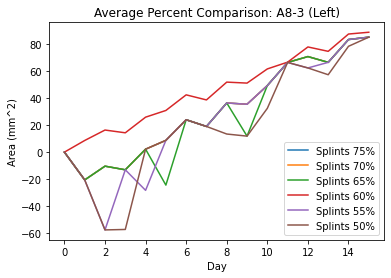

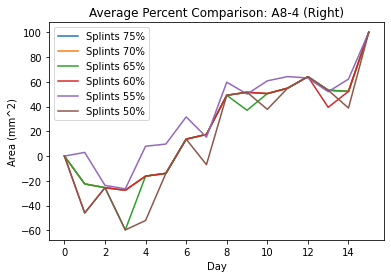

...

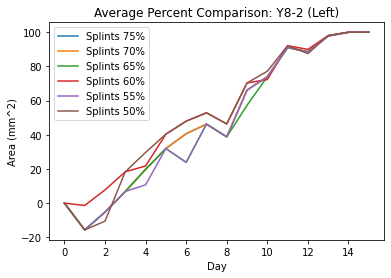

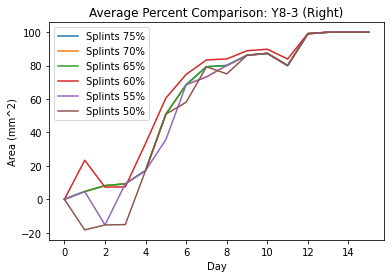

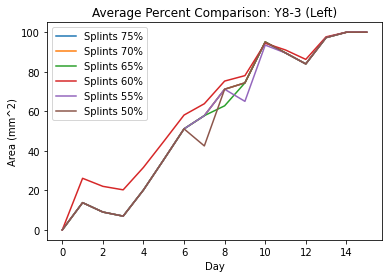

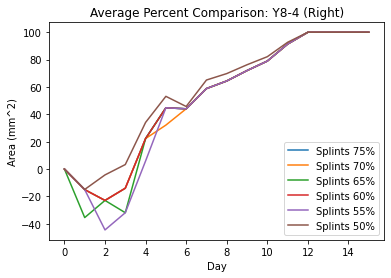

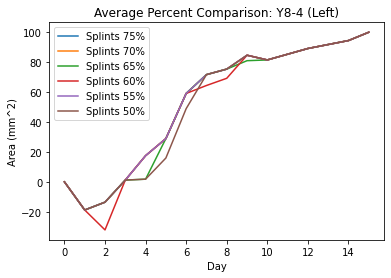

In [ ]:
output = open("Average Change Experiment (percentage closed).csv","w+")

# Column names:
output.write(("Mouse ID" + "," + "Day" + "," + "Side" +
              "," + "Splints 75%" + "," + "Splints 70%" + "," + 
              "Splints 65%" + "," + "Splints 60%" + "," +
              "Splints 55%" + "," + "Splints 50%") + "\n")

for base_mouse, mouse_70, mouse_65, mouse_60, mouse_55, mouse_50 in zip(pred_mice, avg_70, avg_65, avg_60, avg_55, avg_50):

    right_b = base_mouse.right_percentages
    right_70 = mouse_70.right_percentages
    right_65 = mouse_65.right_percentages
    right_60 = mouse_60.right_percentages
    right_55 = mouse_55.right_percentages
    right_50 = mouse_50.right_percentages

    if (base_mouse.id != mouse_70.id):
        break

    i = 0
    for r_b, r_70, r_65, r_60, r_55, r_50 in zip(right_b, right_70, right_65, right_60, right_55, right_50):

        output.write((base_mouse.id + "," + str(i) + "," + "Right" + "," + 
              str(round(r_b, 3)) + "," + str(round(r_70, 3)) + "," + 
              str(round(r_65, 3)) + "," + str(round(r_60, 3)) + "," +
              str(round(r_55, 3)) + "," + str(round(r_50, 3))) + "\n")
        i += 1


    fig, ax = plt.subplots()
    plt.title("Average Percent Comparison: " + base_mouse.id + " (Right)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, right_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, right_b)
    ax.plot(x, right_70)
    ax.plot(x, right_65)
    ax.plot(x, right_60)
    ax.plot(x, right_55)
    ax.plot(x, right_50)

    plt.legend(('Splints 75%', 'Splints 70%', 'Splints 65%', 'Splints 60%', 'Splints 55%', 'Splints 50%'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Right)" + " average comparison (closure %).pdf")
    plt.show()

    ##### LEFT #####

    left_b = base_mouse.left_percentages
    left_70 = mouse_70.left_percentages
    left_65 = mouse_65.left_percentages
    left_60 = mouse_60.left_percentages
    left_55 = mouse_55.left_percentages
    left_50 = mouse_50.left_percentages

    i = 0
    for lp_b, lp_70, lp_65, lp_60, lp_55, lp_50 in zip(left_b, left_70, left_65, left_60, left_55, left_50):

        output.write((base_mouse.id + "," + str(i) + "," + "Left" + "," + 
              str(round(lp_b, 3)) + "," + str(round(lp_70, 3)) + "," + 
              str(round(lp_65, 3)) + "," + str(round(lp_60, 3)) + "," +
              str(round(lp_55, 3)) + "," + str(round(lp_50, 3))) + "\n")
        i += 1
        
    fig, ax = plt.subplots()
    plt.title("Average Percent Comparison: " + base_mouse.id + " (Left)")
    x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    try:
        ax.plot(x, left_b)
    except:
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
        ax.plot(x, left_b)
    ax.plot(x, left_70)
    ax.plot(x, left_65)
    ax.plot(x, left_60)
    ax.plot(x, left_55)
    ax.plot(x, left_50)

    plt.legend(('Splints 75%', 'Splints 70%', 'Splints 65%', 'Splints 60%', 'Splints 55%', 'Splints 50%'))
    plt.xlabel('Day')
    plt.ylabel('Area (mm^2)')
    plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + base_mouse.id + " (Left)" + " average comparison (closure %).pdf")
    plt.show()

output.close()

## Old ring search comparisons

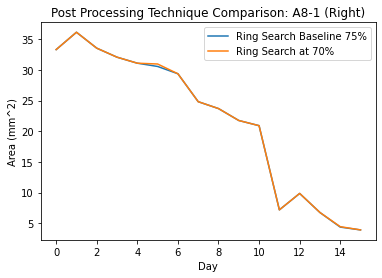

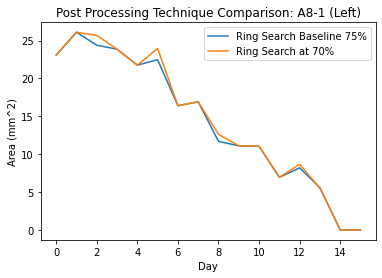

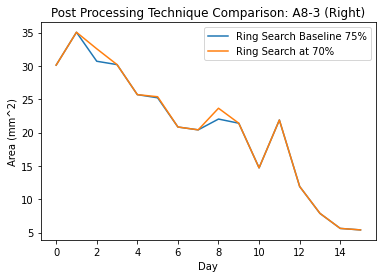

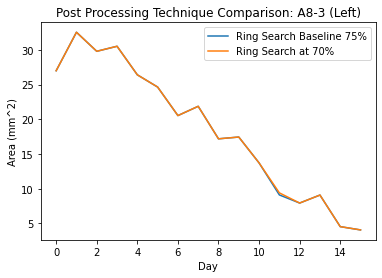

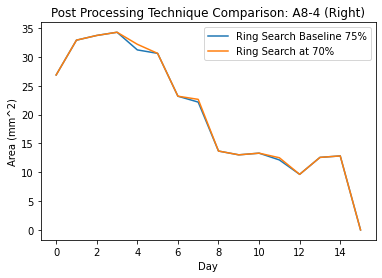

...

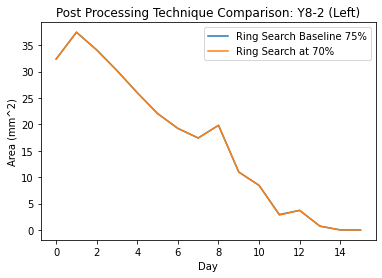

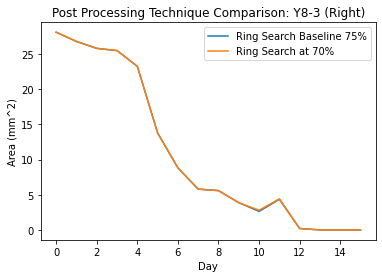

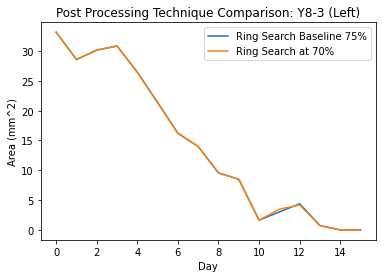

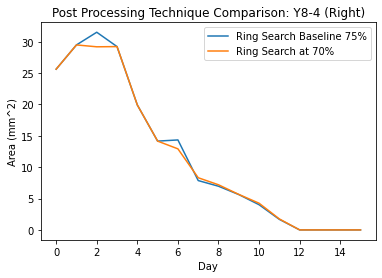

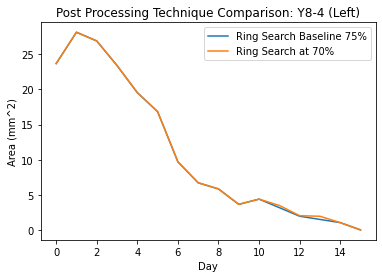

In [ ]:
compare_search(new_tech_mice, mice_70, '70%')

65%

In [ ]:
ring_65 = copy.deepcopy(ring_70)
to_delete = random.sample(list(ring_65.keys()), k = 13)

for key in to_delete:
    ring_65.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_65, changes = apply_search_method(pred_mice, ring_65, deletions)

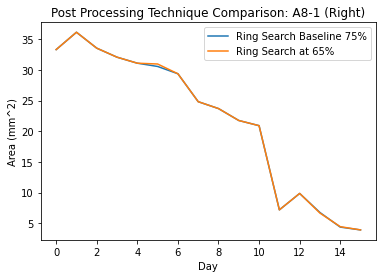

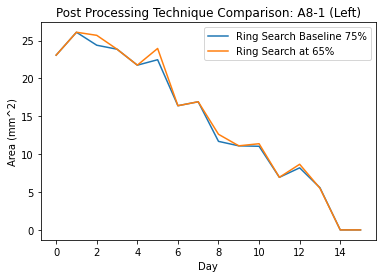

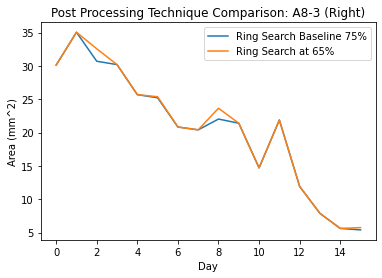

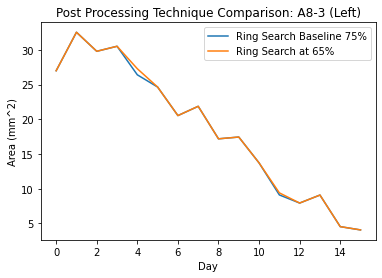

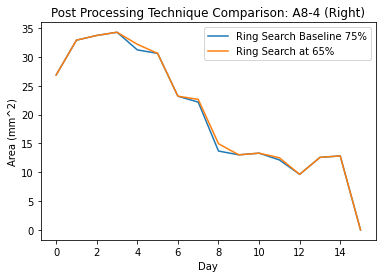

...

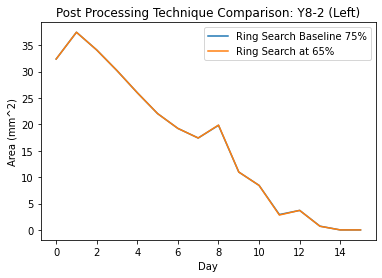

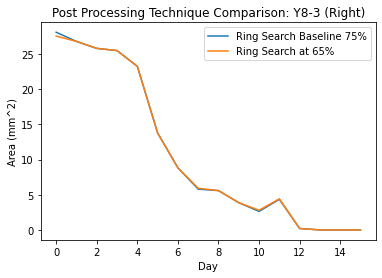

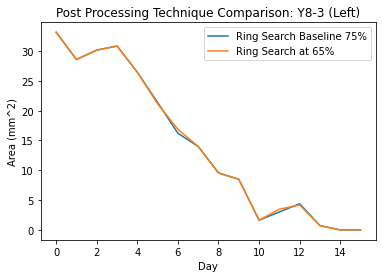

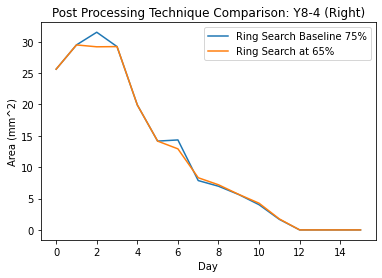

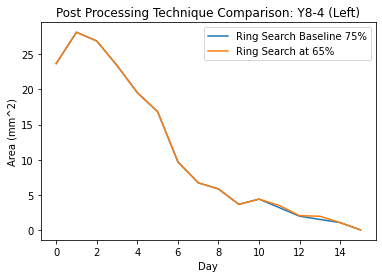

In [ ]:
compare_search(new_tech_mice, mice_65, '65%')

60%

In [ ]:
ring_60 = copy.deepcopy(ring_65)
to_delete = random.sample(list(ring_60.keys()), k = 13)

for key in to_delete:
    ring_60.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_60, changes = apply_search_method(pred_mice, ring_60, deletions)

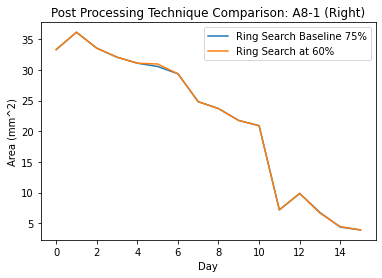

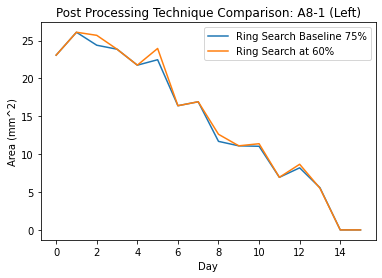

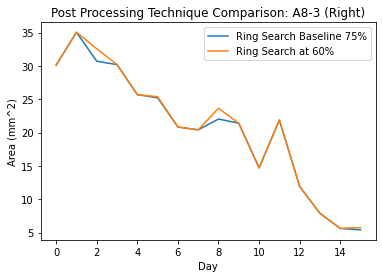

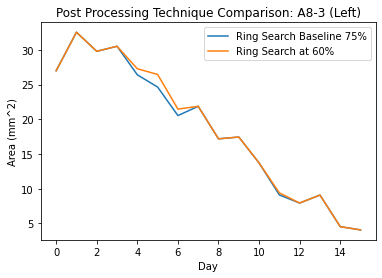

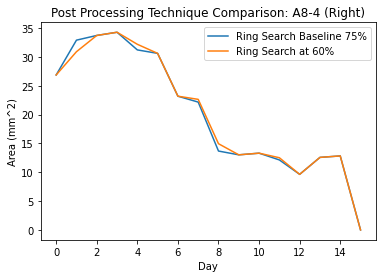

...

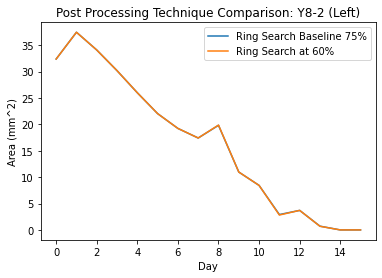

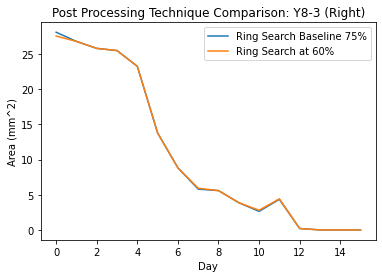

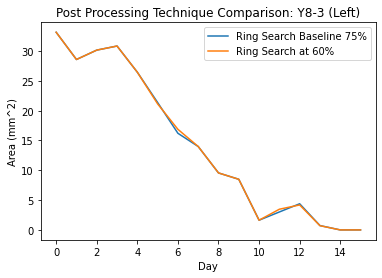

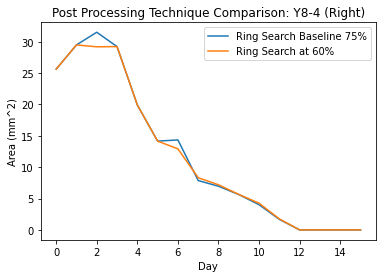

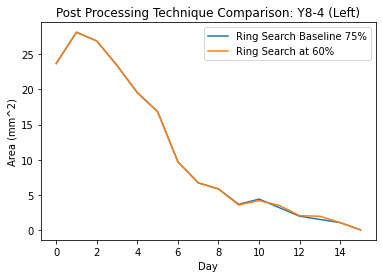

In [ ]:
compare_search(new_tech_mice, mice_60, '60%') # New technique mice is the baseline 75%

55%

In [ ]:
ring_55 = copy.deepcopy(ring_60) # Always get previous one
to_delete = random.sample(list(ring_55.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_55.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_55, changes = apply_search_method(pred_mice, ring_55, deletions) # Always get current one

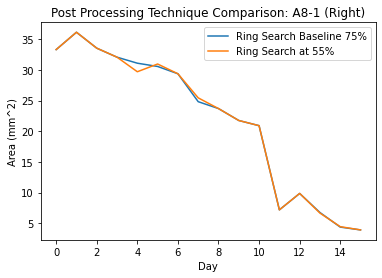

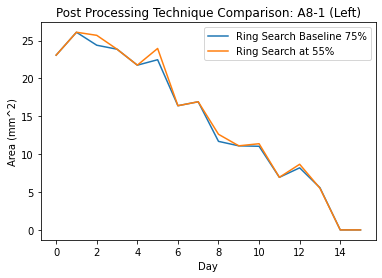

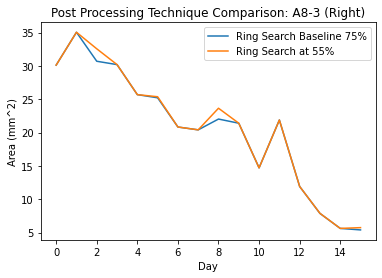

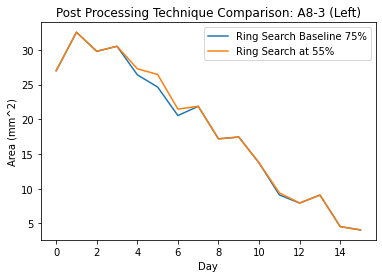

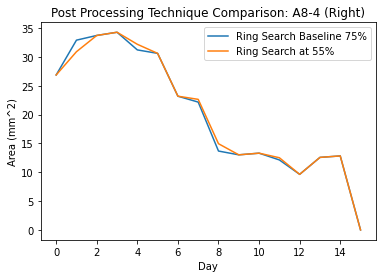

...

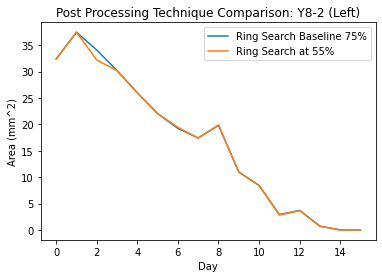

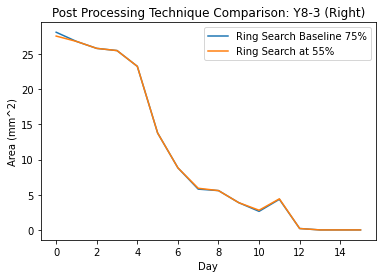

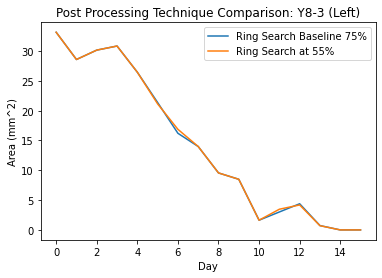

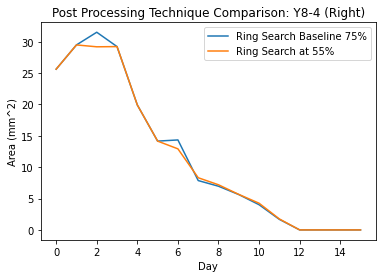

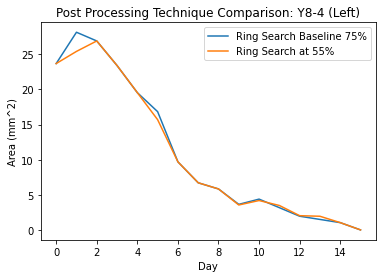

In [ ]:
compare_search(new_tech_mice, mice_55, '55%') # New technique mice is the baseline 75%

In [ ]:
ring_50 = copy.deepcopy(ring_55) # Always get previous one
to_delete = random.sample(list(ring_50.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_50.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_50, changes = apply_search_method(pred_mice, ring_50, deletions) # Always get current one

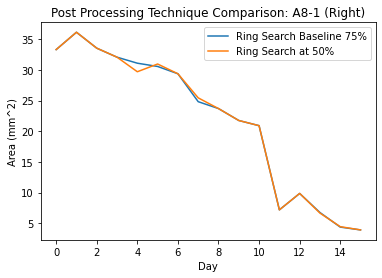

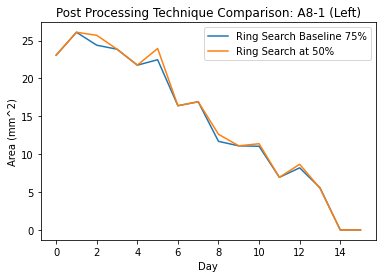

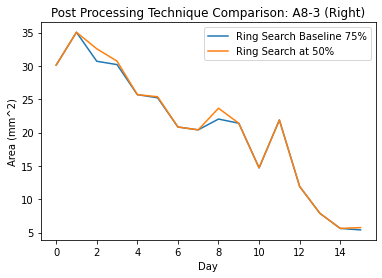

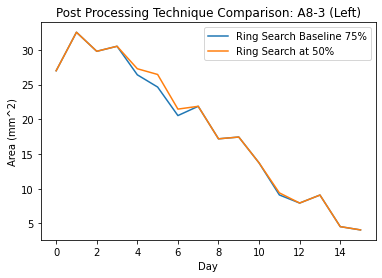

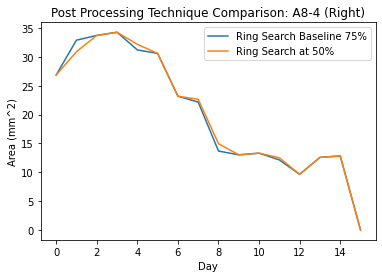

...

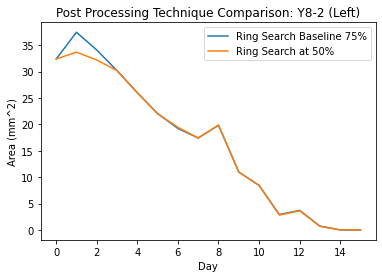

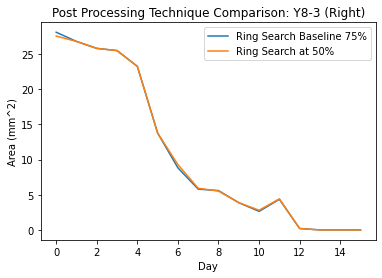

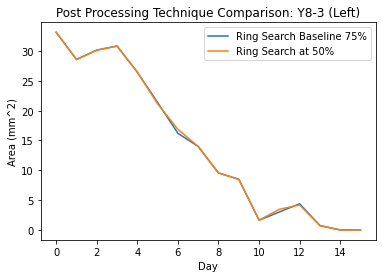

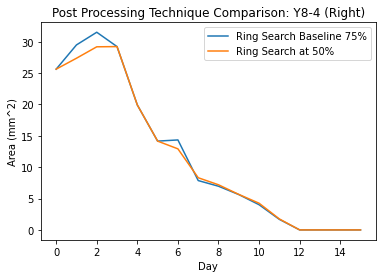

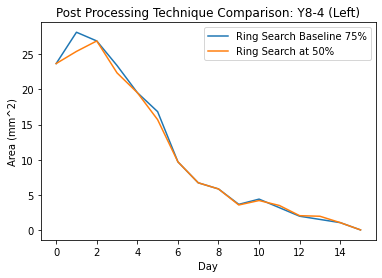

In [ ]:
compare_search(new_tech_mice, mice_50, '50%') # New technique mice is the baseline 75%

In [ ]:
ring_45 = copy.deepcopy(ring_50) # Always get previous one
to_delete = random.sample(list(ring_45.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_45.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_45, changes = apply_search_method(pred_mice, ring_45, deletions) # Always get current one

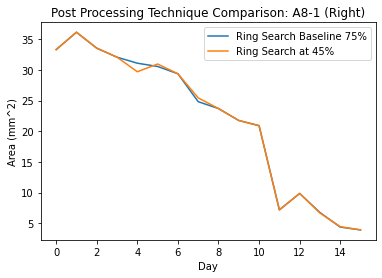

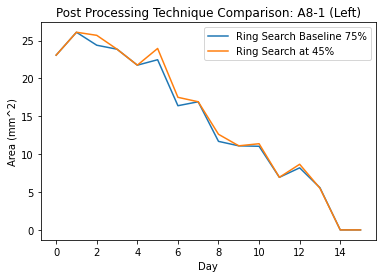

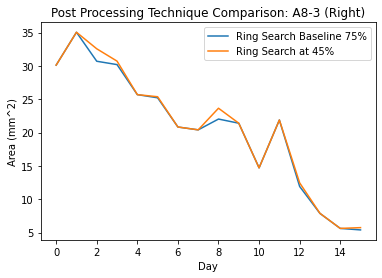

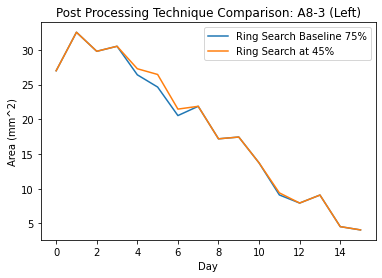

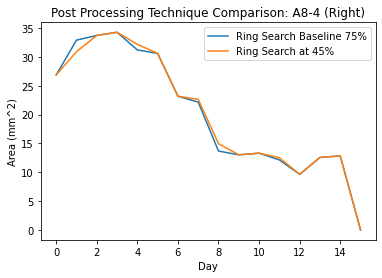

...

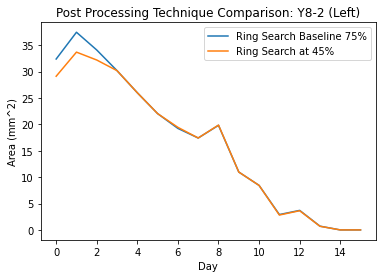

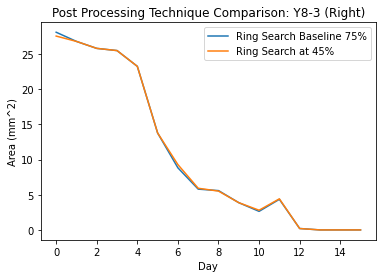

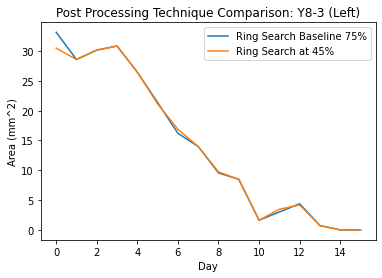

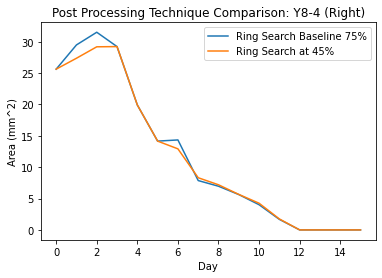

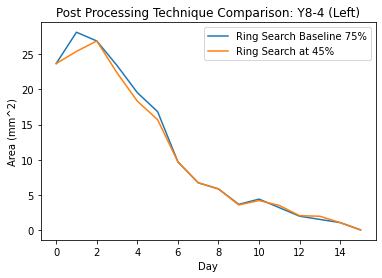

In [ ]:
compare_search(new_tech_mice, mice_45, '45%') # New tech mice is the baseline 75%

In [ ]:
ring_40 = copy.deepcopy(ring_45) # Always get previous one
to_delete = random.sample(list(ring_40.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_40.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_40, changes = apply_search_method(pred_mice, ring_40, deletions) # Always get current one

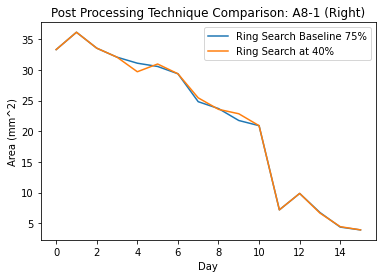

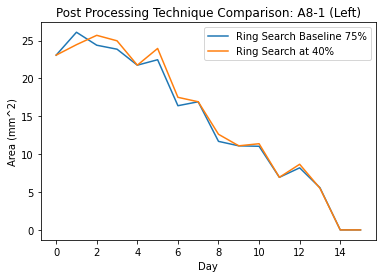

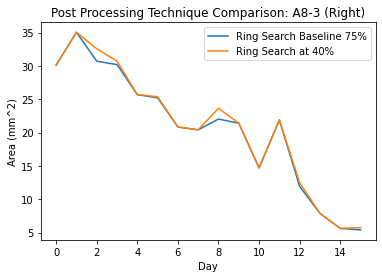

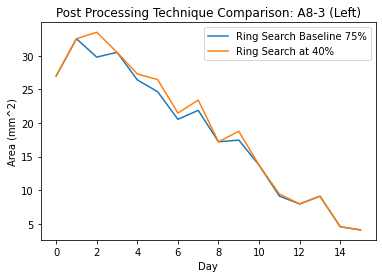

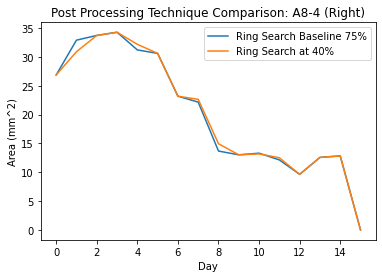

...

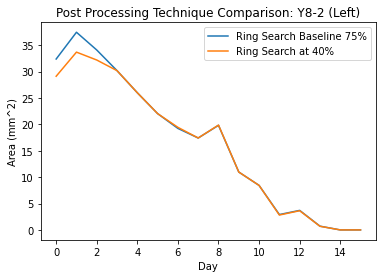

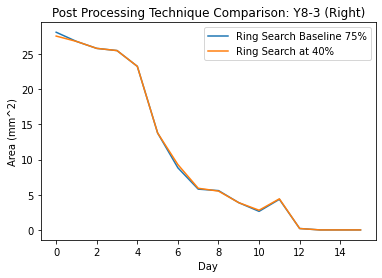

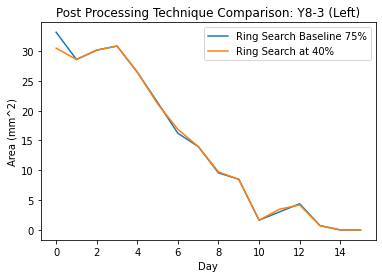

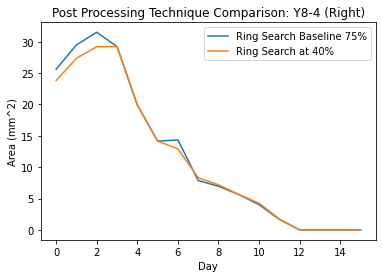

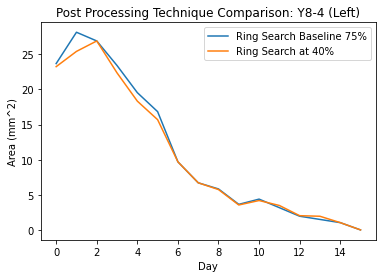

In [ ]:
compare_search(new_tech_mice, mice_40, '40%') # New tech mice is the baseline 75%

In [ ]:
ring_35 = copy.deepcopy(ring_40) # Always get previous one
to_delete = random.sample(list(ring_35.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_35.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_35, changes = apply_search_method(pred_mice, ring_35, deletions) # Always get current one

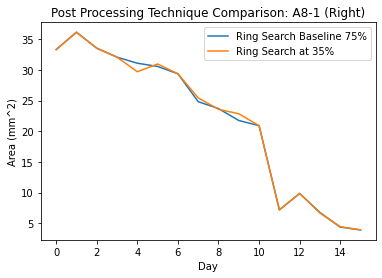

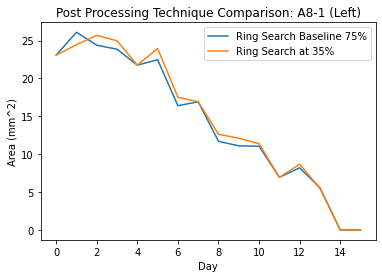

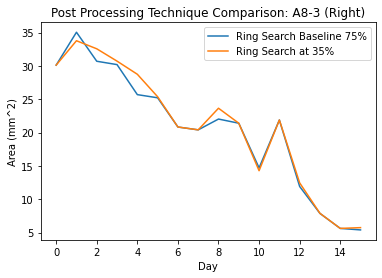

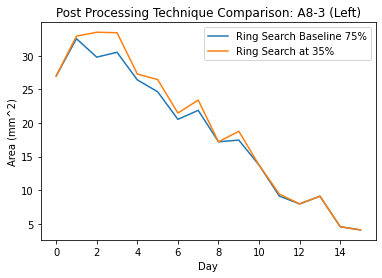

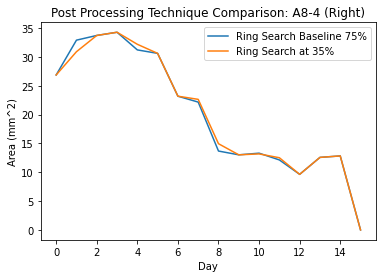

...

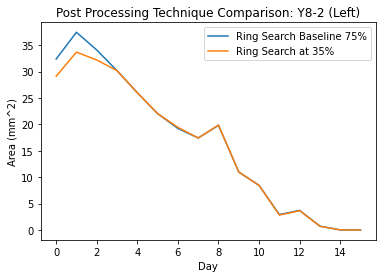

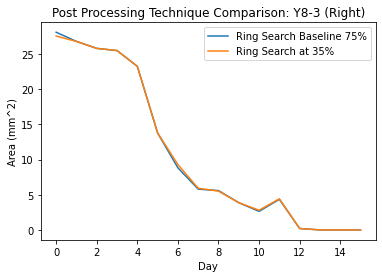

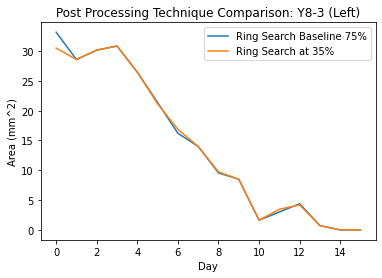

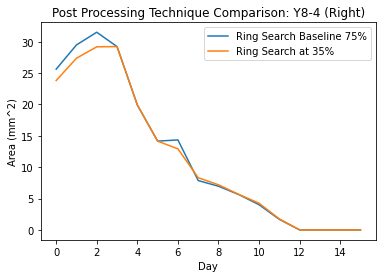

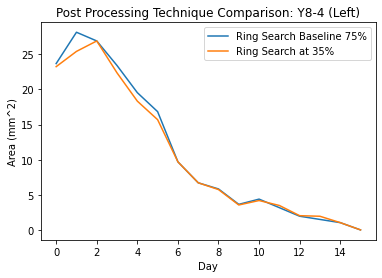

In [ ]:
compare_search(new_tech_mice, mice_35, '35%') # New tech mice is the baseline 75%

In [ ]:
ring_30 = copy.deepcopy(ring_35) # Always get previous one
to_delete = random.sample(list(ring_30.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_30.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_30, changes = apply_search_method(pred_mice, ring_30, deletions) # Always get current one

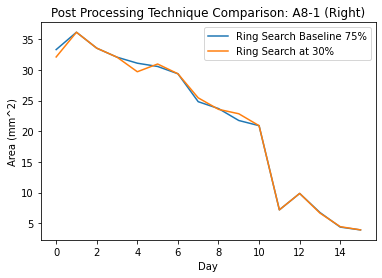

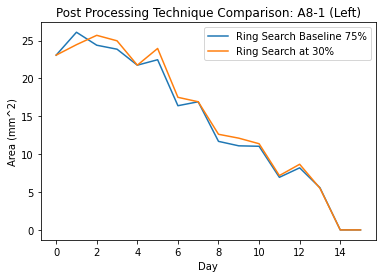

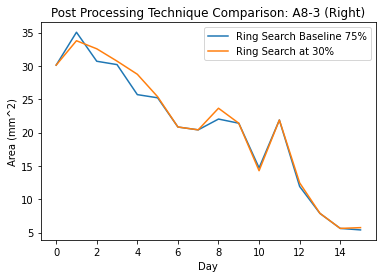

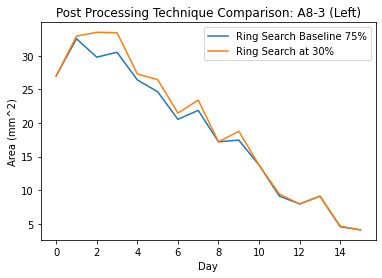

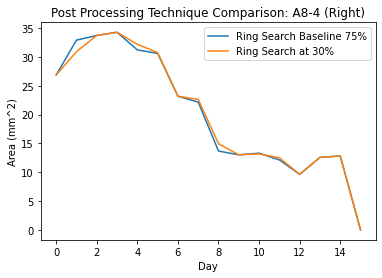

...

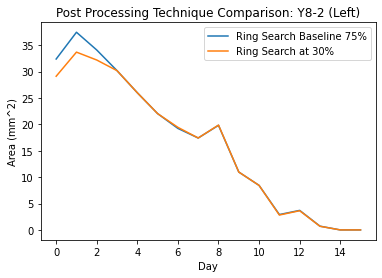

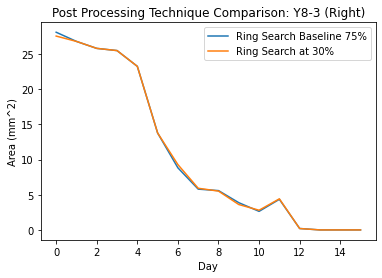

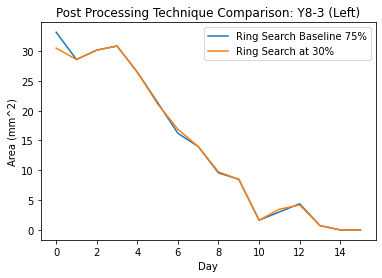

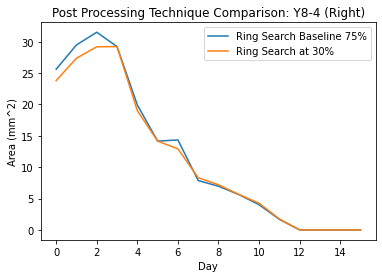

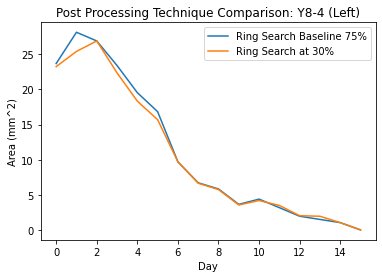

In [ ]:
compare_search(new_tech_mice, mice_30, '30%') # New tech mice is the baseline 75%

In [ ]:
ring_25 = copy.deepcopy(ring_30) # Always get previous one
to_delete = random.sample(list(ring_25.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_25.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_25, changes = apply_search_method(pred_mice, ring_25, deletions) # Always get current one

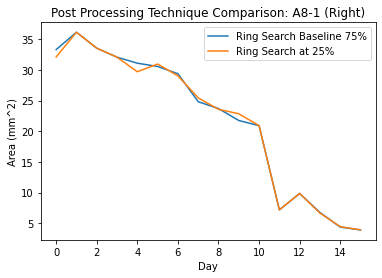

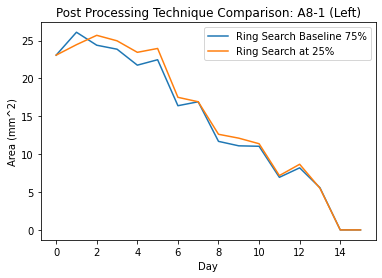

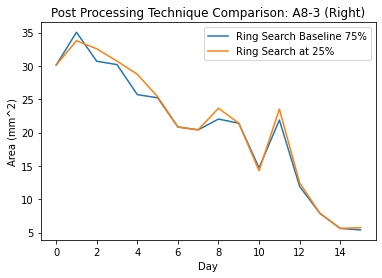

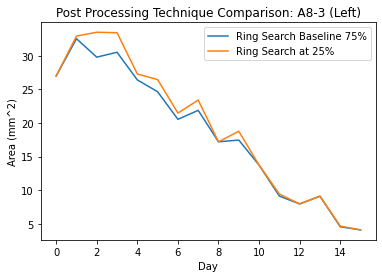

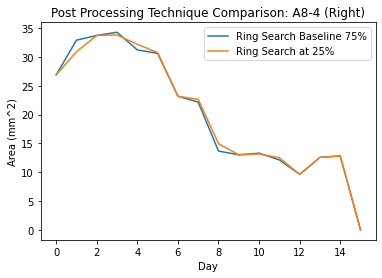

...

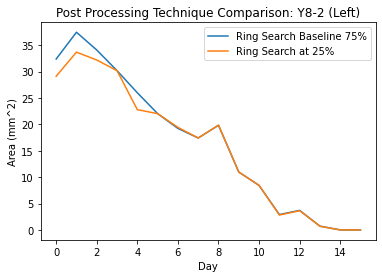

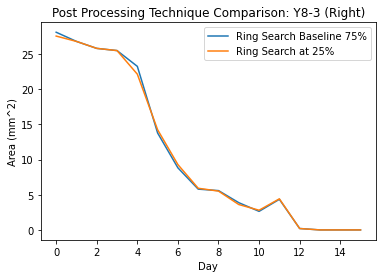

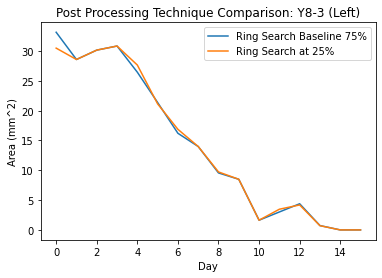

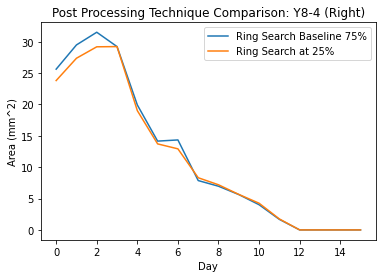

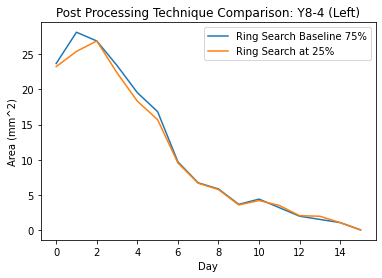

In [ ]:
compare_search(new_tech_mice, mice_25, '25%') # New tech mice is the baseline 75%

In [ ]:
ring_20 = copy.deepcopy(ring_25) # Always get previous one
to_delete = random.sample(list(ring_20.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_20.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_20, changes = apply_search_method(pred_mice, ring_20, deletions) # Always get current one

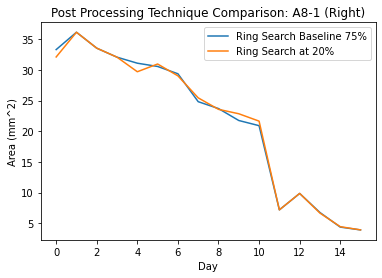

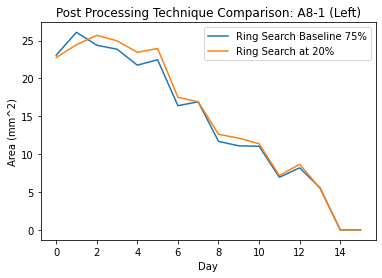

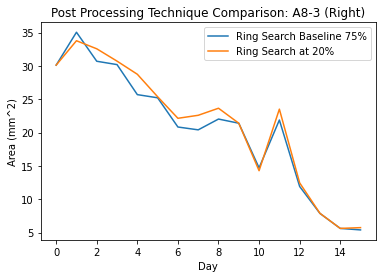

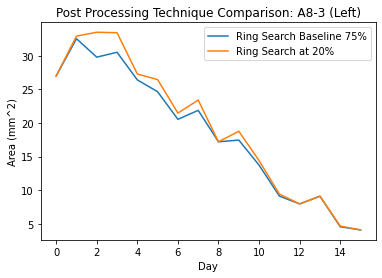

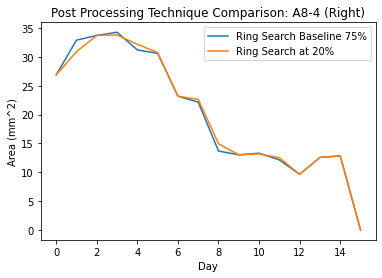

...

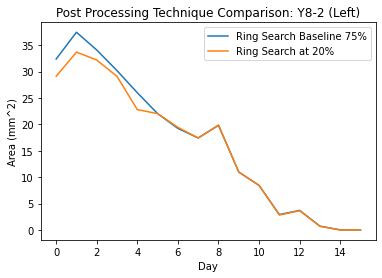

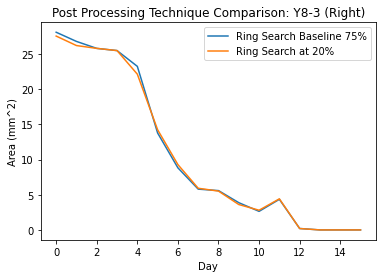

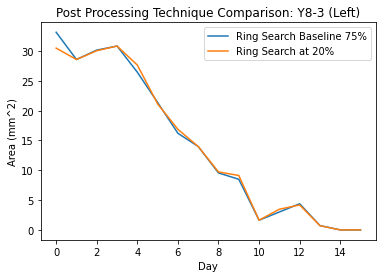

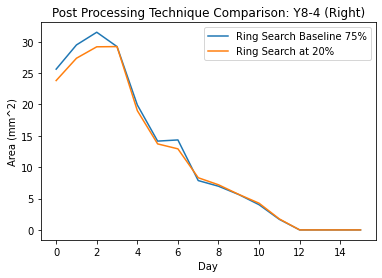

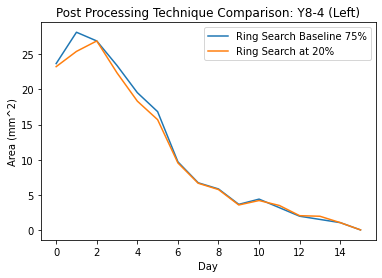

In [ ]:
compare_search(new_tech_mice, mice_20, '20%') # New tech mice is the baseline 75%

In [ ]:
ring_15 = copy.deepcopy(ring_20) # Always get previous one
to_delete = random.sample(list(ring_15.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_15.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_15, changes = apply_search_method(pred_mice, ring_15, deletions) # Always get current one

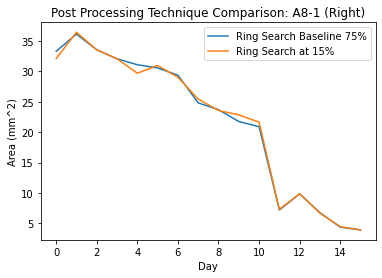

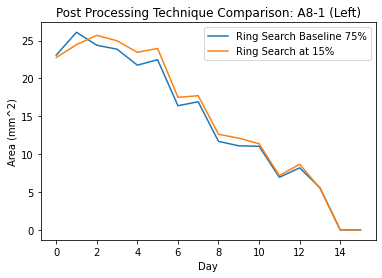

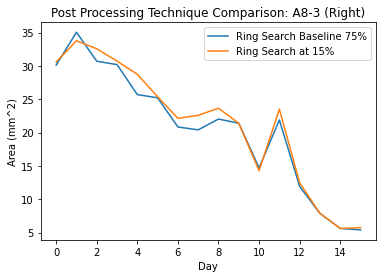

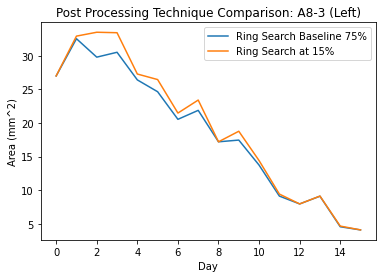

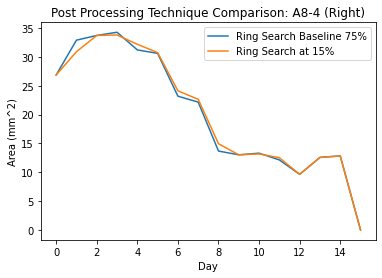

...

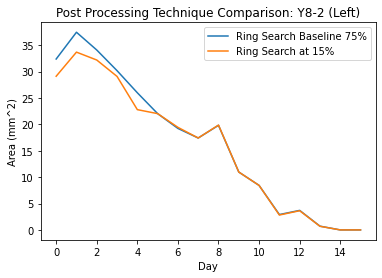

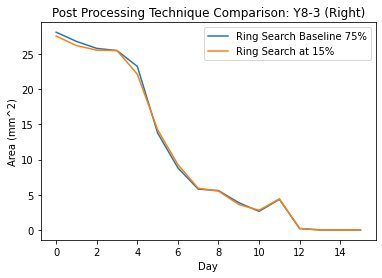

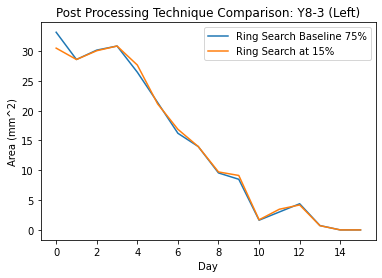

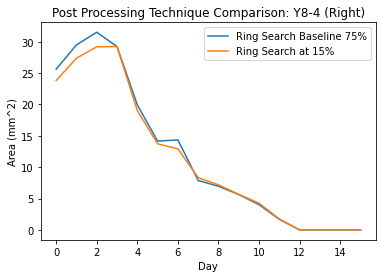

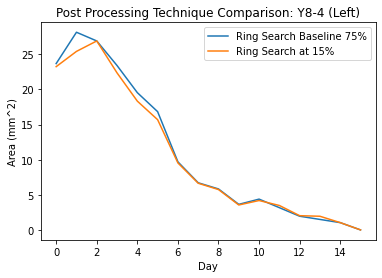

In [ ]:
compare_search(new_tech_mice, mice_15, '15%') # New tech mice is the baseline 75%

In [ ]:
ring_10 = copy.deepcopy(ring_15) # Always get previous one
to_delete = random.sample(list(ring_10.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_10.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_10, changes = apply_search_method(pred_mice, ring_10, deletions) # Always get current one

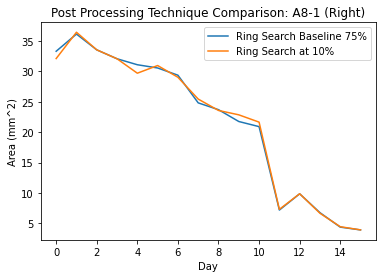

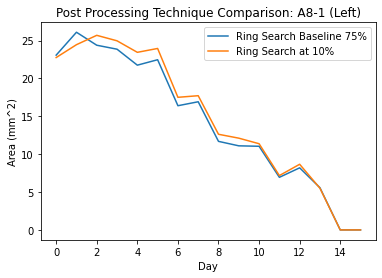

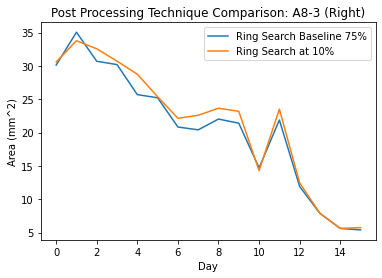

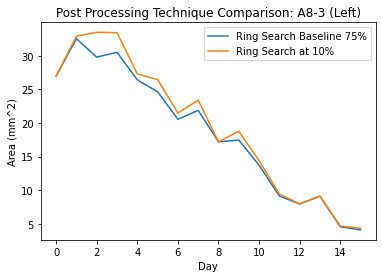

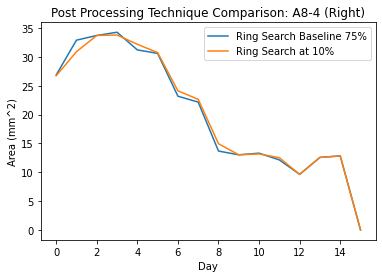

...

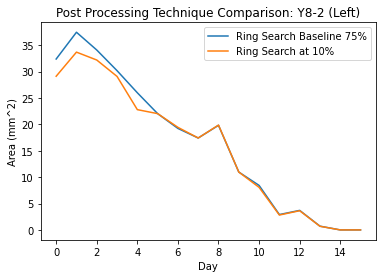

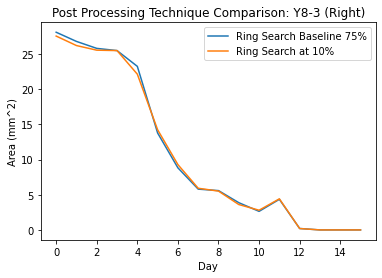

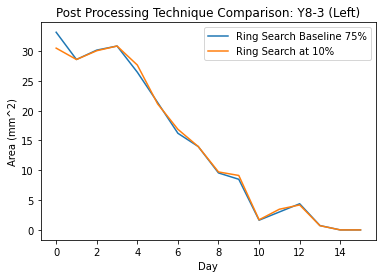

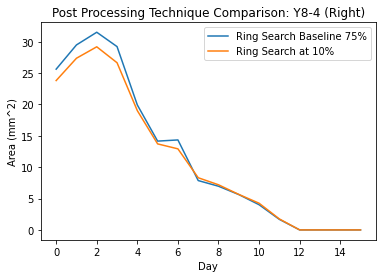

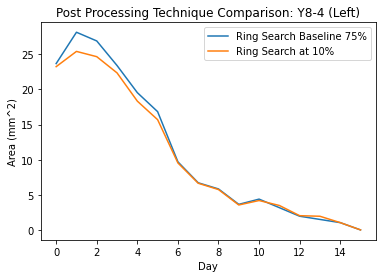

In [ ]:
compare_search(new_tech_mice, mice_10, '10%') # New tech mice is the baseline 75%

In [ ]:
ring_5 = copy.deepcopy(ring_10) # Always get previous one
to_delete = random.sample(list(ring_5.keys()), k = 13) # Always get current one

for key in to_delete:
    ring_5.pop(key) # Always get current one
    deletions.append(key)

In [ ]:
mice_5, changes = apply_search_method(pred_mice, ring_5, deletions) # Always get current one

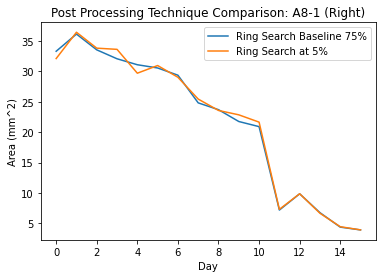

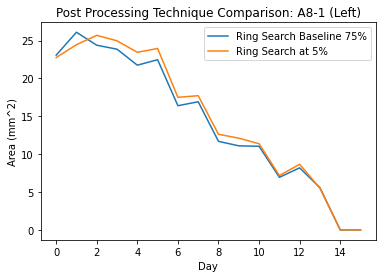

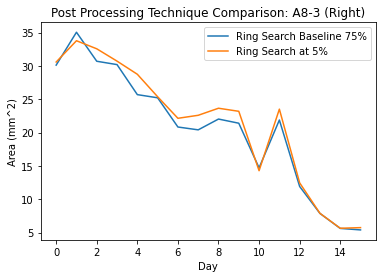

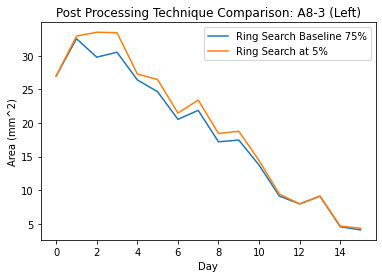

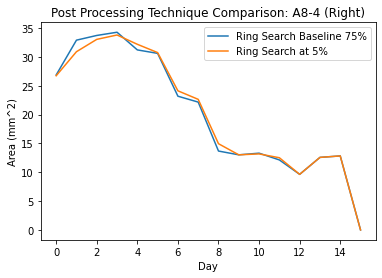

...

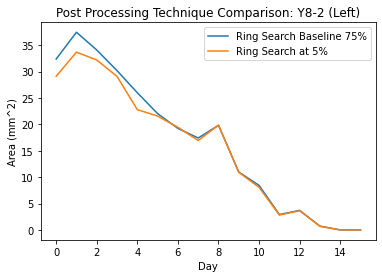

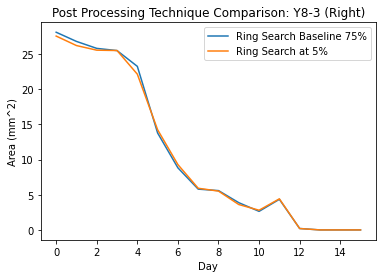

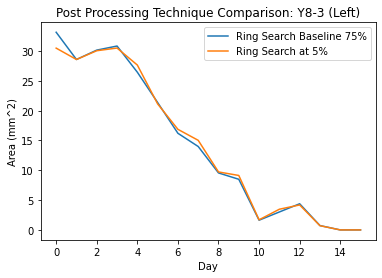

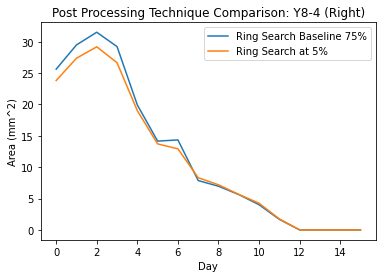

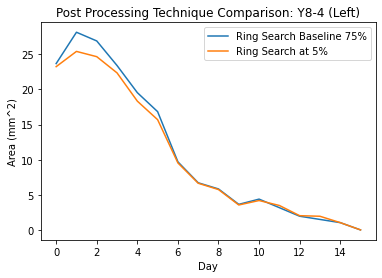

In [ ]:
compare_search(new_tech_mice, mice_5, '5%') # New tech mice is the baseline 75%

In [ ]:
len(ring_5)

11

#### Percentage bar charts

In [ ]:
pred_mice[0].get_areas('L')

In [ ]:
areas = pred_mice[3].get_areas('R')
days = pred_mice[3].get_days('R')

init_size = areas[0]
percentages = []

for area in areas:
    percentage = (100 - ((area / init_size) * 100))
    percentages.append(percentage)

print(areas)

In [ ]:
fig, ax = plt.subplots()

negatives = list(filter(negative, percentages))
positives = list(filter(positive, percentages))
i = len(negatives) + 1

plt.title(pred_mice[0].id + ' ' + side + ' Heal Percentages')
ax.bar(days[1:i], negatives, color='red')
ax.bar(days[i:], positives)
ax.axhline(y=0, color='black', linestyle='dashed')
#plt.legend(('Expected', 'Healed / lost ring', 'Higher than expected', 'Predicted'))
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
#plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + man_mouse.id + "-" + side + ".pdf")
plt.show()

In [ ]:
print(negatives)

In [ ]:
for i, x in zip(days, positives):
    print(i,x)

0 4.489091758616965
1 18.445171261186786
2 28.196096754483705
3 38.28127807928692
4 31.373324228156562
5 37.66667864716242
6 33.907199079897936
7 73.38173453617512
8 74.60374510297237
9 93.17111742083887
11 89.23911871473241
12 85.30712000862596
13 100.0
14 100.0


## Plotting functions

#### Plotting

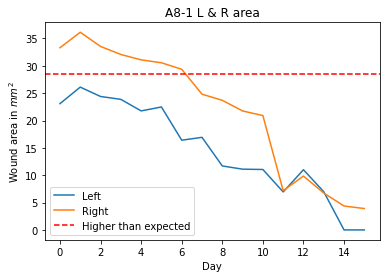

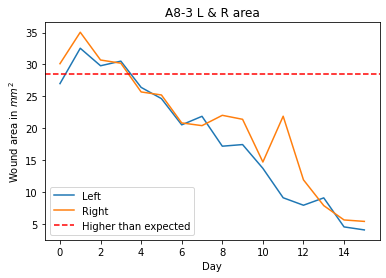

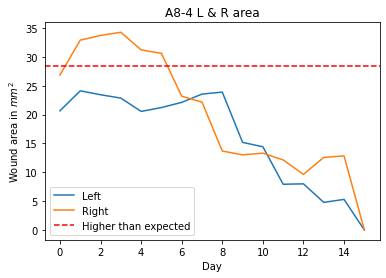

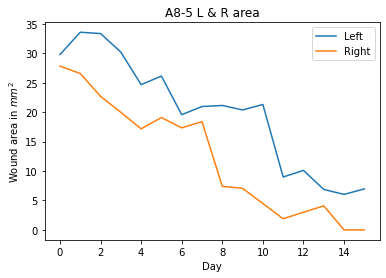

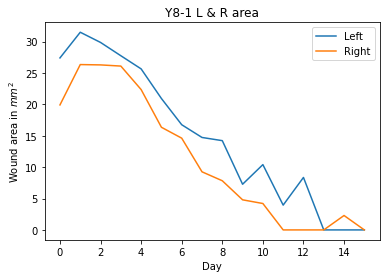

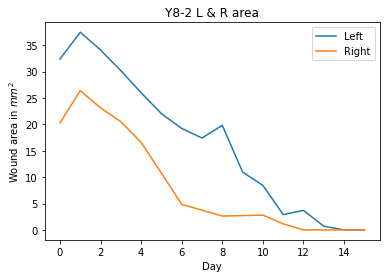

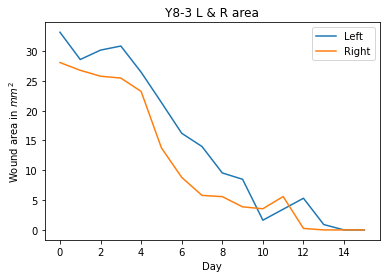

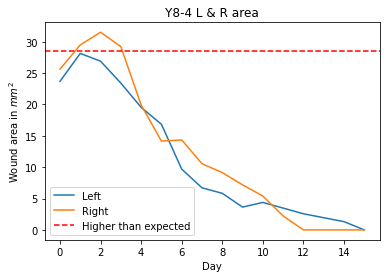

In [ ]:
for mouse in pred_mice:
    plot_charts_together(mouse, ['L', 'R'])

In [ ]:
%pwd

'/content/drive/.shortcut-targets-by-id/175Vkdh2mGaZ7CZsZetvNssl0puand1tS/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Semantic-Shapes'

## Manual Annotations

In [ ]:
%cd ..

/content/drive/.shortcut-targets-by-id/175Vkdh2mGaZ7CZsZetvNssl0puand1tS/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation


In [ ]:
def get_shapes(label_path):
    with open(label_path) as f:
        data = json.load(f)

    shapes = data['shapes']

    return shapes

In [ ]:
def create_binary_masks(im, shapes):

    canvas = np.zeros(shape=(im.shape[0], im.shape[1]), dtype=np.float32)

    if shapes[0]['label'] == 'Ring_inner':
        ring_points = np.array(shapes[0]['points'], np.int32)
        cv2.fillPoly(canvas, [ring_points], 255)

        wound_points = np.array(shapes[1]['points'], np.int32)
        cv2.fillPoly(canvas, [wound_points], 128)
    else:
        ring_points = np.array(shapes[1]['points'], np.int32)
        cv2.fillPoly(canvas, [ring_points], 255)

        wound_points = np.array(shapes[0]['points'], np.int32)
        cv2.fillPoly(canvas, [wound_points], 128)

    return canvas

In [ ]:
def create_multi_mask(im, shapes):

    channels = []
    classes = [x['label'] for x in shapes]
    poly = [np.array(x['points'], dtype=np.int32) for x in shapes]
    label2poly = dict(zip(classes, poly))
    background = np.zeros(shape = im.shape, dtype = np.float32)

    for i, label in enumerate(label_hues):

        blank = np.zeros(shape = im.shape, dtype = np.float32)

        if label in classes:
            cv2.fillPoly(blank, [label2poly[label]], 255)
            cv2.fillPoly(background, [label2poly[label]], 255)

        channels.append(blank)

    _, threshold = cv2.threshold(background, 127, 255, cv2.THRESH_BINARY_INV)
    channels.append(threshold)
    Y = np.stack(channels, axis=2)
    return Y

In [ ]:
def draw_multi_mask(im, shapes):

    blank = np.zeros(shape=im.shape, dtype=np.uint8)
    channels = []
    classes = [x['label'] for x in shapes]
    poly = [np.array(x['points'], dtype=np.int32) for x in shapes]
    label2poly = dict(zip(classes, poly))
    
    for i, label in enumerate(label_hues):
        
        if label in classes:
            cv2.fillPoly(blank, [label2poly[label]], (hues[label], 255, 255))

    return cv2.cvtColor(blank, cv2.COLOR_HSV2RGB)

In [ ]:
hues = {'Wound': 0,
        'Ring_inner': 65}

label_hues = sorted(hues.keys())

In [ ]:
class WoundManual:
    def __init__(self, day, area, diameter, image, prediction):
        self.day = day
        self.image = image
        self.prediction = prediction
        self.area = area
        self.diameter = diameter

In [ ]:
def get_manual_size(prediction):

    global g_total_manual
    global g_total_size_manual
    global manual_g_avg

    area_red_ch = (prediction[:,:,0] >= 20).sum()
    area_green_ch = (prediction[:,:,1] >= 40).sum()

    if area_green_ch > 20:

        area_green_ch += area_red_ch

        g_total_size_manual += area_green_ch
        g_total_manual += 1

        ratio = area_red_ch / area_green_ch
        green_area = np.pi * (5**2)
        wound_area = round((ratio * green_area), 3)
        wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

        if wound_area > 150 or wound_diameter > 15:

            return 0, 0

        else:
            return wound_area, wound_diameter

    else:

        ratio = area_red_ch / manual_g_avg
        green_area = np.pi * (5**2)
        wound_area = round((ratio * green_area), 3)
        wound_diameter = round(2 * (np.sqrt(wound_area / np.pi)), 3)

        if wound_area > 150 or wound_diameter > 15:

            return 0, 0

        else:
            return wound_area, wound_diameter

In [ ]:
mice = ['A8-1', 'A8-3', 'A8-4', 'A8-5', 'Y8-1', 'Y8-2', 'Y8-3', 'Y8-4']
sides = ['L', 'R']
days = 16

In [ ]:
manual_mice = []
g_total_size_manual = 0
g_total_manual = 0

manual_g_avg = 28186.333333333332

for mouse in mice:
    new_mouse = Mouse(mouse)
    for day in range(days):
        for side in sides:

            # Build filenames in order
            day_str = 'Day ' + str(day) + '_'
            side_ext = '-' + side
            img_key = day_str + mouse + side_ext + '.png'
            json_key = day_str + mouse + side_ext + '.json'

            try:
                im = cv2.imread(os.path.join('consistent_crops_full', img_key), 1)
                label_path = os.path.join('consistent_labels_full', json_key)
                shapes = get_shapes(label_path)

                annotation = draw_multi_mask(im, shapes)
                area, diameter = get_manual_size(annotation)

                new_wound = WoundManual(day, area, diameter, im, annotation)
                
                if side == 'L':
                    new_mouse.left_wounds.append(new_wound)

                elif side == 'R':
                    new_mouse.right_wounds.append(new_wound)

            except:
                print("no annotation for file", img_key)

    manual_mice.append(new_mouse)

manual_g_avg = g_total_size_manual / g_total_manual

no annotation for file Day 10_A8-5-R.png
no annotation for file Day 9_Y8-2-R.png


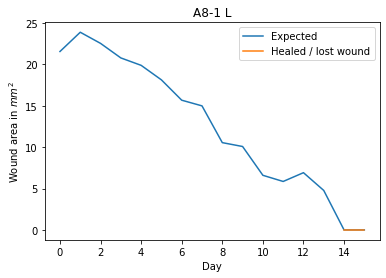

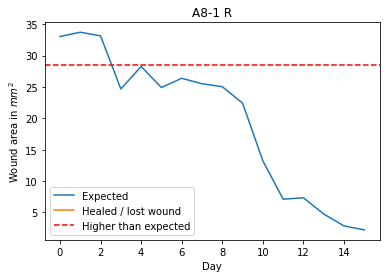

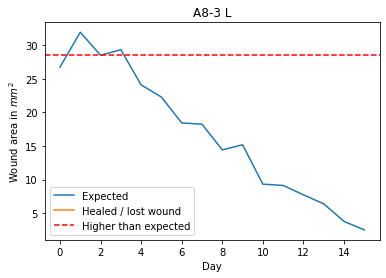

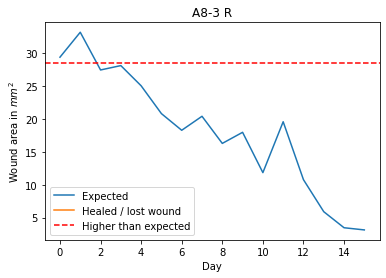

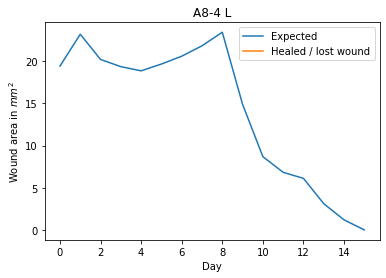

...

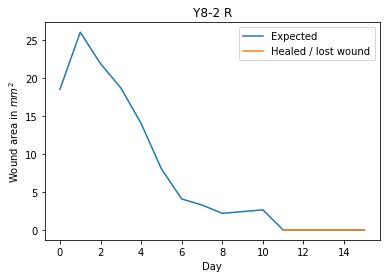

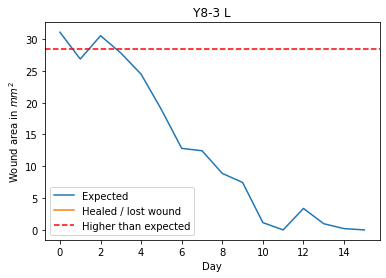

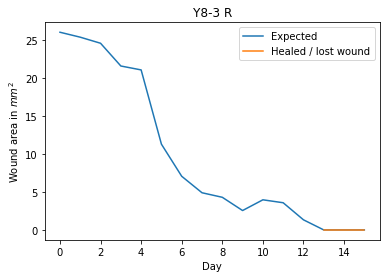

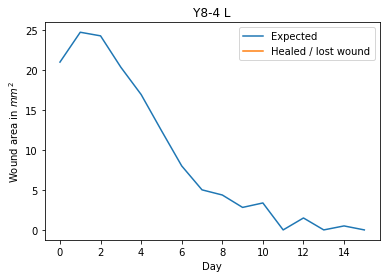

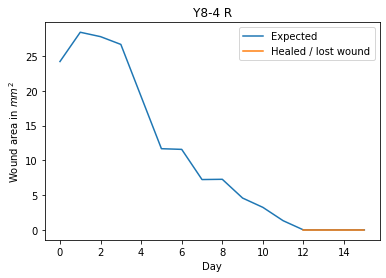

In [ ]:
for mouse in manual_mice:
    plot_charts(mouse, ['L', 'R'])

In [ ]:
for wound in manual_mice[0].right_wounds:
    print(wound.day, wound.area, wound.diameter)

0 33.054 6.487
1 33.728 6.553
2 33.151 6.497
3 24.688 5.607
4 28.268 5.999
5 24.91 5.632
6 26.388 5.796
7 25.516 5.7
8 25.046 5.647
9 22.412 5.342
10 13.222 4.103
11 7.109 3.009
12 7.339 3.057
13 4.741 2.457
14 2.852 1.906
15 2.212 1.678


In [ ]:
for i, j in zip(manual_mice[3].get_days('L'), manual_mice[3].get_areas('L')):
    print(i, j)

0 28.815
1 32.399
2 30.732
3 28.181
4 24.799
5 22.871
6 17.52
7 14.379
8 15.95
9 16.258
10 19.602
11 6.596
12 6.204
13 5.788
14 3.731
15 4.765


In [ ]:
plot_pair((pred_mice[0].get_images('L')[0], manual_mice[0].get_predictions('L')[0]))

In [ ]:
plot_pair((pred_mice[0].get_images('L')[1], manual_mice[0].get_predictions('L')[1]))

In [ ]:
plot_pair((pred_mice[0].get_images('L')[2], manual_mice[0].get_predictions('L')[2]))

In [ ]:
plot_pair((pred_mice[0].get_images('L')[2], pred_mice[0].get_predictions('L')[2]))

In [ ]:
plt.imshow(pred_mice[0].get_images('L')[2])
plt.imshow(manual_mice[0].get_predictions('L')[2], alpha = 0.3)
plt.show()

In [ ]:
plt.imshow(pred_mice[0].get_images('L')[2])
plt.imshow(pred_mice[0].get_predictions('L')[2], alpha = 0.3)
plt.show()

In [ ]:
print(pred_mice[1].id)
plt.imshow(pred_mice[1].get_images('L')[8])
plt.imshow(manual_mice[1].get_predictions('L')[8], alpha = 0.3)
plt.show()

In [ ]:
print(pred_mice[1].id)
plt.imshow(pred_mice[1].get_images('L')[8])
plt.imshow(pred_mice[1].get_predictions('L')[8], alpha = 0.3)
plt.show()

In [ ]:
plt.imshow(pred_mice[1].get_images('L')[8])

In [ ]:
print(pred_mice[0].id)
plt.imshow(pred_mice[0].get_images('L')[5])
plt.imshow(manual_mice[0].get_predictions('L')[5], alpha = 0.3)
plt.show()

In [ ]:
print(pred_mice[0].id)
plt.imshow(pred_mice[0].get_images('L')[5])
plt.imshow(pred_mice[0].get_predictions('L')[5], alpha = 0.3)
plt.show()

In [ ]:
plt.imshow(pred_mice[0].get_images('L')[5])

In [ ]:
output = open("wound_data.csv","w+")

# Column names:
output.write(("Mouse ID" + "," + "Day" + "," + "Side" + "," + "Manual area" +
              "," + "Predicted area" + "," + "Manual diameter" + "," + 
              "Predicted diameter" + "," + "Closure percentage") + "\n")

for man_mouse, pred_mouse in zip(manual_mice, pred_mice):

    man_area_l = man_mouse.get_areas('L')
    man_area_r = man_mouse.get_areas('R')
    man_diameter_l = man_mouse.get_diameters('L')
    man_diameter_r = man_mouse.get_diameters('R')

    pred_area_l = pred_mouse.get_areas('L')
    pred_area_r = pred_mouse.get_areas('R')
    pred_diameter_l = pred_mouse.get_diameters('L')
    pred_diameter_r = pred_mouse.get_diameters('R')

    closure_l = pred_mouse.left_percentages
    closure_r = pred_mouse.right_percentages

    for day in range(16):
        try:
            output.write((man_mouse.id + "," + str(day) + "," + "L" + "," +
                      str(man_area_l[day]) + "," + str(pred_area_l[day]) + "," +
                      str(man_diameter_l[day]) + "," + str(pred_diameter_l[day])
                      + "," + str(round(closure_l[day], 3)) + "\n"))
        except:
            output.write((man_mouse.id + "," + str(day) + "," + "L" + "," +
                      "NULL" + "," + "NULL" + "," +
                      "NULL" + "," + "NULL" + "\n"))
            
        try:
        
            output.write((man_mouse.id + "," + str(day) + "," + "R" + "," +
                      str(man_area_r[day]) + "," + str(pred_area_r[day]) + "," +
                      str(man_diameter_r[day]) + "," + str(pred_diameter_r[day])
                      + "," + str(round(closure_r[day], 3)) + "\n"))
        except:
            output.write((man_mouse.id + "," + str(day) + "," + "R" + "," +
                      "NULL" + "," + "NULL" + "," +
                      "NULL" + "," + "NULL" + "\n"))

output.close()

In [ ]:
data = pd.read_csv("wound_data.csv")

In [ ]:
data

'/content/drive/.shortcut-targets-by-id/175Vkdh2mGaZ7CZsZetvNssl0puand1tS/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation'

In [ ]:
mouse1 = data[data["Mouse ID"] == 'A*']

In [ ]:
mouse1_l = mouse1[mouse1["Side"] == "L"]

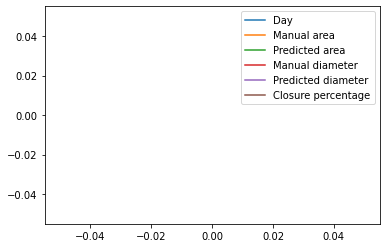

In [ ]:
mouse1_l.plot()
plt.savefig("Charts/plots.pdf")

In [ ]:
sides

['L', 'R']

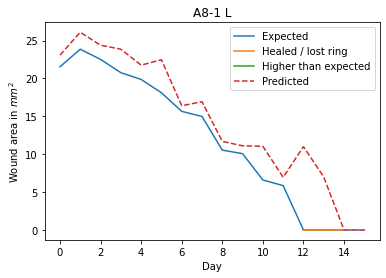

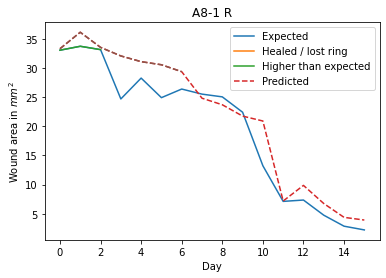

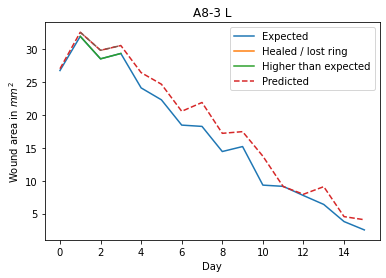

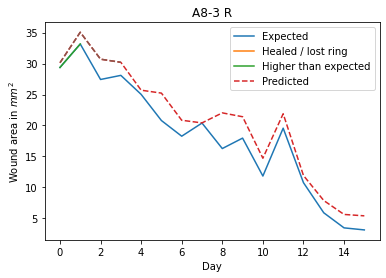

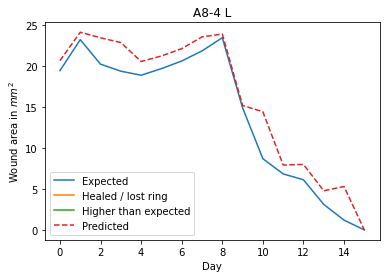

...

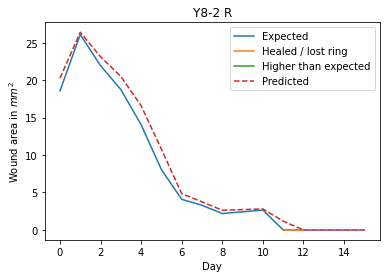

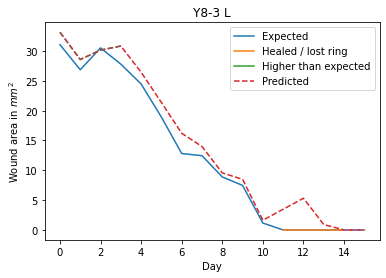

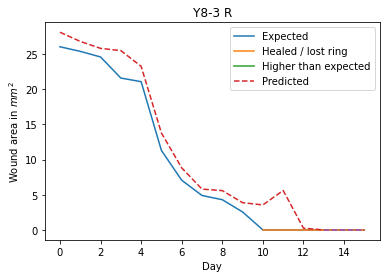

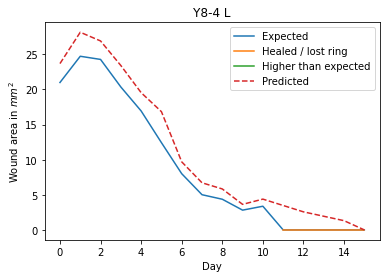

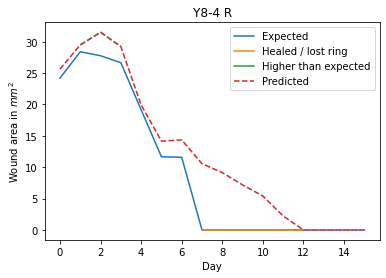

In [ ]:
for man_mouse, pred_mouse in zip(manual_mice, pred_mice):

    man_area_l = man_mouse.get_areas('L')
    man_area_r = man_mouse.get_areas('R')
    man_diameter_l = man_mouse.get_diameters('L')
    man_diameter_r = man_mouse.get_diameters('R')

    pred_area_l = pred_mouse.get_areas('L')
    pred_area_r = pred_mouse.get_areas('R')
    pred_diameter_l = pred_mouse.get_diameters('L')
    pred_diameter_r = pred_mouse.get_diameters('R')


    # Mark: plotting
    for side in sides:
        if side == 'R':
            y_pred = np.asarray(pred_area_r)
            y_man = np.asarray(man_area_r)
        elif side == 'L':
            y_pred = np.asarray(pred_area_l)
            y_man = np.asarray(man_area_l)

        x = man_mouse.get_days(side)
        th_low = 0.01
        th_high = 28.5

        upper_pred = np.ma.masked_where(y_pred < th_high, y_pred)
        lower_pred = np.ma.masked_where(y_pred > th_low, y_pred)

        upper_man = np.ma.masked_where(y_man < th_high, y_man)
        lower_man = np.ma.masked_where(y_man > th_low, y_man)

        fig, ax = plt.subplots()
        plt.title(man_mouse.id + ' ' + side)
        ax.plot(x, y_man)
        ax.plot(x, lower_man, x, upper_man)
        ax.plot(x, y_pred, linestyle='dashed')
        ax.plot(x, lower_pred, x, upper_pred, linestyle='dashed')
        plt.legend(('Expected', 'Healed / lost ring', 'Higher than expected', 'Predicted'))
        plt.xlabel('Day')
        plt.ylabel('Wound area in $mm^2$')
        plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + man_mouse.id + "-" + side + ".pdf")
        plt.show()


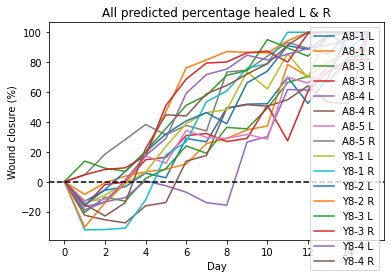

In [ ]:
sides = ['L', 'R']
mice = ['A8-1 L', 'A8-1 R', 'A8-3 L', 'A8-3 R', 'A8-4 L', 'A8-4 R', 'A8-5 L', 'A8-5 R', 'Y8-1 L', 'Y8-1 R', 'Y8-2 L', 'Y8-2 R', 'Y8-3 L', 'Y8-3 R', 'Y8-4 L', 'Y8-4 R']

fig, ax = plt.subplots()
title = "All predicted percentage healed" + ' ' + "L & R"
plt.title(title)
style = 'Line'


for mouse in pred_mice:
    #plot_charts(mouse, ['L', 'R'])

    for side in sides:

        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        init_size = y[0]
        percentages = []

        for area in y:
            percentage = (100 - ((area / init_size) * 100))
            percentages.append(percentage)

        negatives = list(filter(negative, percentages))
        positives = list(filter(positive, percentages))
        i = len(negatives) + 1

        if style == 'Bar':
            ax.bar(x[1:i], negatives, color='red')
            ax.bar(x[i:], positives)
        elif style == 'Line':
            ax.plot(x, percentages)
            #ax.plot(x[1:i], negatives, color='red')
            #ax.plot(x[i:], positives)
        else:
            print("please select Line or Bar as style")
            break

plt.legend(mice)
ax.axhline(y=0, color='black', linestyle='dashed')
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()


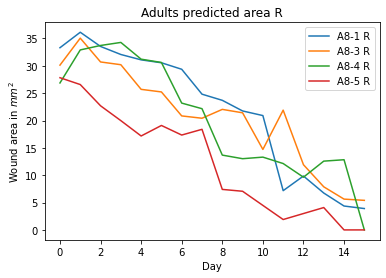

In [ ]:
side = 'R'
mice = ['A8-1 R', 'A8-3 R', 'A8-4 R', 'A8-5 R']

fig, ax = plt.subplots()
title = "Adults predicted area" + ' ' + side
plt.title(title)

for mouse in pred_mice:
    #plot_charts(mouse, ['L', 'R'])

    if mouse.id.startswith('A'):
        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        th_low = 0.01
        th_high = 28.5

        upper = np.ma.masked_where(y < th_high, y)
        lower = np.ma.masked_where(y > th_low, y)

        ax.plot(x, y)
        #ax.plot(x, lower, x, upper)

plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound area in $mm^2$')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

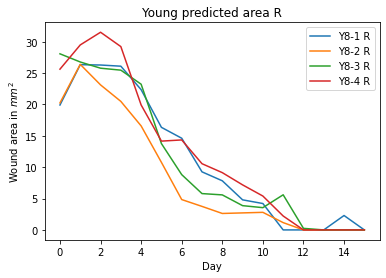

In [ ]:
side = 'R'
mice = ['Y8-1 R', 'Y8-2 R', 'Y8-3 R', 'Y8-4 R']

fig, ax = plt.subplots()
title = "Young predicted area" + ' ' + side
plt.title(title)

for mouse in pred_mice:
    #plot_charts(mouse, ['L', 'R'])

    if mouse.id.startswith('Y'):
        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        th_low = 0.01
        th_high = 28.5

        upper = np.ma.masked_where(y < th_high, y)
        lower = np.ma.masked_where(y > th_low, y)

        ax.plot(x, y)
        #ax.plot(x, lower, x, upper)

plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound area in $mm^2$')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

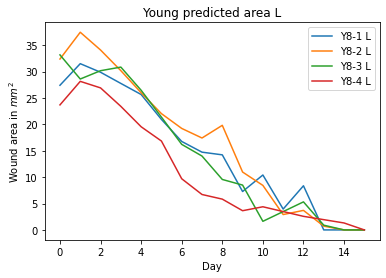

In [ ]:
side = 'L'
mice = ['Y8-1 L', 'Y8-2 L', 'Y8-3 L', 'Y8-4 L']

fig, ax = plt.subplots()
title = "Young predicted area" + ' ' + side
plt.title(title)

for mouse in pred_mice:
    #plot_charts(mouse, ['L', 'R'])

    if mouse.id.startswith('Y'):
        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        th_low = 0.01
        th_high = 28.5

        upper = np.ma.masked_where(y < th_high, y)
        lower = np.ma.masked_where(y > th_low, y)

        ax.plot(x, y)
        #ax.plot(x, lower, x, upper)

plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound area in $mm^2$')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

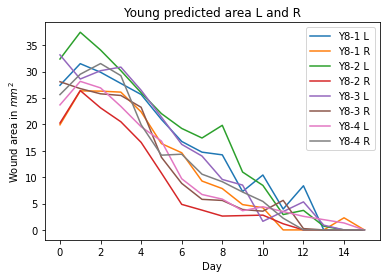

In [ ]:
sides = ['L', 'R']
mice = ['Y8-1 L', 'Y8-1 R', 'Y8-2 L', 'Y8-2 R', 'Y8-3 L', 'Y8-3 R', 'Y8-4 L', 'Y8-4 R']

fig, ax = plt.subplots()
title = "Young predicted area" + ' ' + 'L and R'
plt.title(title)

for mouse in pred_mice:
    #plot_charts(mouse, ['L', 'R'])

    if mouse.id.startswith('Y'):
        for side in sides:
            y = np.asarray(mouse.get_areas(side))
            x = np.asarray(mouse.get_days(side))

            th_low = 0.01
            th_high = 28.5

            upper = np.ma.masked_where(y < th_high, y)
            lower = np.ma.masked_where(y > th_low, y)

            ax.plot(x, y)
            #ax.plot(x, lower, x, upper)

plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound area in $mm^2$')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

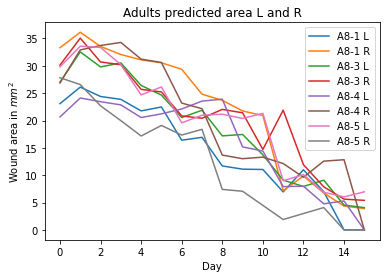

In [ ]:
sides = ['L', 'R']
mice = ['A8-1 L', 'A8-1 R', 'A8-3 L', 'A8-3 R', 'A8-4 L', 'A8-4 R', 'A8-5 L', 'A8-5 R']

fig, ax = plt.subplots()
title = "Adults predicted area" + ' ' + 'L and R'
plt.title(title)

for mouse in pred_mice:
    #plot_charts(mouse, ['L', 'R'])

    if mouse.id.startswith('A'):
        for side in sides:
            y = np.asarray(mouse.get_areas(side))
            x = np.asarray(mouse.get_days(side))

            th_low = 0.01
            th_high = 28.5

            upper = np.ma.masked_where(y < th_high, y)
            lower = np.ma.masked_where(y > th_low, y)

            ax.plot(x, y)
            #ax.plot(x, lower, x, upper)

plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound area in $mm^2$')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

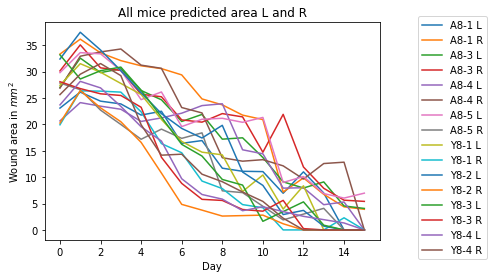

In [ ]:
sides = ['L', 'R']
mice = ['A8-1 L', 'A8-1 R', 'A8-3 L', 'A8-3 R', 'A8-4 L', 'A8-4 R', 'A8-5 L', 'A8-5 R', 'Y8-1 L', 'Y8-1 R', 'Y8-2 L', 'Y8-2 R', 'Y8-3 L', 'Y8-3 R', 'Y8-4 L', 'Y8-4 R']

fig, ax = plt.subplots()
title = "All mice predicted area" + ' ' + 'L and R'
plt.title(title)

for mouse in pred_mice:
    #plot_charts(mouse, ['L', 'R'])

    for side in sides:
        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        th_low = 0.01
        th_high = 28.5

        upper = np.ma.masked_where(y < th_high, y)
        lower = np.ma.masked_where(y > th_low, y)

        ax.plot(x, y)
        #ax.plot(x, lower, x, upper)
        #print(mouse.id + " " + side)

plt.legend(mice, bbox_to_anchor=(1.1, 1.05))
plt.xlabel('Day')
plt.ylabel('Wound area in $mm^2$')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

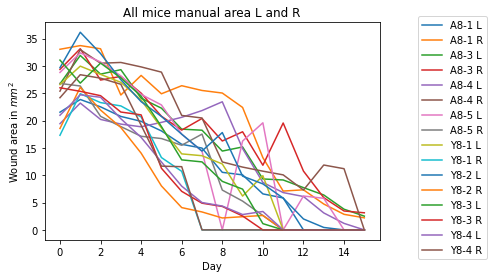

In [ ]:
sides = ['L', 'R']
mice = ['A8-1 L', 'A8-1 R', 'A8-3 L', 'A8-3 R', 'A8-4 L', 'A8-4 R', 'A8-5 L', 'A8-5 R', 'Y8-1 L', 'Y8-1 R', 'Y8-2 L', 'Y8-2 R', 'Y8-3 L', 'Y8-3 R', 'Y8-4 L', 'Y8-4 R']

fig, ax = plt.subplots()
title = "All mice manual area" + ' ' + 'L and R'
plt.title(title)

for mouse in manual_mice:
    #plot_charts(mouse, ['L', 'R'])

    for side in sides:
        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        th_low = 0.01
        th_high = 28.5

        upper = np.ma.masked_where(y < th_high, y)
        lower = np.ma.masked_where(y > th_low, y)

        ax.plot(x, y)
        #ax.plot(x, lower, x, upper)
        #print(mouse.id + " " + side)

plt.legend(mice, bbox_to_anchor=(1.1, 1.05))
plt.xlabel('Day')
plt.ylabel('Wound area in $mm^2$')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

A8-1 L
A8-3 L
A8-4 L
A8-5 L
Y8-1 L
Y8-2 L
Y8-3 L
Y8-4 L


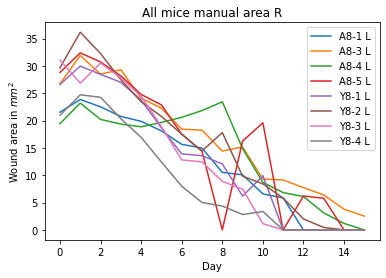

In [ ]:
sides = ['L']
mice = ['A8-1 L', 'A8-3 L', 'A8-4 L', 'A8-5 L', 'Y8-1 L', 'Y8-2 L', 'Y8-3 L', 'Y8-4 L']

fig, ax = plt.subplots()
title = "All mice manual area" + ' ' + side
plt.title(title)

for mouse in manual_mice:
    #plot_charts(mouse, ['L', 'R'])

    for side in sides:
        y = np.asarray(mouse.get_areas(side))
        x = np.asarray(mouse.get_days(side))

        th_low = 0.01
        th_high = 28.5

        upper = np.ma.masked_where(y < th_high, y)
        lower = np.ma.masked_where(y > th_low, y)

        ax.plot(x, y)
        #ax.plot(x, lower, x, upper)
        print(mouse.id + " " + side)

plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound area in $mm^2$')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

A8-1 L
A8-3 L
A8-4 L
A8-5 L
Y8-1 L
Y8-2 L
Y8-3 L
Y8-4 L


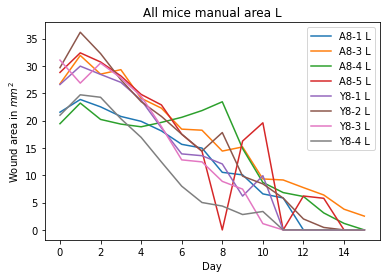

In [ ]:
side = 'L'
mice = ['A8-1 L', 'A8-3 L', 'A8-4 L', 'A8-5 L', 'Y8-1 L', 'Y8-2 L', 'Y8-3 L', 'Y8-4 L']

fig, ax = plt.subplots()
title = "All mice manual area" + ' ' + side
plt.title(title)

for mouse in manual_mice:
    #plot_charts(mouse, ['L', 'R'])

    y = np.asarray(mouse.get_areas(side))
    x = np.asarray(mouse.get_days(side))

    th_low = 0.01
    th_high = 28.5

    upper = np.ma.masked_where(y < th_high, y)
    lower = np.ma.masked_where(y > th_low, y)

    ax.plot(x, y)
    #ax.plot(x, lower, x, upper)
    print(mouse.id + " " + side)

plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound area in $mm^2$')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

In [ ]:
%cd 

'/content/drive/.shortcut-targets-by-id/175Vkdh2mGaZ7CZsZetvNssl0puand1tS/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation'

Graphs for manual perc closed

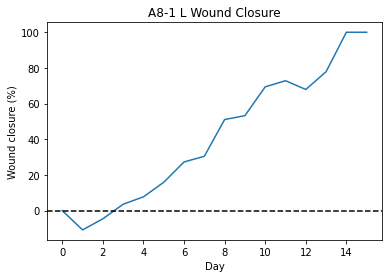

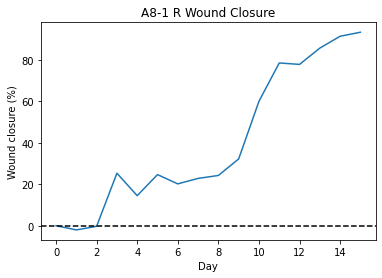

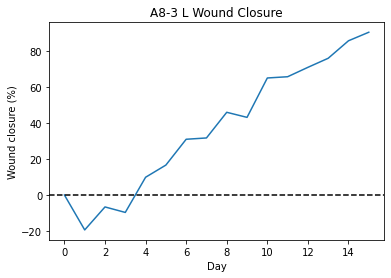

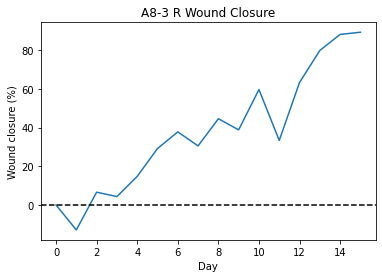

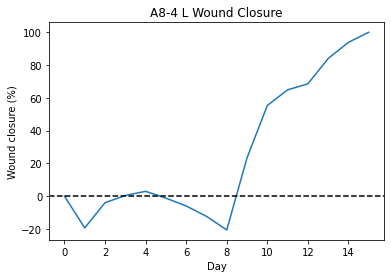

...

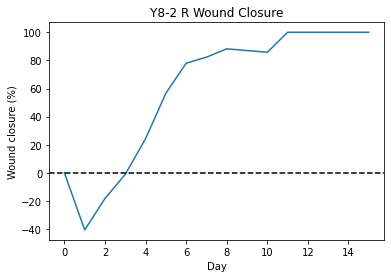

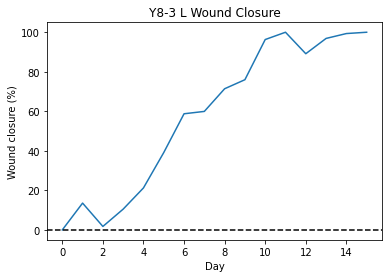

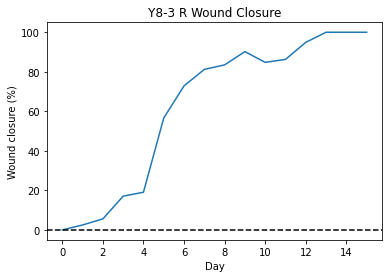

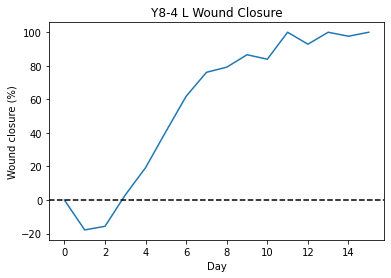

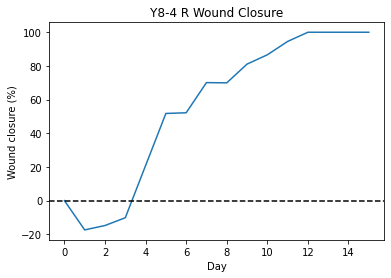

In [ ]:
for mouse in manual_mice:
    mouse_percentage = plot_percentages(mouse, ['L', 'R'], style='Line', save=False, su=False)
    mouse.left_percentages = mouse_percentage[0]
    mouse.right_percentages = mouse_percentage[1]

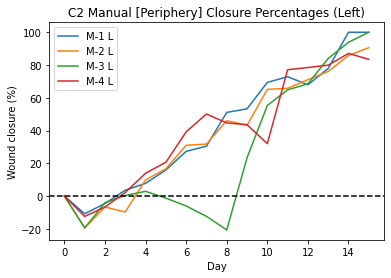

In [ ]:
side = 'L'
mice = ['M-1 L', 'M-2 L', 'M-3 L', 'M-4 L']

fig, ax = plt.subplots()
title = "C2 Manual [Periphery] Closure Percentages (Left)"
plt.title(title)

for mouse_pred, mouse_man in zip(pred_mice, manual_mice):

    if mouse_pred.id == mouse_man.id and mouse_pred.id.startswith("A"):
        #pred_l = mouse_pred.left_percentages
        man_l = mouse_man.left_percentages
        x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
        
        ax.plot(x, man_l)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

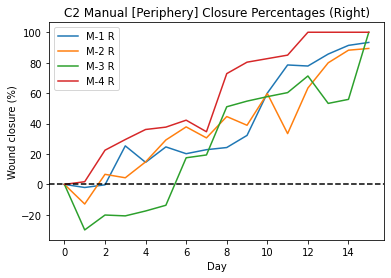

In [ ]:
side = 'R'
mice = ['M-1 R', 'M-2 R', 'M-3 R', 'M-4 R']

fig, ax = plt.subplots()
title = "C2 Manual [Periphery] Closure Percentages (Right)"
plt.title(title)

for mouse_pred, mouse_man in zip(pred_mice, manual_mice):

    if mouse_pred.id == mouse_man.id and mouse_pred.id.startswith("A"):
        #pred_l = mouse_pred.left_percentages
        man_r = mouse_man.right_percentages
        #x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
        x = np.asanyarray(mouse_man.get_days(side))
        
        ax.plot(x, man_r)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

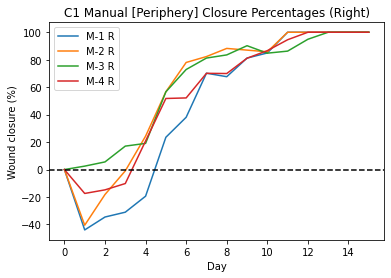

In [ ]:
side = 'R'
mice = ['M-1 R', 'M-2 R', 'M-3 R', 'M-4 R']

fig, ax = plt.subplots()
title = "C1 Manual [Periphery] Closure Percentages (Right)"
plt.title(title)

for mouse_pred, mouse_man in zip(pred_mice, manual_mice):

    if mouse_pred.id == mouse_man.id and mouse_pred.id.startswith("Y"):
        #pred_l = mouse_pred.left_percentages
        man_r = mouse_man.right_percentages
        #x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
        x = np.asanyarray(mouse_man.get_days(side))
        
        ax.plot(x, man_r)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

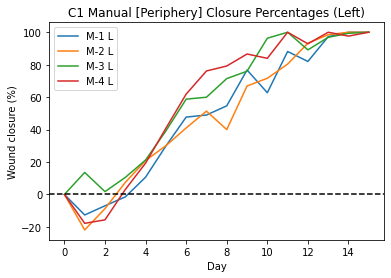

In [ ]:
side = 'L'
mice = ['M-1 L', 'M-2 L', 'M-3 L', 'M-4 L']

fig, ax = plt.subplots()
title = "C1 Manual [Periphery] Closure Percentages (Left)"
plt.title(title)

for mouse_pred, mouse_man in zip(pred_mice, manual_mice):

    if mouse_pred.id == mouse_man.id and mouse_pred.id.startswith("Y"):
        #pred_l = mouse_pred.left_percentages
        man_l = mouse_man.left_percentages
        #x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
        x = np.asanyarray(mouse_man.get_days(side))
        
        ax.plot(x, man_l)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

Average for man and est

In [ ]:
manual_mice[0].right_percentages

[0.0,
 -2.039087553700014,
 -0.2934591879954098,
 25.310098626490003,
 14.479336842742185,
 24.63847038179948,
 20.166999455436567,
 22.805106794941622,
 24.227022448115207,
 32.195800810794466,
 59.99878985901858,
 78.49276940763599,
 77.796938343317,
 85.65680401766807,
 91.37169480244448,
 93.30792037272343]

In [ ]:
adult_avg_man = []
young_avg_man = []
for mouse in manual_mice:

    if mouse.id[0] == 'A':
        right = mouse.right_percentages
        left = mouse.left_percentages

        temp = []

        for day in range(16):   
            try: 
                sum = (right[day] + left[day]) / 2
                temp.append(sum)
            except:
                print("no reading for day", day, mouse.id)

        adult_avg_man.append(temp)

    elif mouse.id[0] == 'Y':

        right = mouse.right_percentages
        left = mouse.left_percentages

        temp = []

        for day in range(16):   
            try: 
                sum = (right[day] + left[day]) / 2
                temp.append(sum)
            except:
                print("no reading for day", day, mouse.id)

        young_avg_man.append(temp)

no reading for day 15 A8-5
no reading for day 15 Y8-2


In [ ]:
a_avg_man = []
for i in range(16):
    temp = 0
    count = 0
    for j in range(4):
        try:
            temp += adult_avg_man[j][i]
            count += 1
        except:
            print("no reading")
    a_avg_man.append(temp / count)

no reading


In [ ]:
y_avg_man = []
for i in range(16):
    temp = 0
    count = 0
    for j in range(4):
        try:
            temp += young_avg_man[j][i]
            count += 1
        except:
            print("no reading")
    y_avg_man.append(temp / count)

no reading


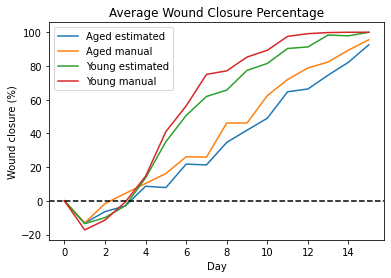

In [ ]:
fig, ax = plt.subplots()
title = "Average Wound Closure Percentage"
plt.title(title)
x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
ax.plot(x, a_avg)
ax.plot(x, a_avg_man)
ax.plot(x, y_avg)
ax.plot(x, y_avg_man)
ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(('Aged estimated', 'Aged manual', 'Young estimated', 'Young manual'))
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + " (ALL).pdf")
plt.show()

In [ ]:
%pwd

'/content/drive/.shortcut-targets-by-id/175Vkdh2mGaZ7CZsZetvNssl0puand1tS/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation'

Hsinya plots

In [ ]:
Y8_1_L = [0, -15.2, -17.6, -3.9, -1.7, 18.6, 89.4, 95.6, 91.3, 96, 97.6, 97, 98.6, 98.8, 98.6, 99.3]
test = [100, 115.1657747, 117.6231777, 103.8691025, 101.6731254, 82.45371225, 10.62926739,
        5.474564803, 8.710094113, 4.025958049, 3.481577167, 3.004859445, 1.470135941,
        1.257919665, 1.439379959, 0.7012363905]

In [ ]:
for i in range(len(test)):
    test[i] = test[i] - 100
    test[i] *= -1

In [ ]:
Y8_2_L = [100, 119.5587472, 105.9416214, 98.35349371, 19.59697458, 29.05005051, 24.56925975,
          17.15588565, 8.724025885, 7.880293804, 4.136744669, 1.329765448, 1.829451438,
          0.3331239931, 1.155011878, 0.5433743822]
for i in range(len(Y8_2_L)):
    Y8_2_L[i] = Y8_2_L[i] - 100
    Y8_2_L[i] *= -1

In [ ]:
Y8_3_L = [100, 98.29301631, 114.8892209, 112.2540449, 92.71432658, 48.45672145, 37.43284911,
          9.173845322, 5.149559744, 2.053466417, 0.5689945644, 0.2352268031, 0.190724435,
          0, 0, 0]

for i in range(len(Y8_3_L)):
    Y8_3_L[i] = Y8_3_L[i] - 100
    Y8_3_L[i] *= -1
print(i)

15


In [ ]:
Y8_4_L = [100, 110.5968793, 112.0852901, 87.52840479, 46.41342221, 31.99515225, 8.286623239,
          1.795182548, 0.5188607787, 0.3560066657, 0.249962127, 0, 0, 0, 0, 0]

for i in range(len(Y8_4_L)):
    Y8_4_L[i] = Y8_4_L[i] - 100
    Y8_4_L[i] *= -1
print(i)

15


In [ ]:
Y8_1_R = [100, 138.9455557, 129.7743631, 136.2343798, 95.98622334, 73.73162008, 47.01726498,
          20.47511812, 6.009625999, 8.729633064, 10.25742924, 0, 0, 0, 0, 0]

for i in range(len(Y8_1_R)):
    Y8_1_R[i] = Y8_1_R[i] - 100
    Y8_1_R[i] *= -1
print(i)

15


In [ ]:
Y8_2_R = [100, 138.4641013, 115.350658, 91.56671664, 121.4684325, 9.191237714, 0.6246876562,
          0.7371314343, 0.4789272031, 0.23946360155, 0, 0, 0.2498750625, 0, 0, 0]

for i in range(len(Y8_2_R)):
    Y8_2_R[i] = Y8_2_R[i] - 100
    Y8_2_R[i] *= -1
print(i)

15


In [ ]:
Y8_3_R = [100, 104.0053193, 100.547763, 88.0916949, 78.61507773, 47.29126429, 26.00766235,
          3.140930247, 1.611626508, 0.7504036982, 0.2944622107, 0.05066016528, 0, 0, 0, 0]

for i in range(len(Y8_3_R)):
    Y8_3_R[i] = Y8_3_R[i] - 100
    Y8_3_R[i] *= -1
print(i)

15


In [ ]:
Y8_4_R = [100, 118.2732293, 113.910287, 95.67796032, 32.06421706, 10.2733656, 15.77817165,
          3.940282228, 4.304996932, 0.8555457086, 0.6578498875, 0.9987047515, 1.455450269,
          0.5555934283, 0, 0]

for i in range(len(Y8_4_R)):
    Y8_4_R[i] = Y8_4_R[i] - 100
    Y8_4_R[i] *= -1
print(i)

15


In [ ]:
A8_1_L = [100, 107.5497064, 110.0933984, 106.3503856, 92.65194934, 82.96186231, 75.15389514,
          61.84461898, 47.56244251, 34.35930093, 33.75079601, 15.14894219, 14.78100899,
          14.8022359, 4.17462676, 1.036581051]
          
for i in range(len(A8_1_L)):
    A8_1_L[i] = A8_1_L[i] - 100
    A8_1_L[i] *= -1
print(i)

15


In [ ]:
A8_3_L = [100, 115.2045224, 117.4817343, 92.21641512, 87.72865447, 78.86512719, 64.92987041,
          55.40504506, 49.67201749, 48.59740814, 36.62737987, 23.94005653, 14.1219135,
          5.879686417, 0.2959842142, 0.165324516]

for i in range(len(A8_3_L)):
    A8_3_L[i] = A8_3_L[i] - 100
    A8_3_L[i] *= -1
print(i)

15


In [ ]:
A8_4_L = [100, 119.6029968, 111.7324477, 104.0511315, 101.5949641, 108.3996293, 104.9046111,
          114.953271, 126.0214722, 75.08689272, 53.68038928, 25.1332355, 25.26840195,
          13.68270642, 6.569089364, 2.973661852]
for i in range(len(A8_4_L)):
    A8_4_L[i] = A8_4_L[i] - 100
    A8_4_L[i] *= -1
print(i)

15


In [ ]:
A8_5_L = [100, 105.4680441, 100.2466603, 90.67086722, 82.50909713, 70.07350966, 62.26585586,
          43.18753511, 40.52799961, 18.95621169, 16.72894229, 12.54304345, 10.23518206,
          6.190929738, 7.905341051, 1.826751655]
for i in range(len(A8_5_L)):
    A8_5_L[i] = A8_5_L[i] - 100
    A8_5_L[i] *= -1
print(i)

15


In [ ]:
A8_1_R = [100, 103.8322125, 107.4092622, 92.29026566, 86.81499499, 41.34353985, 39.17107836,
          61.2367053, 53.22172938, 43.8498593, 42.51681213, 6.906090523, 10.2279773,
          4.733629036, 6.808317833, 5.81151333]

for i in range(len(A8_1_R)):
    A8_1_R[i] = A8_1_R[i] - 100
    A8_1_R[i] *= -1
print(i)

15


In [ ]:
A8_3_R = [100, 103.5628136, 96.30934002, 90.24749132, 84.1277499, 74.58510228, 64.07998842,
          60.79457738, 56.29100733, 59.26042069, 34.67049402, 61.11539946, 4.841277499,
          14.27055191, 2.58587418, 3.627942879]

for i in range(len(A8_3_R)):
    A8_3_R[i] = A8_3_R[i] - 100
    A8_3_R[i] *= -1
print(i)

15


In [ ]:
A8_4_R = [100, 133.2298331, 133.5779701, 129.729645, 112.1847949, 80.7081922, 75.10036382,
          62.59879563, 45.68749216, 9.092334713, 5.50432819, 6.965876302, 3.123823861,
          15.97352904, 8.715970393, 0]

for i in range(len(A8_4_R)):
    A8_4_R[i] = A8_4_R[i] - 100
    A8_4_R[i] *= -1
print(i)

15


In [ ]:
A8_5_R = [100, 85.77586207, 71.38137518, 58.44001652, 57.27596531, 62.38127194, 44.87146397,
          38.41368986, 6.610055751, 5.719595292, 5.595705141, 0.3690894074, 0, 0, 0, 0]

for i in range(len(A8_5_R)):
    A8_5_R[i] = A8_5_R[i] - 100
    A8_5_R[i] *= -1
print(i)

15


In [ ]:
all_young = [Y8_1_L, Y8_1_R, Y8_2_L, Y8_2_R, Y8_3_L, Y8_3_R, Y8_4_L, Y8_4_R]

In [ ]:
all_aged = [A8_1_L, A8_1_R, A8_3_L, A8_3_R, A8_4_L, A8_4_R, A8_5_L, A8_5_R]

In [ ]:
young_avg = []
for i in range(16):
    total = 0
    for mouse in all_young:
        total += mouse[i]
    average = total / 8
    young_avg.append(average)

In [ ]:
aged_avg = []
for i in range(16):
    total = 0
    for mouse in all_aged:
        total += mouse[i]
    average = total / 8
    aged_avg.append(average)

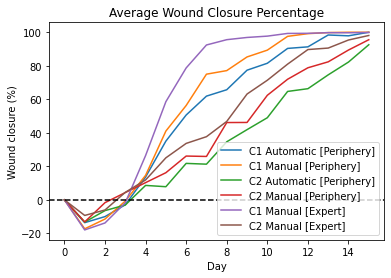

In [ ]:
fig, ax = plt.subplots()
title = "Average Wound Closure Percentage"
plt.title(title)
x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
ax.plot(x, y_avg)
ax.plot(x, y_avg_man)
ax.plot(x, a_avg)
ax.plot(x, a_avg_man)
ax.plot(x, young_avg)
ax.plot(x, aged_avg)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(('C1 Automatic [Periphery]', 'C1 Manual [Periphery]', 'C2 Automatic [Periphery]', 'C2 Manual [Periphery]', 'C1 Manual [Expert]', 'C2 Manual [Expert]'))
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + " (ALL).pdf")
plt.show()

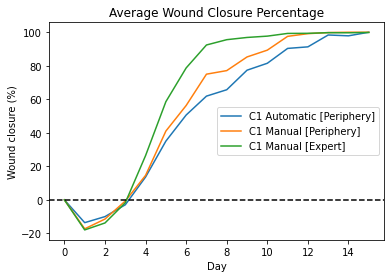

In [ ]:
fig, ax = plt.subplots()
title = "Average Wound Closure Percentage"
plt.title(title)
x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
ax.plot(x, y_avg)
ax.plot(x, y_avg_man)
ax.plot(x, young_avg)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(('C1 Automatic [Periphery]', 'C1 Manual [Periphery]', 'C1 Manual [Expert]'))
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + " (YOUNG).pdf")
plt.show()

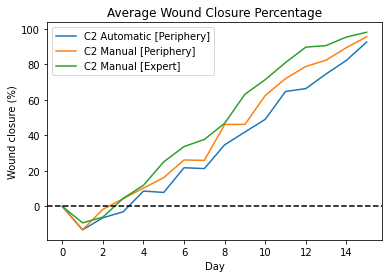

In [ ]:
fig, ax = plt.subplots()
title = "Average Wound Closure Percentage"
plt.title(title)
x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
ax.plot(x, a_avg)
ax.plot(x, a_avg_man)
ax.plot(x, aged_avg)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(('C2 Automatic [Periphery]', 'C2 Manual [Periphery]', 'C2 Manual [Expert]'))
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + " (AGED).pdf")
plt.show()

In [ ]:
output = open("Average Closure (Manual).csv","w+")

# Column names:
output.write(("Day" + "," + "Adult Closure % (Manual)" + "," + "Young Closure % (Manual)") + "\n")

i = 0
for a, y in zip(a_avg_man, y_avg_man):
    output.write((str(i) + "," + str(round(a, 3)) + "," + str(round(y, 3))) + "\n")
    i += 1

output.close()

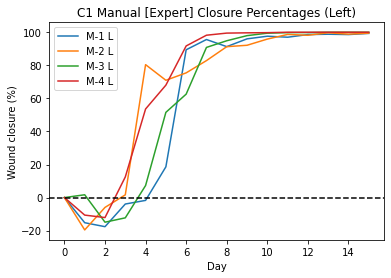

In [ ]:
mice = ['M-1 L', 'M-2 L', 'M-3 L', 'M-4 L']

fig, ax = plt.subplots()
title = "C1 Manual [Expert] Closure Percentages (Left)"
plt.title(title)
x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
ax.plot(x, Y8_1_L)
ax.plot(x, Y8_2_L)
ax.plot(x, Y8_3_L)
ax.plot(x, Y8_4_L)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

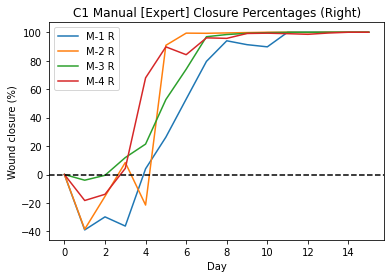

In [ ]:
mice = ['M-1 R', 'M-2 R', 'M-3 R', 'M-4 R']

fig, ax = plt.subplots()
title = "C1 Manual [Expert] Closure Percentages (Right)"
plt.title(title)
x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
ax.plot(x, Y8_1_R)
ax.plot(x, Y8_2_R)
ax.plot(x, Y8_3_R)
ax.plot(x, Y8_4_R)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

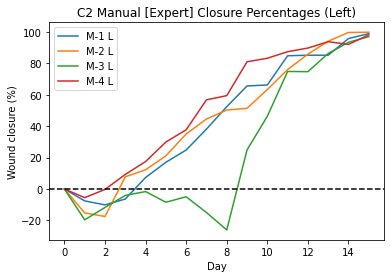

In [ ]:
mice = ['M-1 L', 'M-2 L', 'M-3 L', 'M-4 L']

fig, ax = plt.subplots()
title = "C2 Manual [Expert] Closure Percentages (Left)"
plt.title(title)
x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
ax.plot(x, A8_1_L)
ax.plot(x, A8_3_L)
ax.plot(x, A8_4_L)
ax.plot(x, A8_5_L)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()

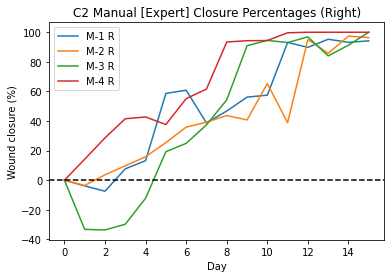

In [ ]:
mice = ['M-1 R', 'M-2 R', 'M-3 R', 'M-4 R']

fig, ax = plt.subplots()
title = "C2 Manual [Expert] Closure Percentages (Right)"
plt.title(title)
x = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
ax.plot(x, A8_1_R)
ax.plot(x, A8_3_R)
ax.plot(x, A8_4_R)
ax.plot(x, A8_5_R)

ax.axhline(y=0, color='black', linestyle='dashed')
plt.legend(mice)
plt.xlabel('Day')
plt.ylabel('Wound closure (%)')
plt.savefig("/content/drive/My Drive/Hector_MJ_Google_Drive/Hector_MJ/Mouse wounds/Wound Segmentation/Charts/" + title + ".pdf")
plt.show()